## Trabajo 2: Clustering
### Máster Interuniversitario en Big Data: Tecnologías de Análisis de Datos Masivos
### Minería de datos - Curso 2023/2024

El alumno deberá resolver las cuestiones que se plantean. Una vez resueltas, deberá entregar el Jupyter Notebook con los comentarios en formato Markdown con el código incrustado y la salida en formato HTML, en la que quede reflejado el proceso de resolución seguido. Además de la corrección de las soluciones propuestas, se valorará la presentación de la memoria y la justificación a las decisiones tomadas. 

Los archivos que entregar se comprimirán en un fichero .ZIP con nombre ApellidosNombre.zip. El nombre de los alumnos que componen el grupo debe aparecer claramente identificados al principio de la memoria. 

### Conjunto de datos

En este trabajo se usarán 6 conjuntos de datos para analizar la capacidad de distintos algoritmos de agrupamiento: 

**Integrantes del grupo:**

- Alicia Jiajun Lorenzo Lourido
- Monya Tayebi Hillali

In [1]:
# pip install scikit-learn-extra

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
from collections import Counter
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
from sklearn_extra.cluster import KMedoids
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN

%matplotlib inline

In [3]:
path_data="./data/"

data1 = pd.read_csv(path_data+"data1.csv")
data2 = pd.read_csv(path_data+"data2.csv")
data3 = pd.read_csv(path_data+"data3.csv")
data4 = pd.read_csv(path_data+"data4.csv")
data5 = pd.read_csv(path_data+"data5.csv")
data6 = pd.read_csv(path_data+"data6.csv")

datos= [pd.read_csv(path_data+f"data{i}.csv") for i in range(1,7)]
datos={
    0:data1,
    1:data2,
    2:data3,
    3:data4,
    4:data5,
    5:data6
}

Se puede observar que los datos están agrupados en distintas formas geométricas:

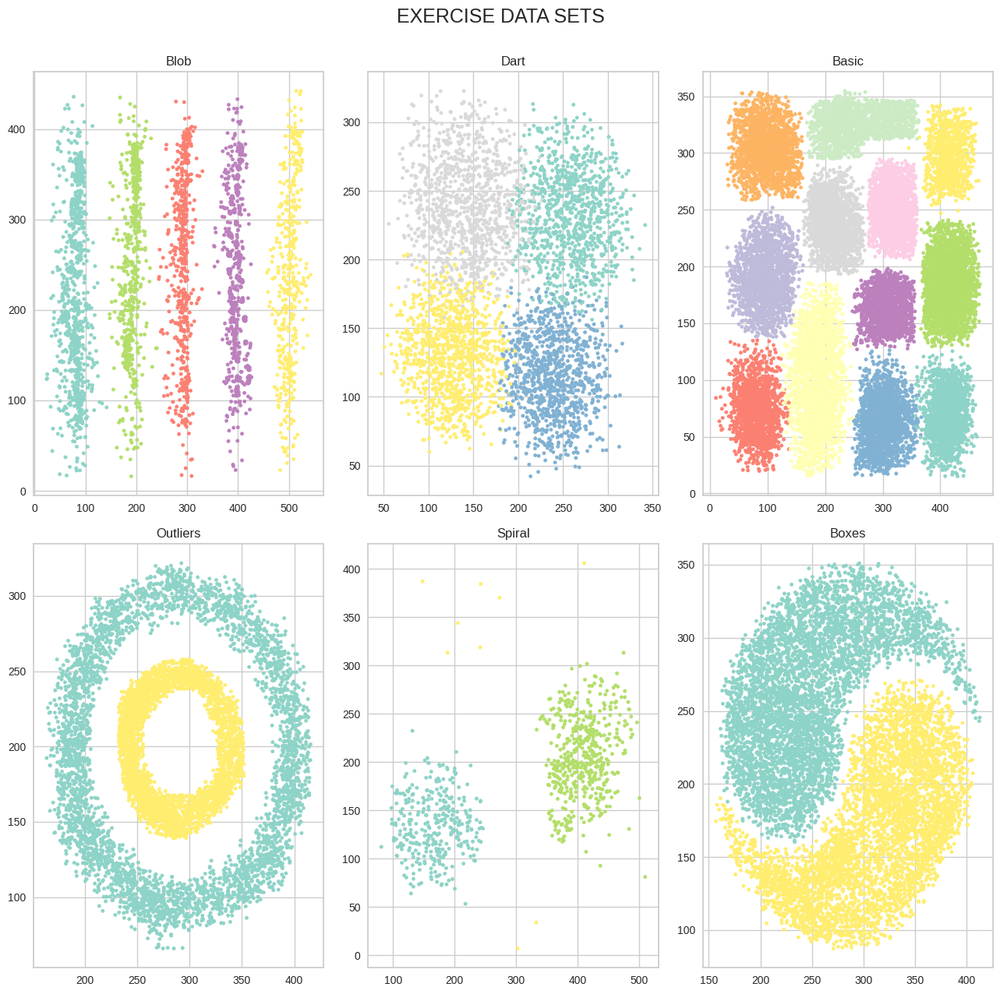

In [4]:
fig, axes = plt.subplots(nrows=2, ncols=3,figsize=(13,13))
fig.suptitle('EXERCISE DATA SETS\n', size = 18)

axes[0,0].scatter(data1['x'], data1['y'], c=data1['color'], s=10, cmap = "Set3")
axes[0,0].set_title("Blob");

axes[0,1].scatter(data2['x'], data2['y'], c=data2['color'], s=10, cmap = "Set3")
axes[0,1].set_title("Dart");

axes[0,2].scatter(data3['x'], data3['y'], c=data3['color'], s=10, cmap = "Set3")
axes[0,2].set_title("Basic");

axes[1,0].scatter(data4['x'], data4['y'], c=data4['color'], s=10, cmap = "Set3")
axes[1,0].set_title("Outliers");

axes[1,1].scatter(data5['x'], data5['y'], c=data5['color'], s=10, cmap = "Set3")
axes[1,1].set_title("Spiral");

axes[1,2].scatter(data6['x'], data6['y'], c=data6['color'], s=10, cmap = "Set3")
axes[1,2].set_title("Boxes");

plt.tight_layout()


### Ejercicio 1

Agrupa cada uno de los conjuntos de datos anteriores utilizando el k-medias (usa la implementación de scikit-learn). Optimiza la k utilizando el métodos del codo y el método Silhouette. 

Compara los resultados gráficamente respecto a los valores obtenidos por el conjunto de datos inicial. 

**Comentario:** Comenzamos definiendo un método para aplicar KMeans sobre el conjunto y agrupar en los k grupos que se obtengan por el método del codo o el método de Silhouette:

In [5]:
from scipy.signal import argrelextrema

def k_mean(data,metric='distortion',name='',max_iter=100):
    """
    Ags:
        metric, default: "distortion"
        Select the scoring metric to evaluate the clusters. The default is the mean distortion, defined by the sum of squared distances between each observation and its closest centroid. Other metrics include:
            distortion: mean sum of squared distances to centers
            silhouette: mean ratio of intra-cluster and nearest-cluster distance
            calinski_harabasz: ratio of within to between cluster dispersion
    """
    print(name)
    model = KMeans(max_iter=max_iter, init='random', n_init='auto', random_state=0)
    visualizer = KElbowVisualizer(model, k=(2,20), metric=metric)
    visualizer.fit(data)
    visualizer.show()
    if metric=="silhouette":
        argrelextrema(np.array(visualizer.k_scores_), np.greater)
        return visualizer.elbow_value_
    else:
        return visualizer.elbow_value_

In [6]:
#j=2
#k_for_data['silhouette']=k_mean(datos[j],metric='silhouette',name=f"data_{j}_silhouette")

**Comentario:** A continuación, para cada uno de los conjuntos de datos agrupamos usando KMeans y visualizamos las gráficas tanto para el método del codo como de Silhouette:

data_1_codo


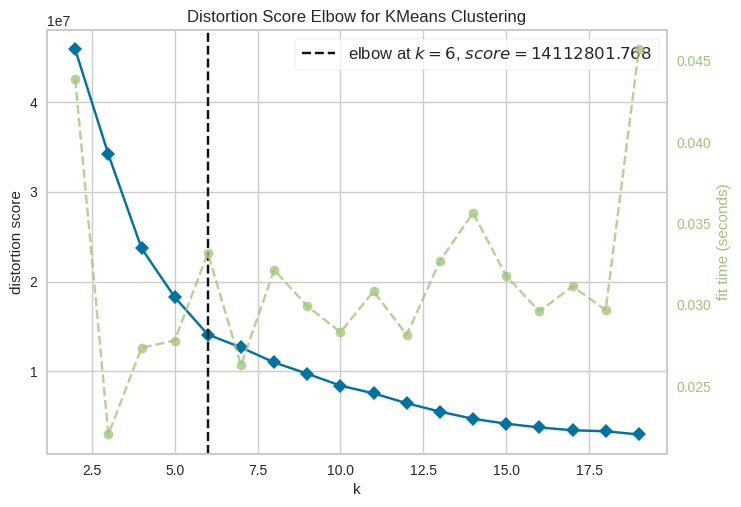

data_1_silhouette


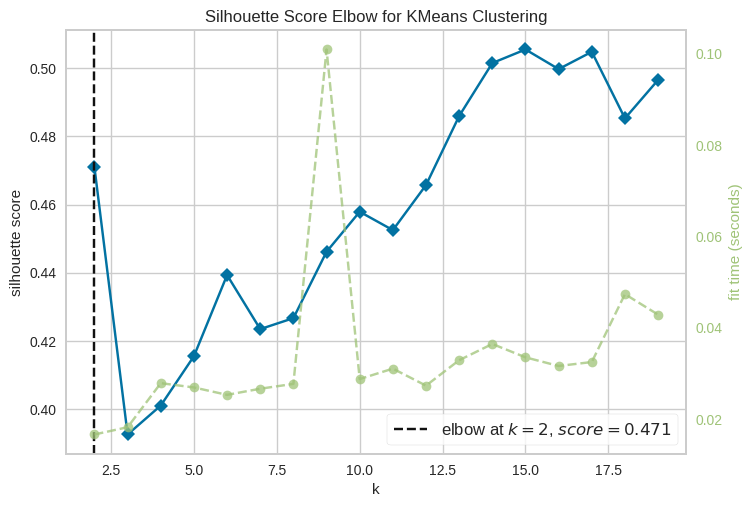

data_2_codo


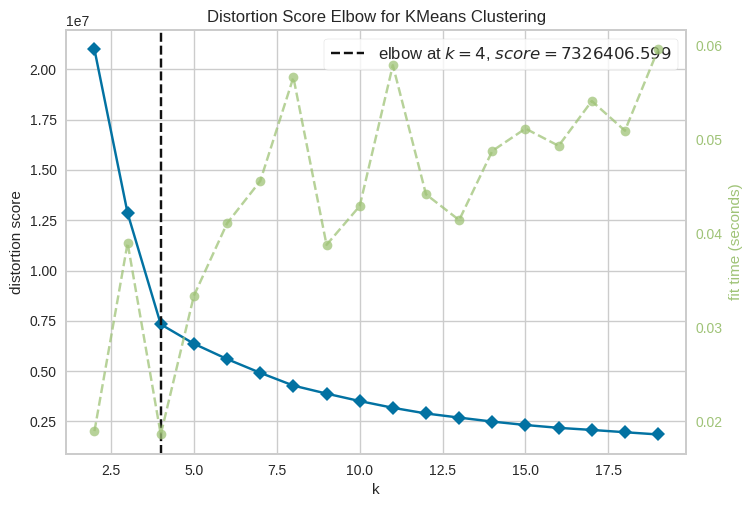

data_2_silhouette


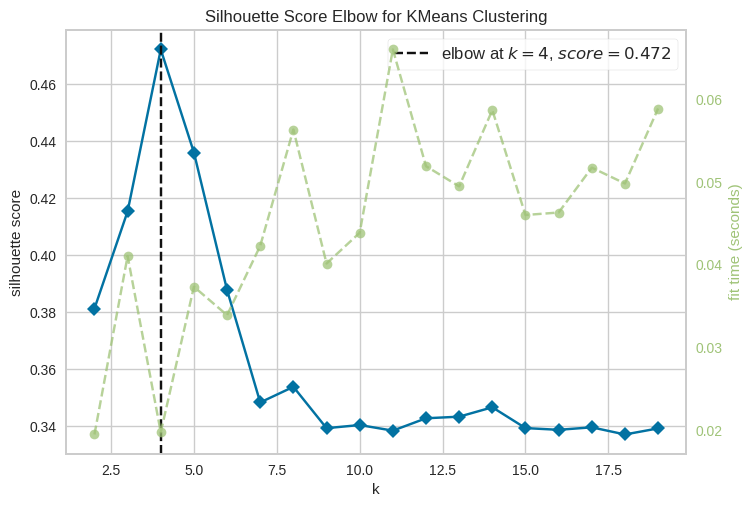

data_3_codo


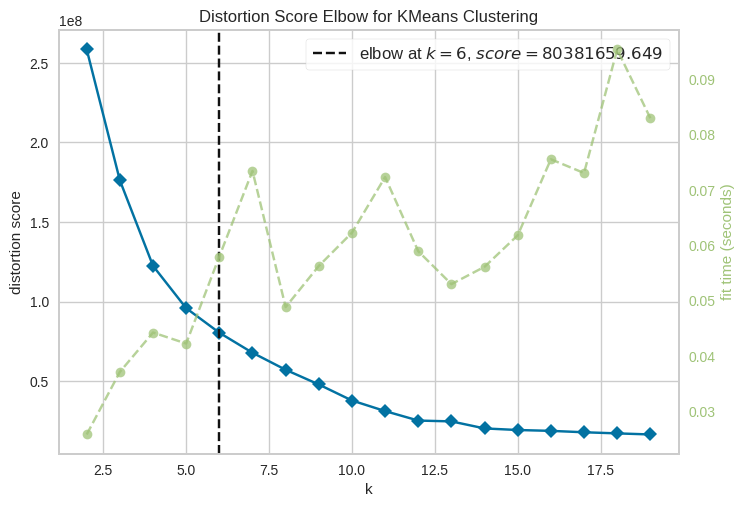

data_3_silhouette


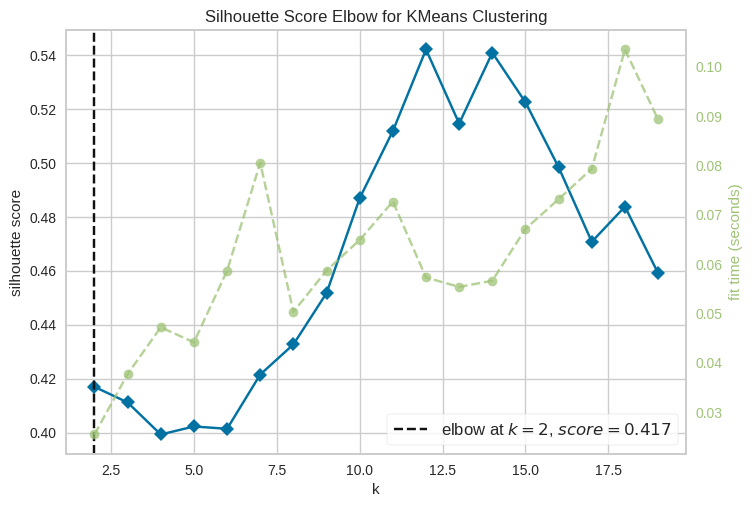

data_4_codo


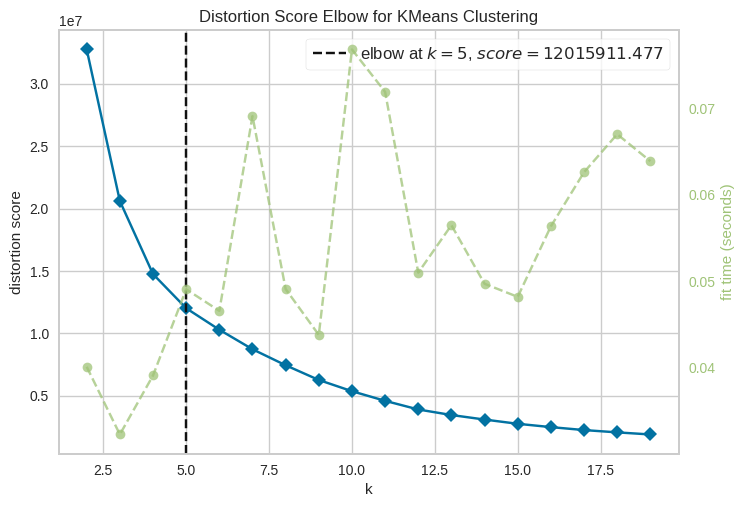

data_4_silhouette


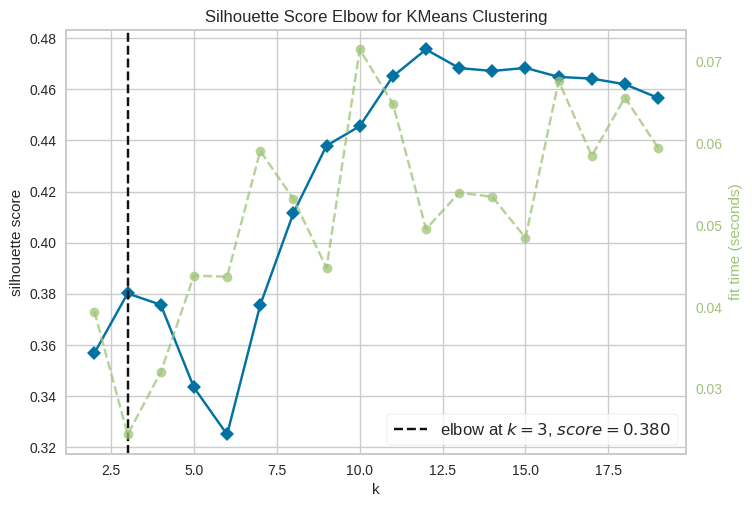

data_5_codo


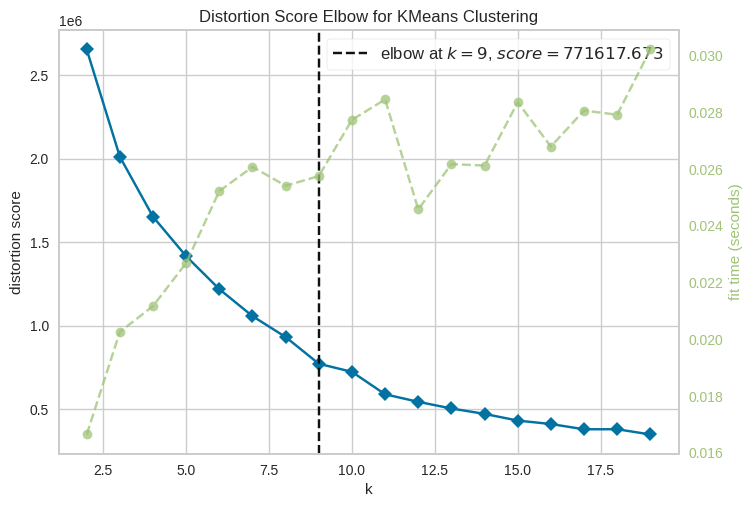

data_5_silhouette


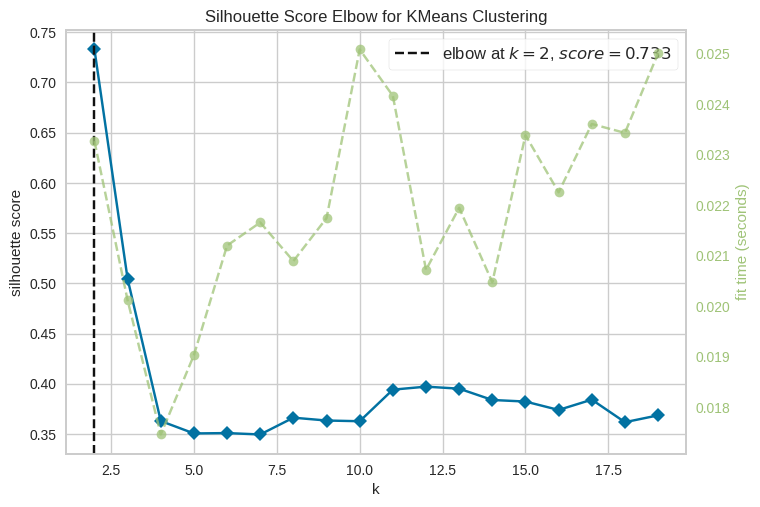

data_6_codo


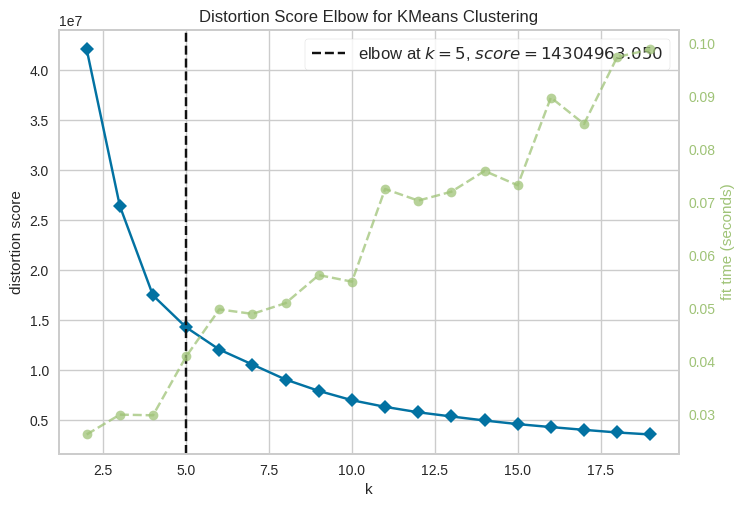

data_6_silhouette


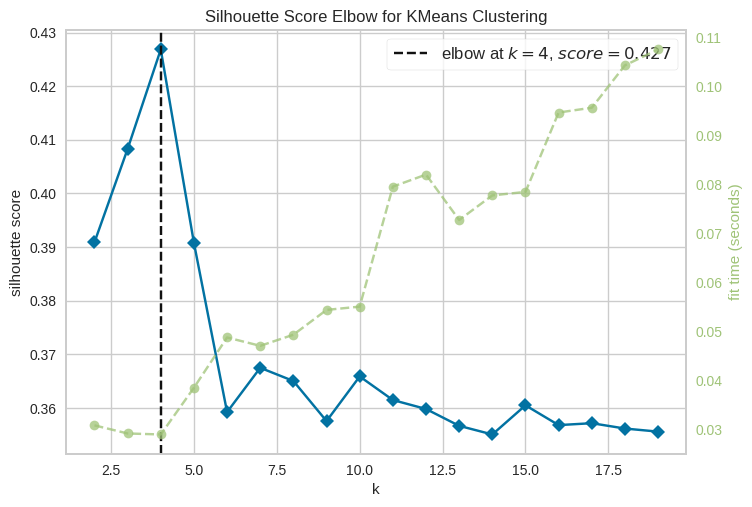

In [7]:
data_with_k={}
for i,data in datos.items():
    k_for_data={}
    k_for_data['codo']=k_mean(data,metric='distortion',name=f"data_{i+1}_codo")
    k_for_data['silhouette']=k_mean(data,metric='silhouette',name=f"data_{i+1}_silhouette")
    data_with_k[i]=k_for_data
    

In [8]:
def plot_k_means(data, index_data, k=2):
    model = KMeans(n_clusters=k, max_iter=100, init='random', n_init='auto', random_state=100).fit(data)
    
    data['Labels'] = model.labels_
    data['Labels'].value_counts()
    fig, axes = plt.subplots(1, 1, figsize=(5, 5))
    sns.scatterplot(x='x', y='y', data=data, hue='Labels', palette=sns.color_palette('hls', k))
    axes.set_title('Data ' + str(index_data+1) + ' k=' + str(k))

def plot_all_strategy(data, i, method={}):
    for key, k in method.items():
        plot_k_means(data, i, k=k)

**Comentario:** A continuación,  veamos como agrupa KMeans los datos de los datasets dado el valor de k real:

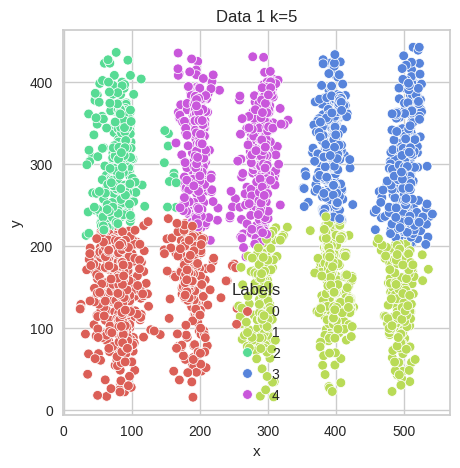

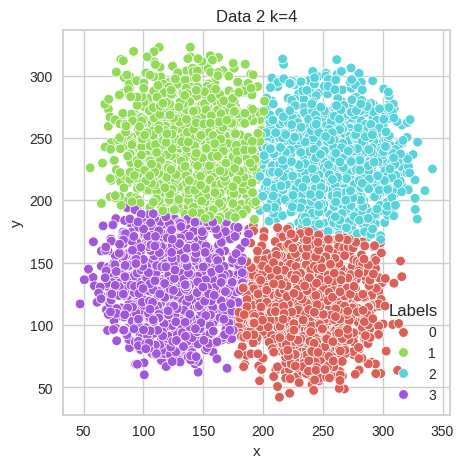

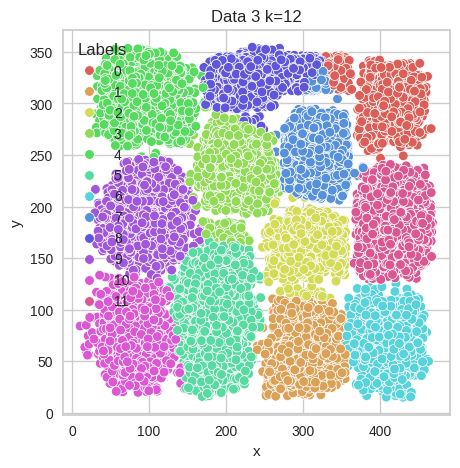

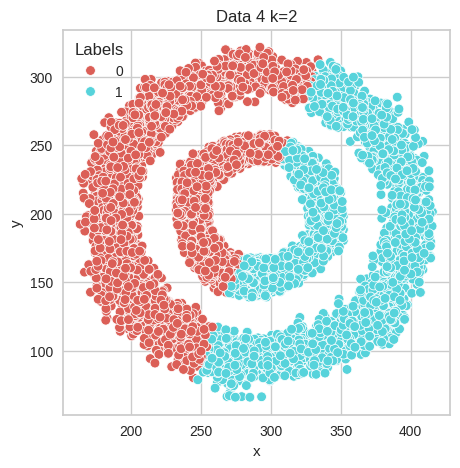

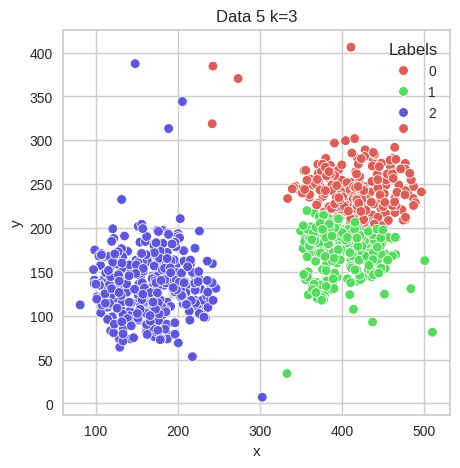

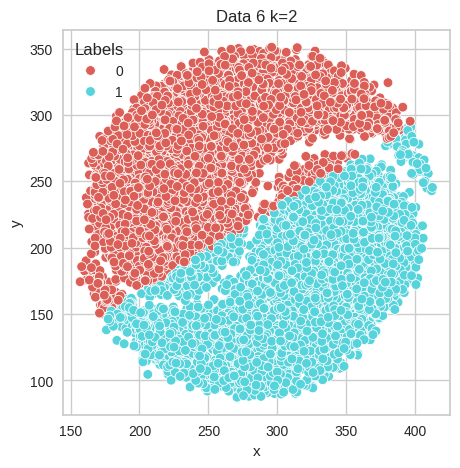

In [9]:
value_k=[5, 4, 12, 2, 3, 2]
for i, data in datos.items():
    plot_k_means(data.copy(), i, k=value_k[i])

**Comentario:** Ahora veamos los valores de k correspondientes a KElbowVisualizer para cada estrategia:

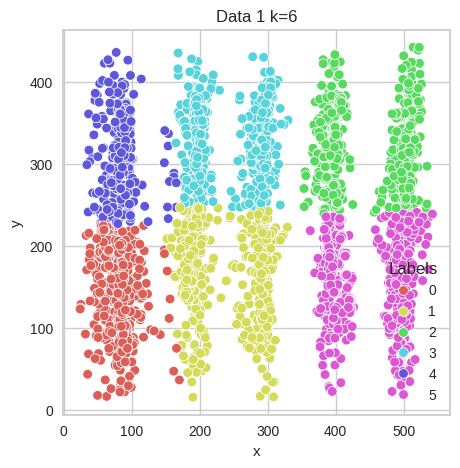

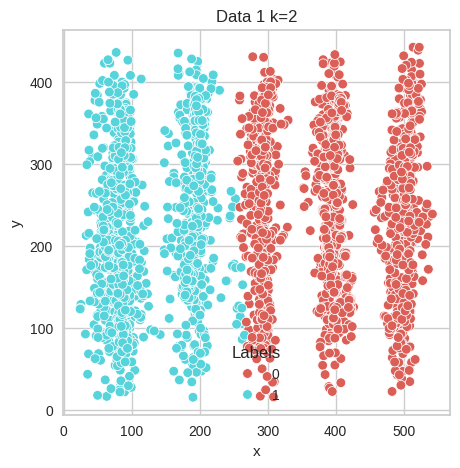

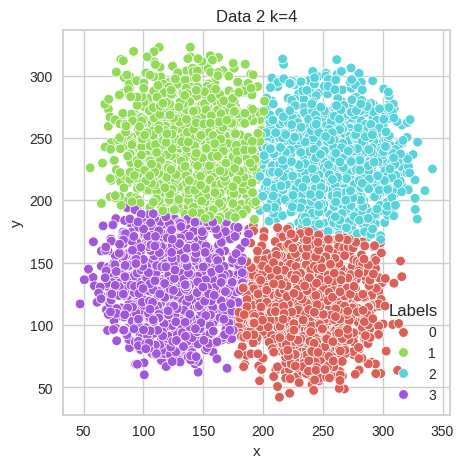

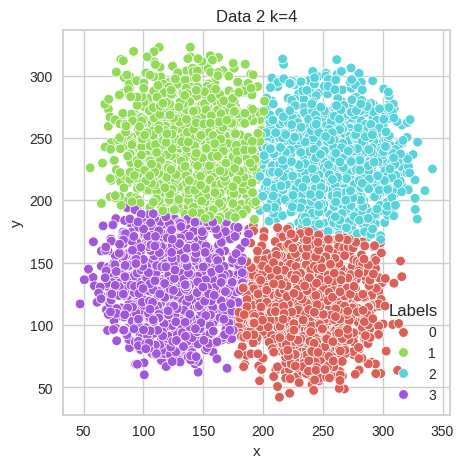

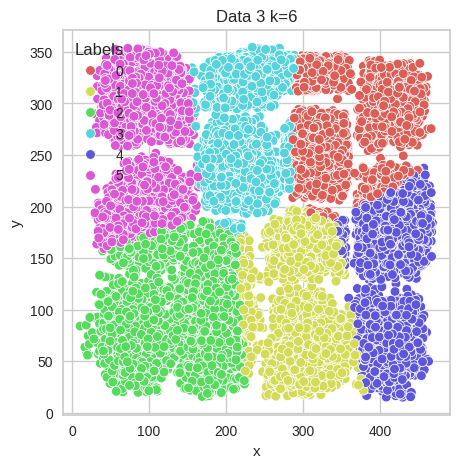

...

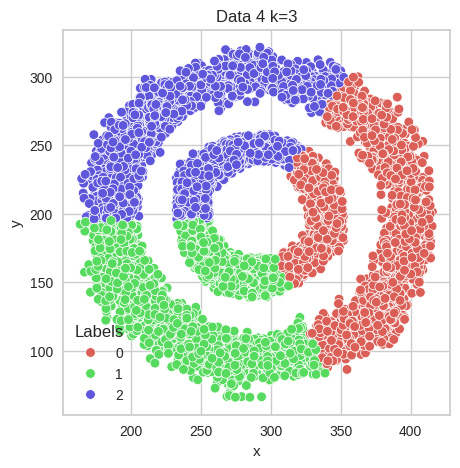

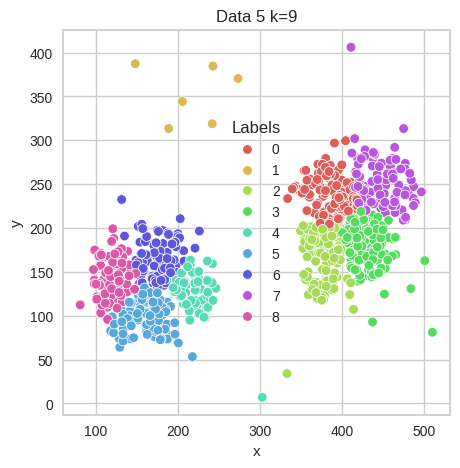

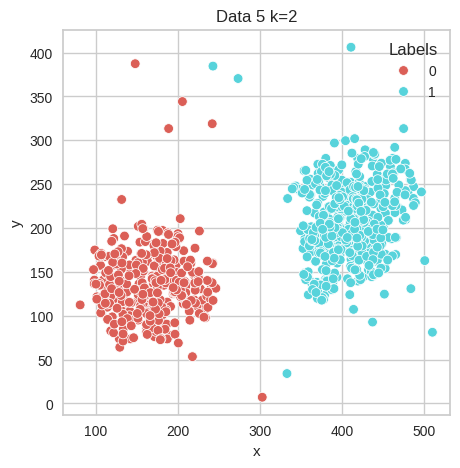

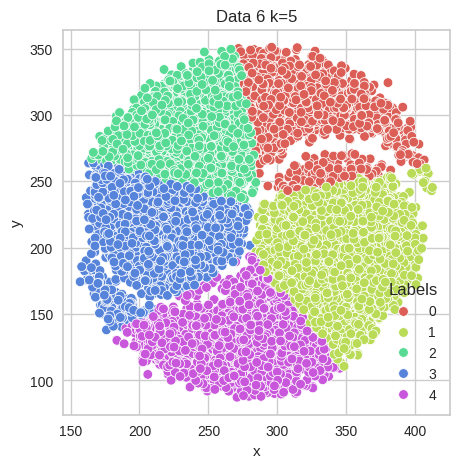

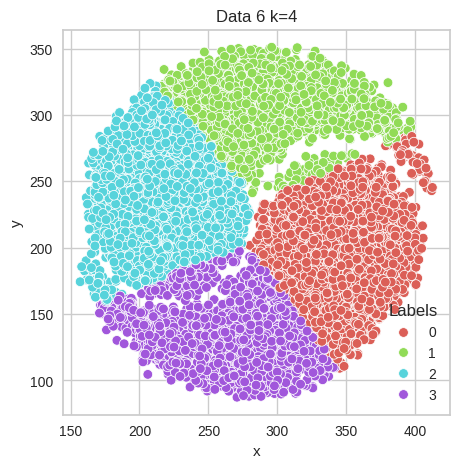

In [10]:
for i, data in datos.items():
    plot_all_strategy(data.copy(), i, method=data_with_k[i])

**Comentario:** Como en algunos casos el método de silhouette nos marcaba valores de k que no maximizaban el coeficiente de silhouette, veamos algunos casos en los que valores de k con dicho coeficiente más alto nos acercan más a la realidad de los grupos. 

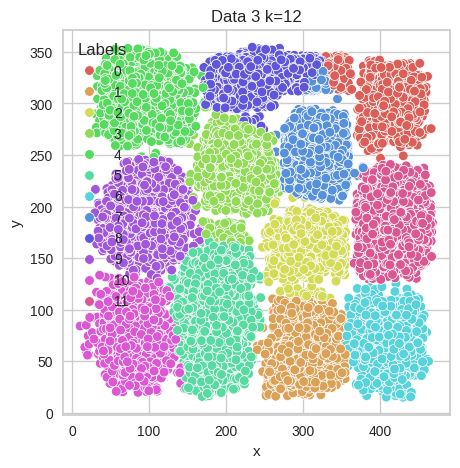

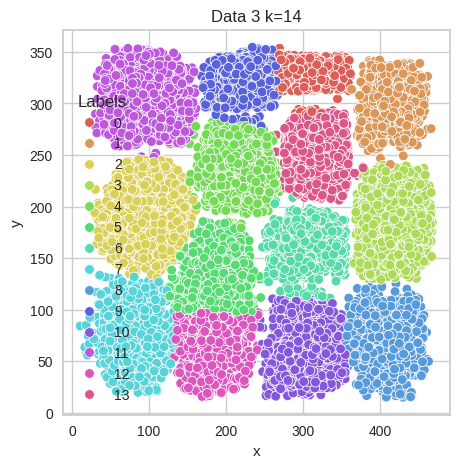

In [11]:
k_p=[[],[],[12,14],[],[],[]]

for i,data in datos.items():
    for k in k_p[i]:
        plot_k_means(data.copy(), i, k=k)

A continuación, comentaremos los resultados para cada dataset:
- **Dataset 1:** El método del codo nos marca el valor óptimo de k en k = 6 y el método de silhouette en k = 2 cuando el grupo de colores existente en la realidad es 5, es decir, 5 grupos. Ahora vemamos los siguientes casos:
    * Si agrupamos con KMeans con k=5, que es el número real de grupos, vemos que la aparienza de los grupos difiere mucho de la figura original, por lo que incluso con el número correcto de grupos KMeans no ha funcionado correctamente ya que los grupos no parecen muy coherentes. 
    * Si usamos ahora k=6 (método del codo), tampoco obtenemos grupos similares al original pero podemos notar un poco más de cercanía y coherencia en los grupos. 
    * Si usamos el resutado del método de Silhouette y k ahora vale 2, podemos ver que la forma de los grupos se asemeja más a los reales pero el problema en este caso es que sería un modelo bastante generalizado (faltan 3 grupos). 
- **Dataset 2:** El segundo dataset tiene un total de 4 grupos, y tanto el método del codo como el método de silhouette obtienen que idealmente k=4. Si observamos los grupos originales y los generados con KMeans vemos que son idénticos. 
- **Dataset 3:** Este dataset tiene 12 grupos. Con KMeans el método del codo nos da que k=6 y con el método de silhouette k=2. 
    * Si vemos la agrupación en 12 grupos de KMeans vemos como hay dos grupos que difieren ligeramente con los originales. 
    * Con el resultado del método del codo, k=6, los grupos parecen correctos aunque se diferencian fácilmente  subgrupos. 
    * Para k=2 que nos proporciona el método de silhouette, vemos que los dos grupos están claramente separados. Si nos fijamos en la gráfica de los coeficientes de silhouette para este dataset, vemos que hay dos valores  de k que maximizan dicho coeficiente que además se encuentran más cercanos al número real de grupos que son k=12 y k=14. Para k=12 mantenemos lo anteriormente comentado y para k=14 vemos como KMeadias ha hecho un mejor trabajo y ha identificado grupos más separables. 
- **Dataset 4:** Este cuarto conjunto de datos tiene 2 grupos, el método del codo ha obtenido un valor óptimo de k=5 y el método de silhouette k=3.
    * Para k=2, el número de grupos real, vemos que los grupos no se asemejan en absoluto a la realidad con KMeans aunque sí podemos considerarla una agrupación aceptable ya que los dos grupos son claramente separables. 
    * Para k=5 y k=3 pasa algo muy similar al caso anterior.
    * Este es uno de los ejemplos en los que KMeans no funciona correctamente ya que el dataset tiene una forma más compleja que los anteriores, por lo tanto, para ninguno de los valores anteriores de k KMeans ha hecho un buen agrupamiento. 
- **Dataset 5:** este conjunto de datos está formado por 3 grupos, uno de ellos mucho más pequeño que el resto. Con el método del codo se ha obtenido que k=9 y con el método de silhouette k=2. 
    * El agrupamiento por KMeans con k=3 ha dado un resultado totalmente difernte al real. Quizá se pueda deber a la inicialización aleatoria de los centroides. 
    * Con k=2, los grupos se asemejan mucho más a la realidad que con k=3.
    * Este es un claro ejemplo donde KMeans no funciona correctamente ya que los grupos son de diferente tamaño y densidad, concretamente dos de los grupos son densos y con más datos que el tercero que cuenta con muy pocos datos además de ser 'extremadamente' disperso. 
- **Dataset 6:** el dataset cuenta con 2 grupos pero con el método del codo se ha obtenido un valor de k=5 y con silhouette k=4.
    * Para dos grupos k=5 y k=4, obtenemos un resultado similar al dataset 4.
    * Este clúster también tiene una forma compleja además de ser no convexos, por lo que KMeans no fue capaz de hacer un buen agrupamiento para este dataset. 

### Ejercicio 2

Agrupa cada uno de los conjuntos de datos anteriores utilizando el k-medoides (usa la implementación de scikit-learn). 

Compara los resultados gráficamente respecto a los valores obtenidos por el conjunto de datos inicial. ¿En qué se diferencias los resultados de los obtenidos por el k-medias?

In [12]:
def k_medoids(data,metric='distortion',name='',max_iter=100):
    """
    Ags:
        metric, default: "distortion"
        Select the scoring metric to evaluate the clusters. The default is the mean distortion, defined by the sum of squared distances between each observation and its closest centroid. Other metrics include:
            distortion: mean sum of squared distances to centers
            silhouette: mean ratio of intra-cluster and nearest-cluster distance
            calinski_harabasz: ratio of within to between cluster dispersion
    """
    print(name)
    model = KMedoids(max_iter=max_iter, init='random', random_state=0)
    visualizer = KElbowVisualizer(model, k=(2,20), metric=metric)
    visualizer.fit(data)
    visualizer.show()
    if metric=="silhouette":
        argrelextrema(np.array(visualizer.k_scores_), np.greater)
        return visualizer.elbow_value_
    else:
        return visualizer.elbow_value_

data_1_codo


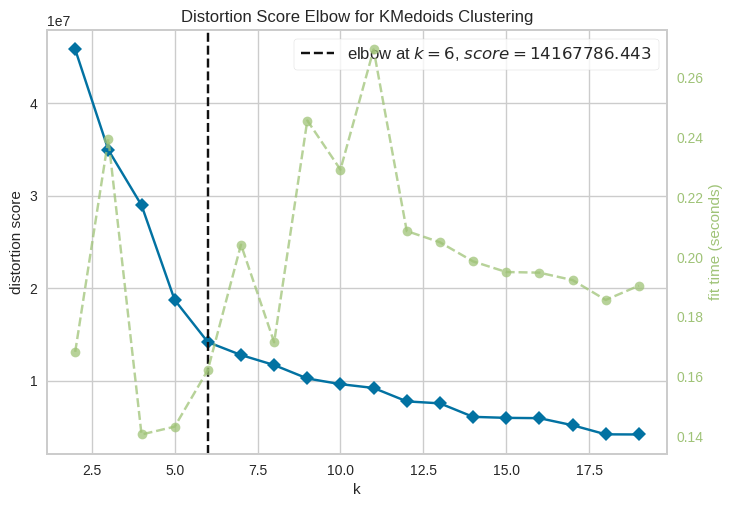

data_1_silhouette


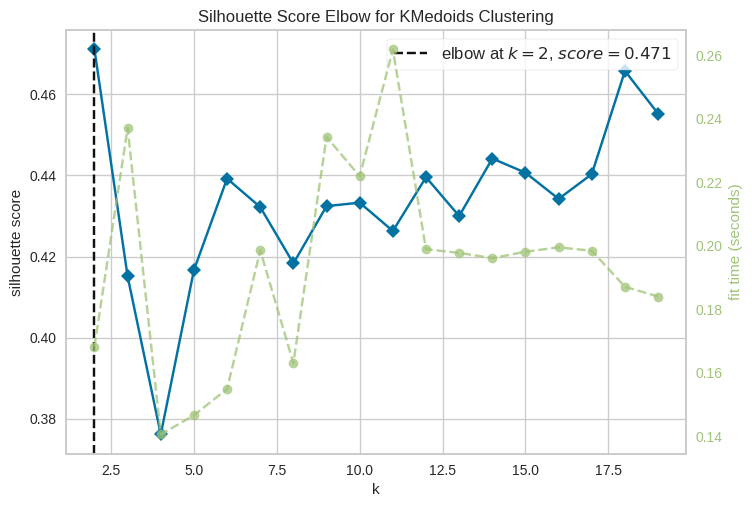

data_2_codo


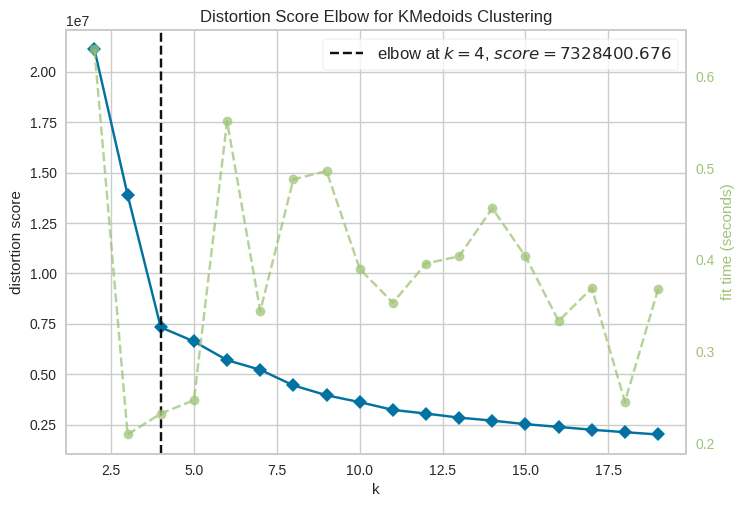

data_2_silhouette


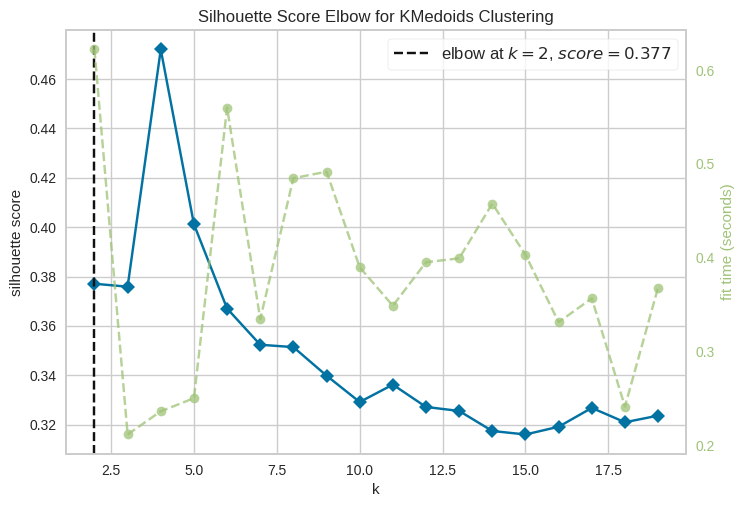

data_3_codo


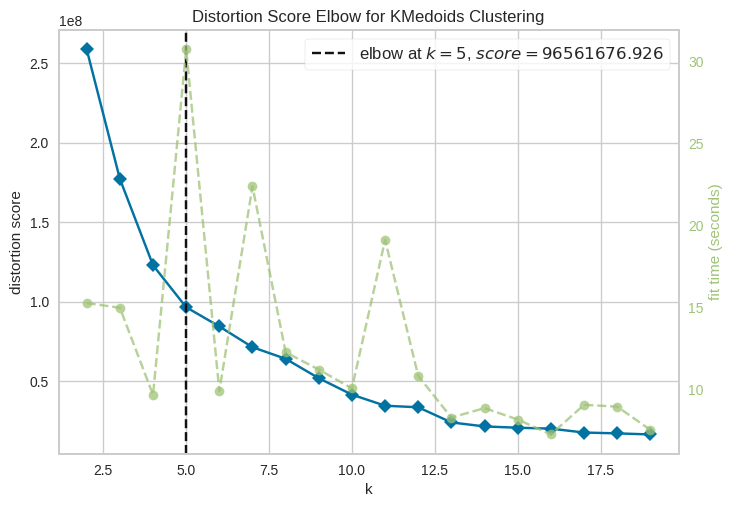

data_3_silhouette


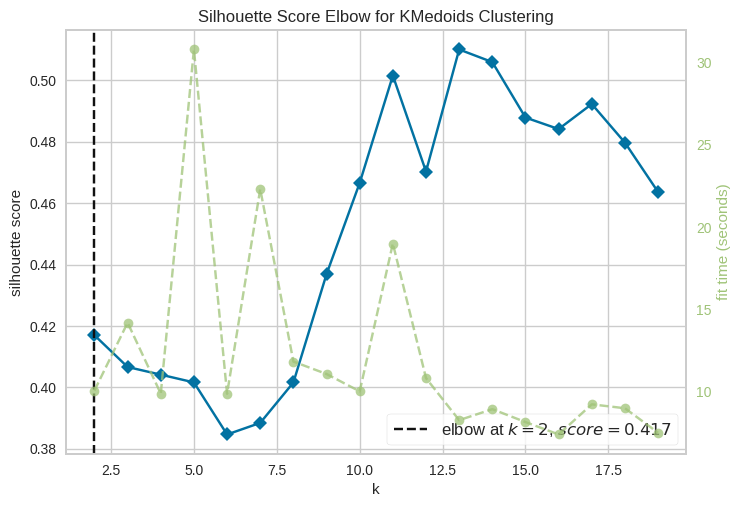

data_4_codo


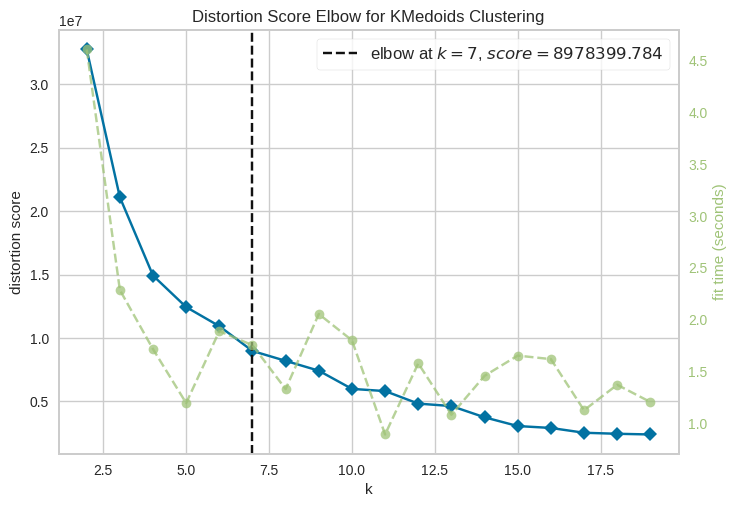

data_4_silhouette


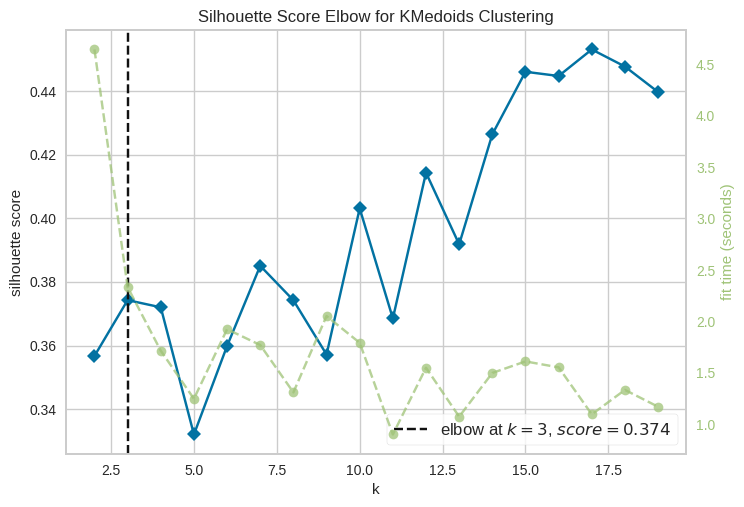

data_5_codo


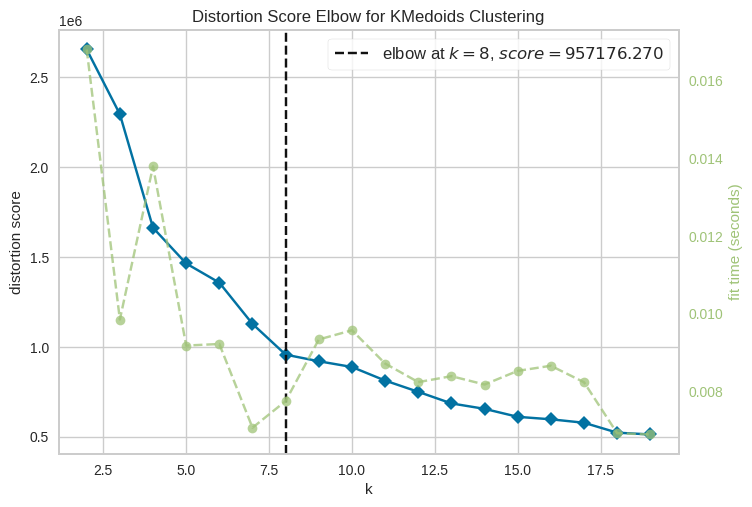

data_5_silhouette


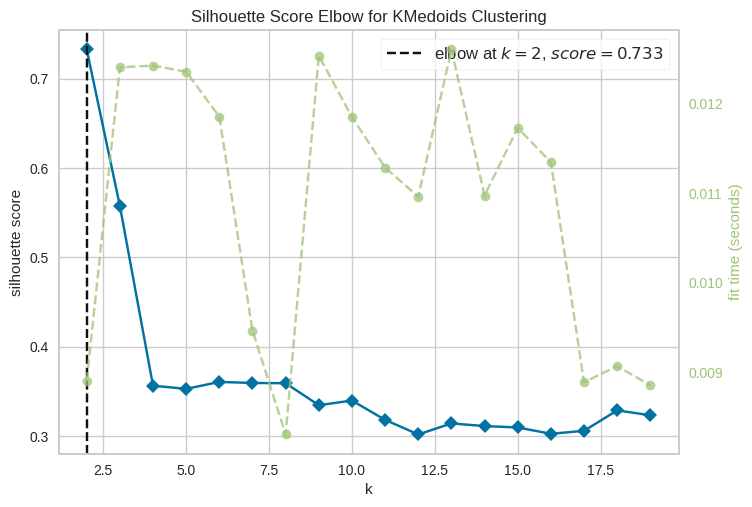

data_6_codo


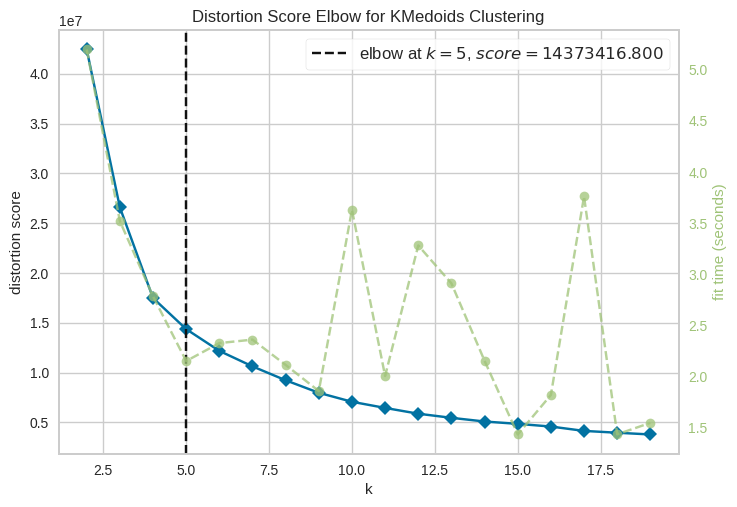

data_6_silhouette


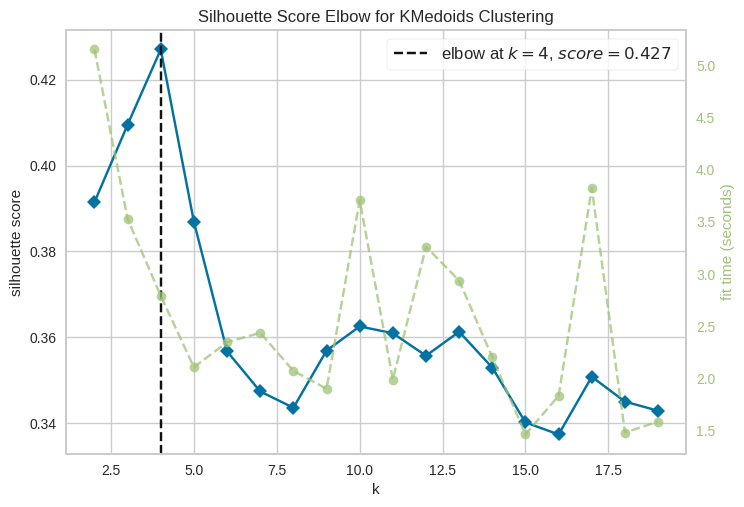

In [13]:
data_with_k={}
for i,data in datos.items():
    k_for_data={}
    k_for_data['codo']=k_medoids(data, metric='distortion',name=f"data_{i+1}_codo")
    k_for_data['silhouette']=k_medoids(data, metric='silhouette',name=f"data_{i+1}_silhouette")
    data_with_k[i]=k_for_data
    

In [14]:
def plot_k_medoids(data, index_data, k=2):
    model = KMedoids(n_clusters=k, max_iter=100, init='random', random_state=100).fit(data)
    
    data['Labels'] = model.labels_
    data['Labels'].value_counts()
    fig, axes = plt.subplots(1, 1, figsize=(5, 5))
    sns.scatterplot(x='x', y='y', data=data, hue='Labels', palette=sns.color_palette('hls', k))
    axes.set_title('Data ' + str(index_data+1) + ' k=' + str(k))

def plot_all_strategy_medoids(data, i, method={}):
    for key, k in method.items():
        plot_k_means(data, i, k=k)

**Comentario:** Valores k correspondientes con el numero de colores

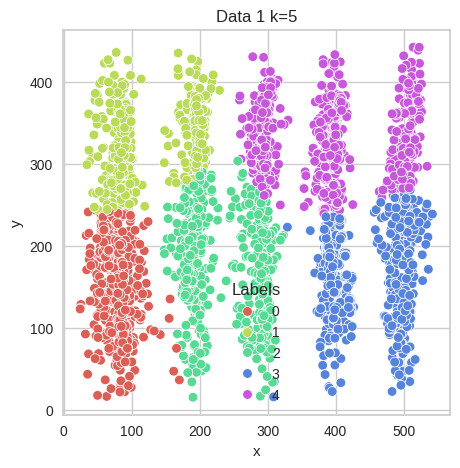

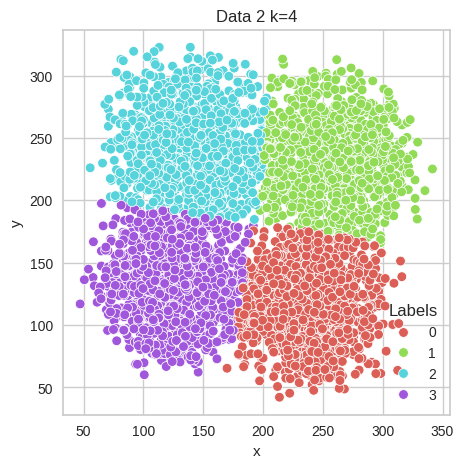

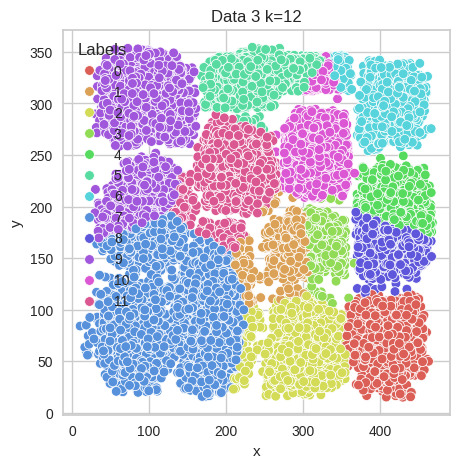

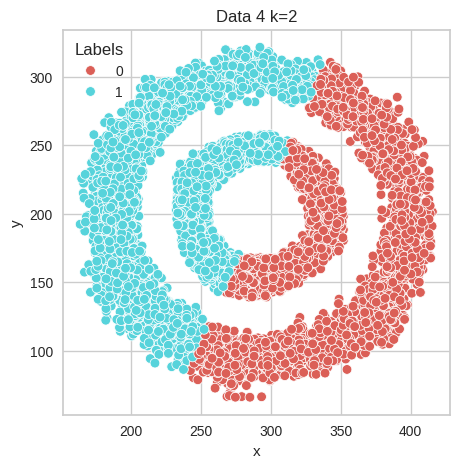

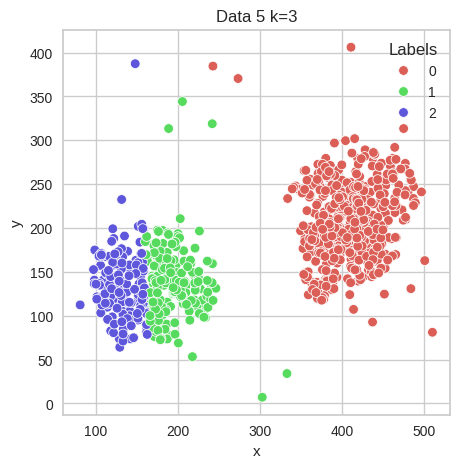

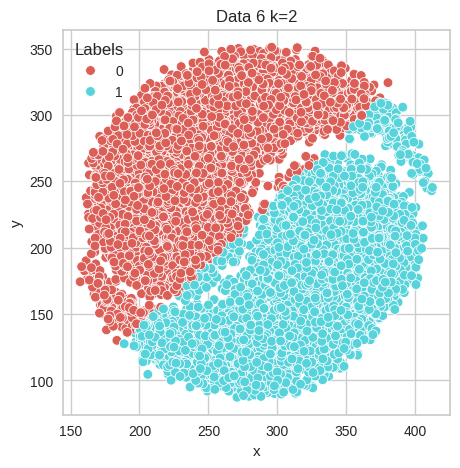

In [15]:
value_k=[5, 4, 12, 2, 3, 2]
for i,data in datos.items():
    plot_k_medoids(data.copy(), i, k=value_k[i])

**Comentario:** Valores k correspondientes a KElbowVisualizer  para cada estrategia

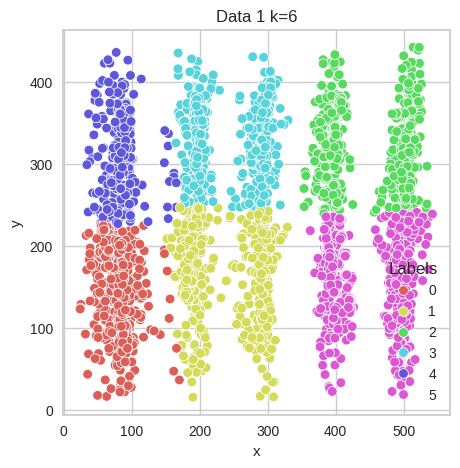

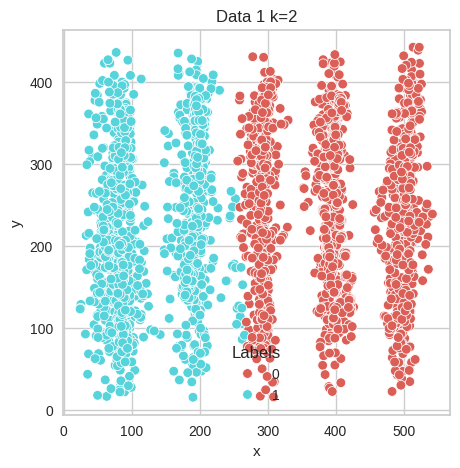

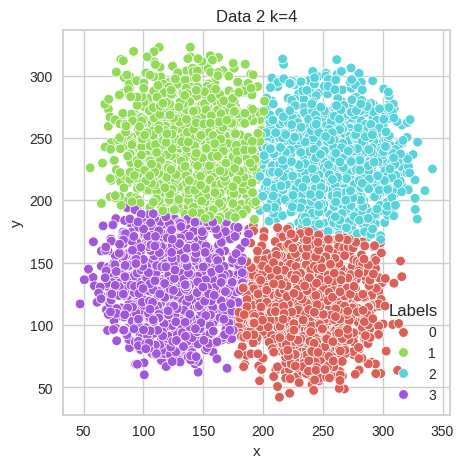

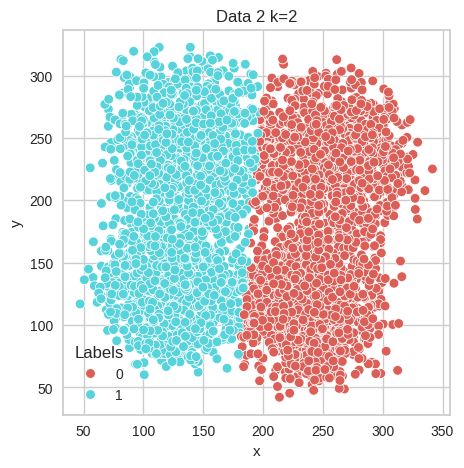

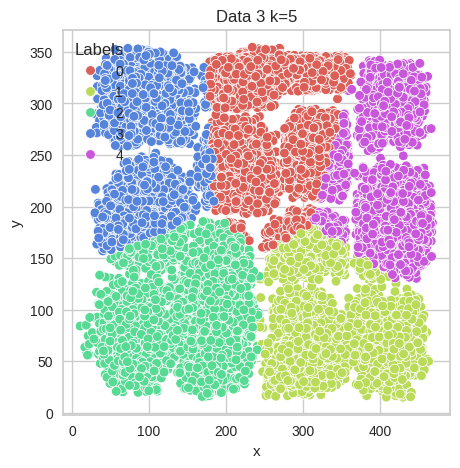

...

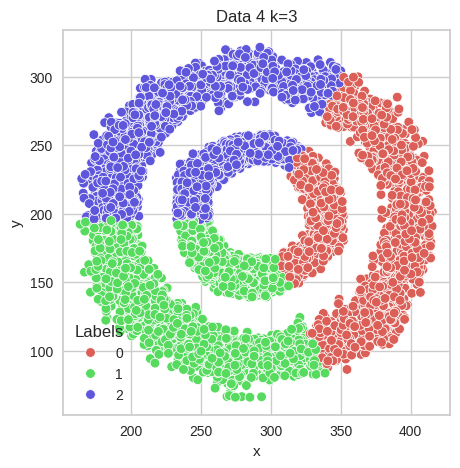

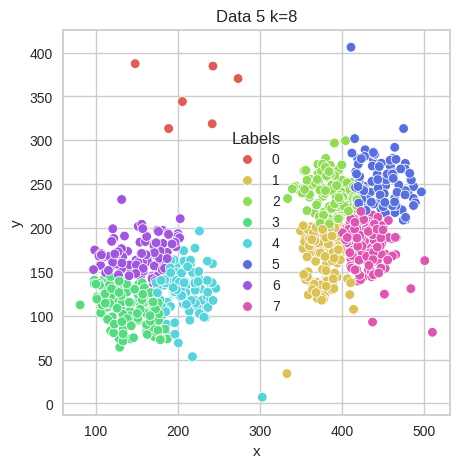

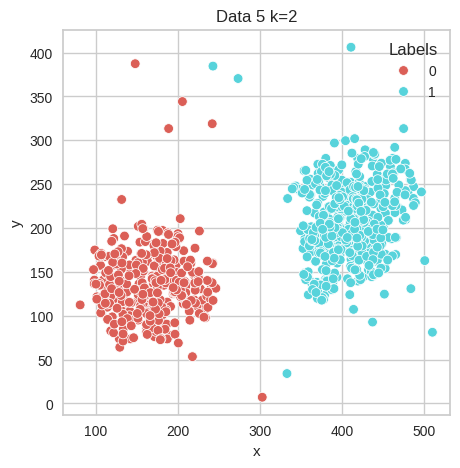

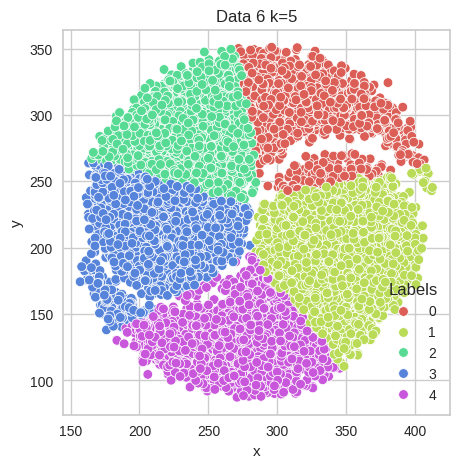

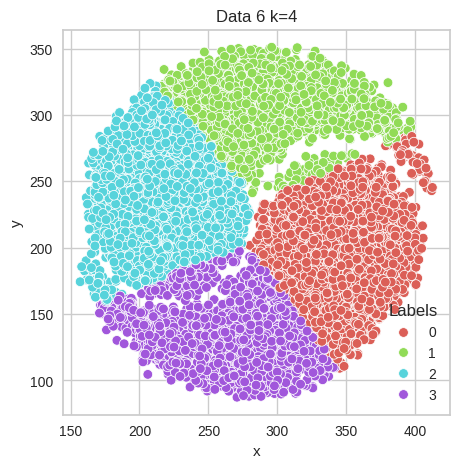

In [16]:
for i,data in datos.items():
    plot_all_strategy_medoids(data.copy(), i, method=data_with_k[i])

**Comentario:** Valores k a la grafica de KElbowVisualizer para la estrategia de silhouette

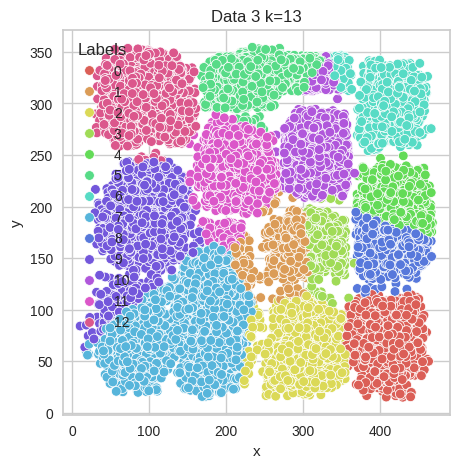

In [17]:
k_p=[[],[],[13],[],[],[]]

for i,data in datos.items():
    for k in k_p[i]:
        plot_k_medoids(data.copy(),i,k=k)

Ahora veamos como se ha agrupado con KMedoids para cada conjunto de datos:
- **Dataset 1:** recordemos que este dataset tenía 5 grupos. El método del codo ha seleccionado k=6 como valor óptimo de k y silhouette ha seleccionado k=2. 
    * Si visualizamos los grupos construidos por KMedoids podemos ver que no coinciden con los reales ni con el agrupamiento de kmeans aunque sean bastante similares. 
    * Al igual que kmeans, para kmedoids el método del codo ha seleccionado k=6 pero el agrupamiento difiere por completo. 
    * Con k=2 sí coinciden los agrupamientos de ambos métodos. 
- **Dataset 2:** este dataset cuenta con 4 grupos, el método del codo ha seleccionado k=4 y el método de silhouette k=2. 
    * Para k=4, vemos como, al igual que kmeans, kmedoids también hace un correcto agrupamiento para este dataset. 
    * Para k=2 los grupos son separables por lo que no sería una agrupación incorrecta si fuese el número correcto de grupos. 
    * Por lo tanto, para este dataset, tanto kmeans como kmedoids son aptos para emplear. Si se tuviera que seleccionar uno de ellos este sería kmeans por su reducido tiempo de ejecución. 
- **Dataset 3:**  este dataset cuenta con 12 grupos, el método del codo ha seleccionado k=5 y el método de silhouette k=2.
    * Para k=12, el número real de grupos, vemos que kmeans ha hecho un mejor trabajo que kmedoids. Los grupos generados por kmeans se acercan mucho a los reales. 
    * Para k=5, los grupos se asemejan bastante a kmeans con k=6 pero ambos siguen estando muy lejos de la realidad.  
    * Para k=2, obtenemos el mismo resultado que kmeans para el valor seleccionado por el método de silhouette. En este caso si que debemos prestar atención a la gráfica de los coeficientes de silhouette ya que el valor máximo se alcanza para k=13, valor que se acerca mucho al número real de grupos. Si vemos la representación de los 13 grupos vemos como también se acerca a la realidad. 
    * Para este conjunto de datos ni kmeans ni kmedoids tuvieron éxito en el agrupamiento. 
- **Dataset 4:** este dataset cuenta con 2 grupos, el método del codo ha seleccionado k=7 y el método de silhouette k=3.
    * Para el número de grupos real, k=2, kmeans y kmedoids funcionaron igual.
    * Lo mismo ha ocurrido para el número de grupos seleccionados por el método del codo y silhouette.
    * Al igual que en kmeans, este conjunto de datos es mucho más complejo de lo que puede gestionar kmedoids o kmeans. 
- **Dataset 5**: este dataset cuenta con 3 grupos, el método del codo ha seleccionado k=8 y el método de silhouette k=2.
    * Para 3 grupos, vemos que al igual que kmeans no se ha agrupado correctamente. 
    * Para k=8, se aleja mucho de la realidad.
    * Para k=2, al igual que en kmedias, los grupos se parecen más a los grupos correctos. 
    * Igual que en kmeans, este dataset, al contar con un grupo mucho menos denso y mucho más disperso que los otros dos, kmedoids no ha funcionado correctamente. 
- **Dataset 6:**  este dataset cuenta con 2 grupos, el método del codo ha seleccionado k=5 y el método de silhouette k=4.
    * En este caso coinciden Kmeans y kmedoids por lo que ambos metodos no son eficaces a la hora de agrupar este tipo de conjunto de datos no convexos. 

Dados los resultados, si hubiese que elegir, se seleccionaría kmeans ya que, aparte de dar mejores resultados en algunos casos, kmedoids es mucho más costoso computacionalmente. 

### Ejercicio 3

[DBScan](https://nzlul.medium.com/clustering-method-using-k-means-hierarchical-and-dbscan-using-python-5ca5721bbfc3)

Agrupa cada uno de los conjuntos de datos anteriores utilizando el DBScan (usa la implementación de scikit-learn). Optimiza el valor de epsilon utilizando la regla del codo en un gráfico de k-distancias a los vecinos. Recuerda que el codo representa el punto donde la tasa de cambio de la distancia media de los k-vecinos más cercanos comienza a disminuir significativamente. Este punto se considera como un indicador del valor óptimo de epsilon. Fija MinPts a 4 (2 x dimensiones).


Compara los resultados gráficamente respecto a los valores obtenidos por el conjunto de datos inicial. ¿Mejoran los resultados del k-medias y del k-medoides?

In [18]:
import plotly.graph_objects as go

In [19]:
def plot_k_distances_o(data, min_pts=4, use_avg=False,i=0):
    """
    Calcula y grafica las distancias al k-ésimo vecino más cercano para cada punto en el conjunto de datos.
    
    Args:
        data: Conjunto de datos a analizar.
        min_pts: Número de puntos mínimos para considerar en la vecindad de un punto.
    """
    # Calcula las distancias al k-ésimo vecino más cercano
    neigh = NearestNeighbors(n_neighbors=min_pts)
    neigh.fit(data)
    distances, _ = neigh.kneighbors(data)
     
    # Ordena las distancias
    # distances_sort = np.sort(distances, axis=0) if use_avg else np.sort(distances[:, -1], axis=0)
    
    distances=np.sort(distances, axis=0) if use_avg else np.sort(distances[:, -1], axis=0)
    
    if use_avg:
        distances = distances.mean(axis=1) # np.mean(distances, axis=1)
        
    diff = np.diff(distances, 2)
    knee_point_index = np.argmax(diff) + 1  # Agregamos 1 para compensar la diferencia
    epsilon_opt = distances[knee_point_index]
    
    # Grafica las distancias
    plt.figure(figsize=(12, 6))
    plt.plot(distances)
    plt.title(f' Data{i} Distancia al {min_pts}-ésimo vecino más cercano use_avg={use_avg}')
    plt.xlabel('Punto')
    plt.ylabel(f'Distancia al {min_pts}-ésimo vecino')
    plt.show()
    
    
    return epsilon_opt


def plot_k_distances(data, min_pts=4, use_avg=False, i=0):
    """
    Calcula y grafica las distancias al k-ésimo vecino más cercano para cada punto en el conjunto de datos utilizando plotly para interactividad.
    
    Args:
        data: Conjunto de datos a analizar.
        min_pts: Número de puntos mínimos para considerar en la vecindad de un punto.
    """
    # Calcula las distancias al k-ésimo vecino más cercano
    neigh = NearestNeighbors(n_neighbors=min_pts)
    neigh.fit(data)
    distances, _ = neigh.kneighbors(data)
    
    # Ordena las distancias
    distances = np.sort(distances, axis=0) if use_avg else np.sort(distances[:, -1], axis=0)
    
    if use_avg:
        distances = distances.mean(axis=1)
    
    diff = np.diff(distances, 2)
    knee_point_index = np.argmax(diff) + 1  # Agregamos 1 para compensar la diferencia
    epsilon_opt = distances[knee_point_index]
    
    # Grafica las distancias
    fig = go.Figure()
    fig.add_trace(go.Scatter(y=distances, mode='lines', name='Distancia'))
    fig.update_layout(title=f'Data{i} Distancia al {min_pts}-ésimo vecino más cercano use_avg={use_avg}',
                      xaxis_title='Punto',
                      yaxis_title=f'Distancia al {min_pts}-ésimo vecino',
                      margin=dict(l=20, r=20, t=50, b=20),
                      hovermode="closest")
    fig.show()
    
    return epsilon_opt


In [20]:
data_with_eps={}


for i,data in datos.items():
    k_for_data={}
    k_for_data['codo_avg']= plot_k_distances(data,use_avg=True,i=i+1)
    k_for_data['codo']= plot_k_distances(data,use_avg=False,i=i+1)
    data_with_eps[i]=k_for_data
    


In [21]:
eps_selected=[[7.5,8,9],[4,5],[3,3.75],[2.5,3],[6,7,8],[3.2,2.5]]
for i,eps in enumerate(eps_selected):
    data_with_eps[i]['selected_avg']=eps

eps_selected=[[12.5,13,14],[6,7,],[3.9,4,4.5],[4],[10,17,18,19],[3.7,4]]
for i,eps in enumerate(eps_selected):
    data_with_eps[i]['selected']=eps

In [22]:
eps_selected=[[18, 19],[],[10],[29,30,35],[10,18],[4,5,6]]

for i,eps in enumerate(eps_selected):
    data_with_eps[i]['selected_visual']=eps
    
eps_selected=[[20,22],[10,12.5],[7.5,8,9],[6,7,8],[38,40],[6,7]]

for i,eps in enumerate(eps_selected):
    data_with_eps[i]['selected_visual_last_codo']=eps

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.datasets import make_blobs

def plot_k_distances(data, min_pts=4):
    # Calcular la distancia media de los k-vecinos más cercanos
    min_pts = 4  # MinPts = 2 x dimensiones
    nbrs = NearestNeighbors(n_neighbors=min_pts).fit(data)
    distances, _ = nbrs.kneighbors(data)
    distances = np.sort(distances, axis=0)
    avg_distances = distances.mean(axis=1)

    # Graficar las k-distancias
    plt.plot(avg_distances)
    plt.xlabel('Índice del punto')
    plt.ylabel('Distancia media de los k-vecinos más cercanos')
    plt.title('Gráfico de k-distancias')
    plt.show()

    # Encontrar el punto de codo (epsilon óptimo)
    # Puedes usar métodos de análisis visual o algoritmos para encontrar el codo.
    # Aquí usaremos un enfoque sencillo basado en la derivada segunda.
    # Dado que no hay una implementación directa de la derivada segunda en numpy,
    # usaremos un enfoque simple de diferencias finitas.
    diff = np.diff(avg_distances, 2)
    knee_point_index = np.argmax(diff) + 1  # Agregamos 1 para compensar la diferencia
    epsilon_opt = avg_distances[knee_point_index]
    print('eps', epsilon_opt)
    # Ejecutar DBSCAN con epsilon optimizado y MinPts fijo
    dbscan = DBSCAN(eps=epsilon_opt, min_samples=min_pts)
    labels = dbscan.fit_predict(data)
    
    #   Graficar los resultados
    plt.scatter(data['x'], data['y'], c=labels, cmap='viridis' , s=10)
    plt.title('Agrupamiento DBSCAN con epsilon óptimo')
    plt.show()

In [24]:

def plot_DBSCAN_old(data,eps=2,min_pts=4):
    model  = DBSCAN(eps=eps, min_samples=min_pts).fit(data)
    
    data['Labels'] = model.labels_
    data['Labels'].value_counts()
    fig, axes = plt.subplots(1,1, figsize=(5,5))
    sns.scatterplot(x='x', y='y', data=data, hue='Labels', 
                palette=sns.color_palette('hls', eps))

def plot_DBSCAN_n(data,epsilon_opt=2,min_pts=4,i=0,method=''):
    
    #print('eps', epsilon_opt)
    # Ejecutar DBSCAN con epsilon optimizado y MinPts fijo
    dbscan = DBSCAN(eps=epsilon_opt, min_samples=min_pts)
    labels = dbscan.fit_predict(data)
    
    #   Graficar los resultados
    plt.scatter(data['x'], data['y'], c=labels, cmap='hls' , s=10)
    plt.title(f'Agrupamiento DBSCAN {method} para el Data{i} \n con epsilon óptimo {epsilon_opt}')
    plt.show()

def plot_DBSCAN(data, epsilon_opt=2, min_pts=4, i=0, method=''):
    # Ejecutar DBSCAN con epsilon optimizado y MinPts fijo
    dbscan = DBSCAN(eps=epsilon_opt, min_samples=min_pts)
    labels = dbscan.fit_predict(data)
    
    # Graficar los resultados
    unique_labels = set(labels)
    #colors = [plt.cm.viridis(each) for each in np.linspace(0, 1, len(unique_labels))]
    #colors = plt.cm.Set3(np.linspace(0, 1, len(unique_labels)))
    colors_palettes = ['Set3', 'Set2', 'Pastel2']
    colors = []
    for palette in colors_palettes:
        colors.extend(plt.get_cmap(palette).colors)
    colors = np.array(colors)
    
    for k, col in zip(unique_labels, colors):
        if k == -1:
            # Color negro para ruido.
            col = 'k'
        
        class_member_mask = (labels == k)
        xy = data[class_member_mask]
        plt.plot(xy['x'], xy['y'], 'o', markerfacecolor=col, markeredgecolor='k', markersize=6, label=f'Cluster {k}' if k != -1 else 'Ruido')
    
    plt.title(f'Agrupamiento DBSCAN {method} para el Data{i} \n con epsilon óptimo {epsilon_opt}')
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.show()
    
def plot_all_strategy_DBSCAN(data,i,method={}):
    for key,eps in method.items():
        #print(key,eps)
        if isinstance(eps, (np.float64, np.float32)):
            eps=[eps]
        for ep in eps:
            #print(key,ep)
            if ep>0:
                plot_DBSCAN(data,epsilon_opt=ep,i=i,method=key)

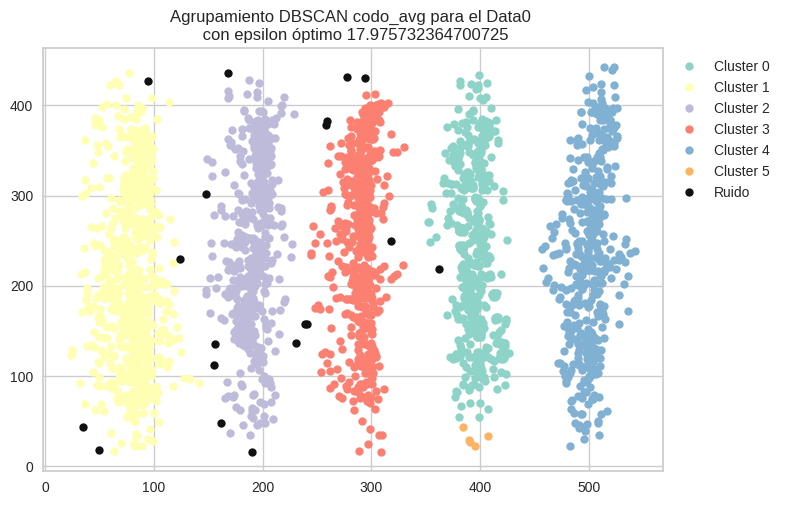

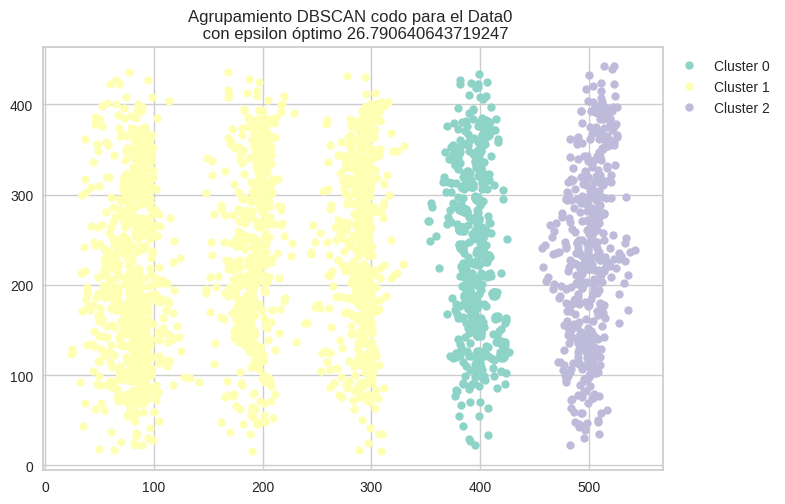

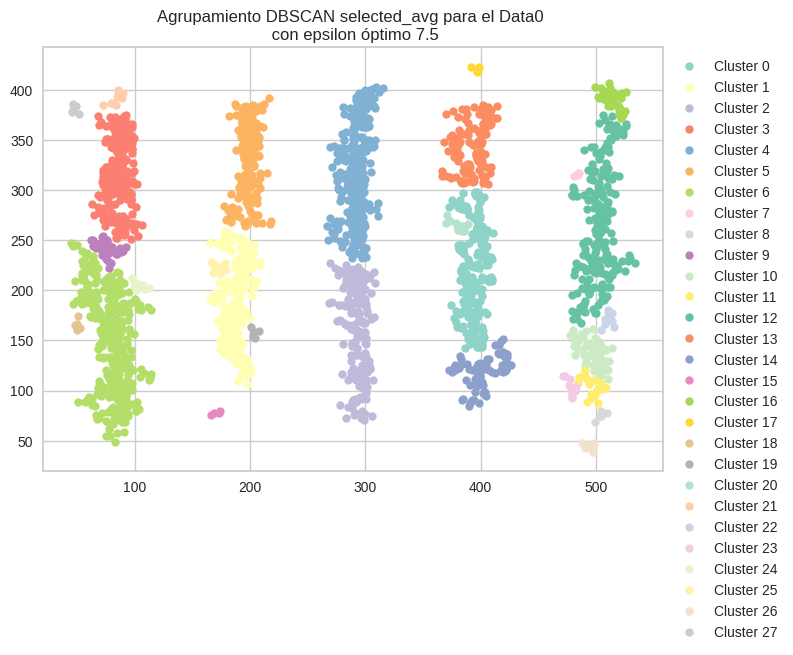

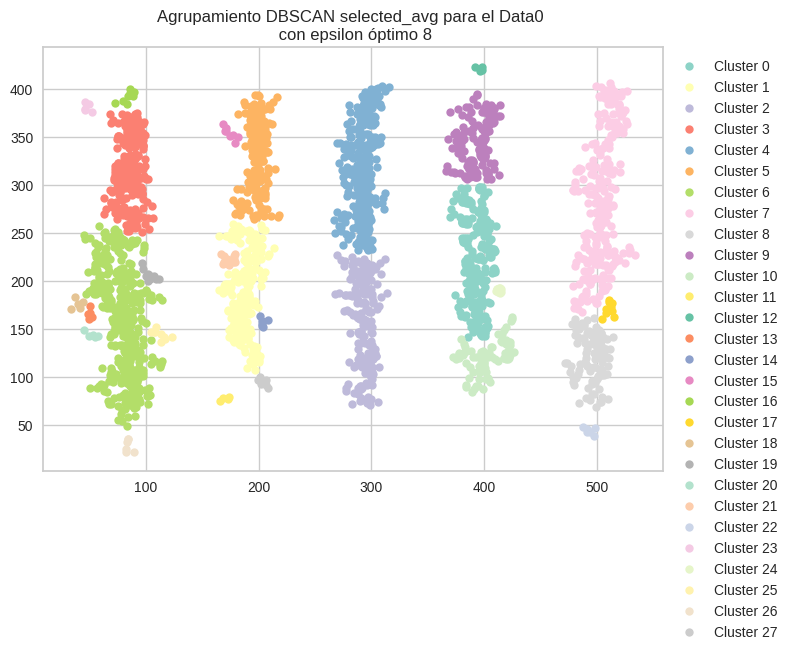

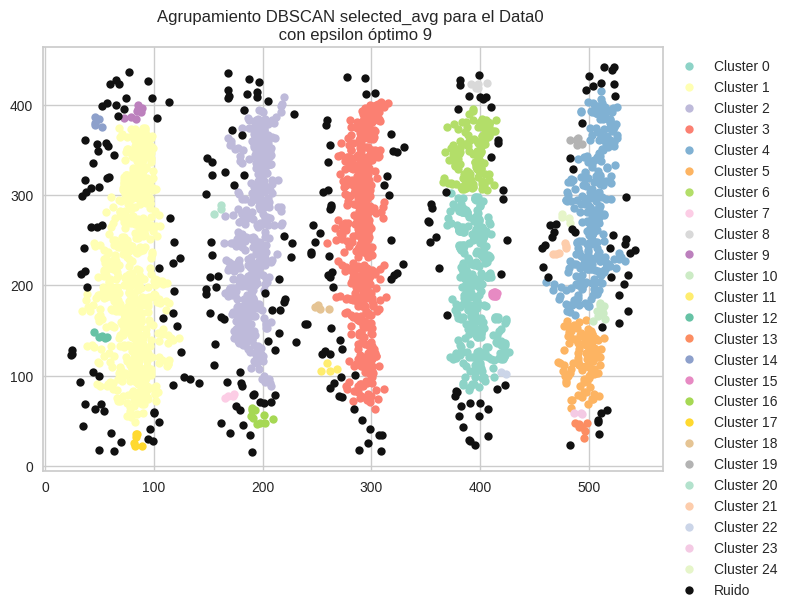

...

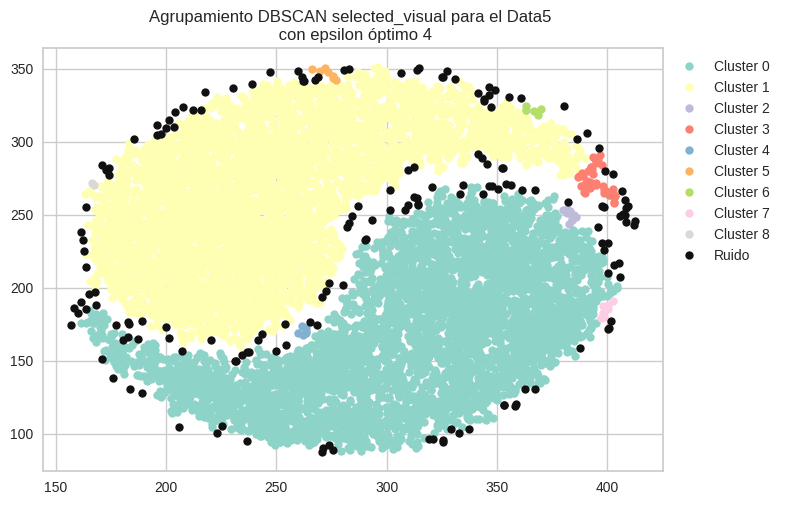

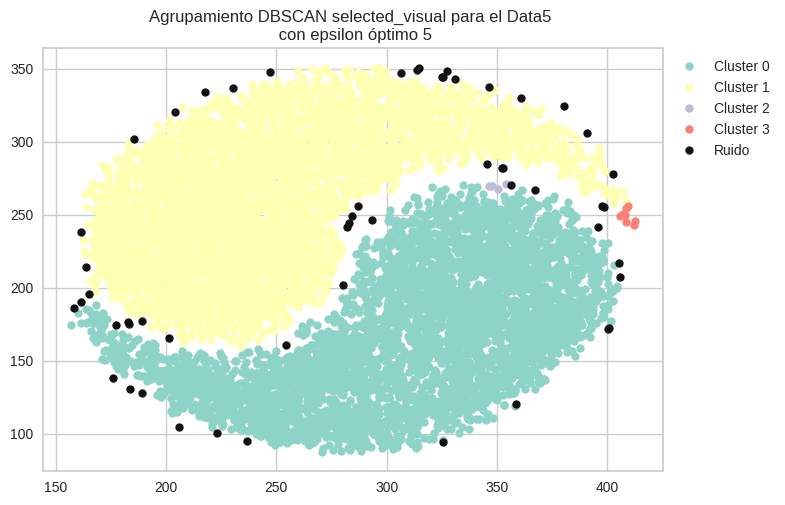

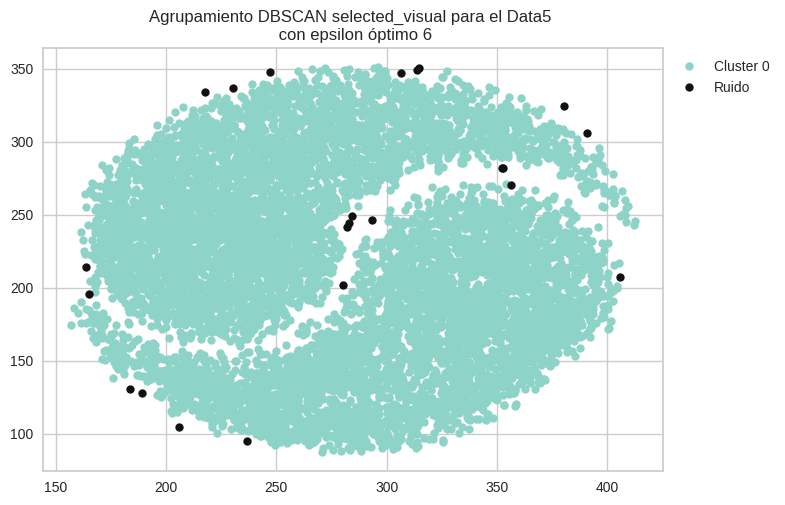

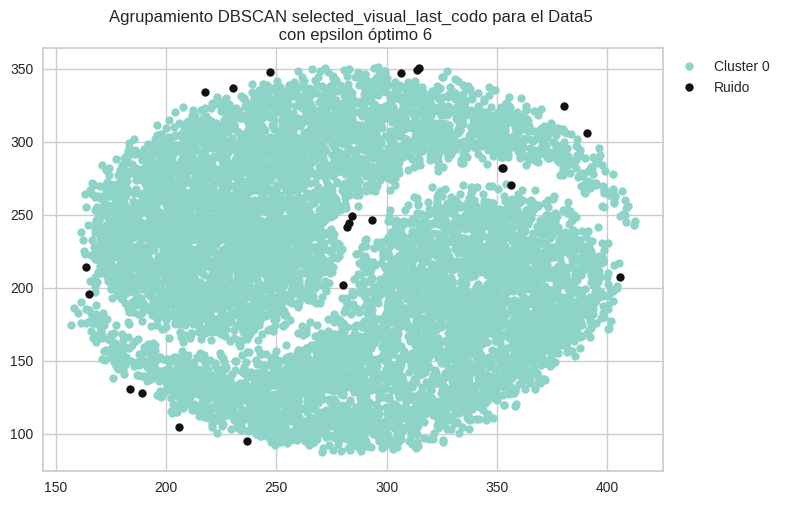

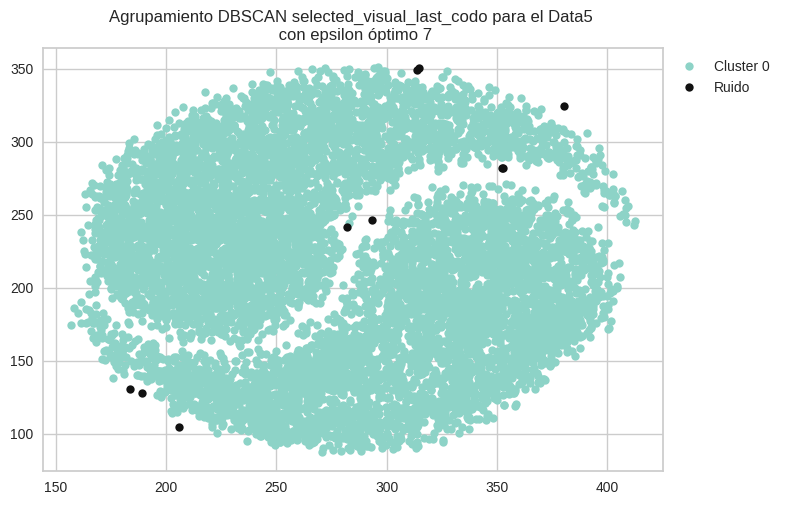

In [25]:
for i,data in datos.items():
    plot_all_strategy_DBSCAN(data.copy(), i, method=data_with_eps[i])

In [26]:
data_with_eps={}    
eps_selected=[[20,22],[10,12.5],[7.5,8,9],[6,7,8],[38,40],[6,7]]

for i,eps in enumerate(eps_selected):
    k_for_data={'selected_visual_last_codo':eps}
    data_with_eps[i]=k_for_data

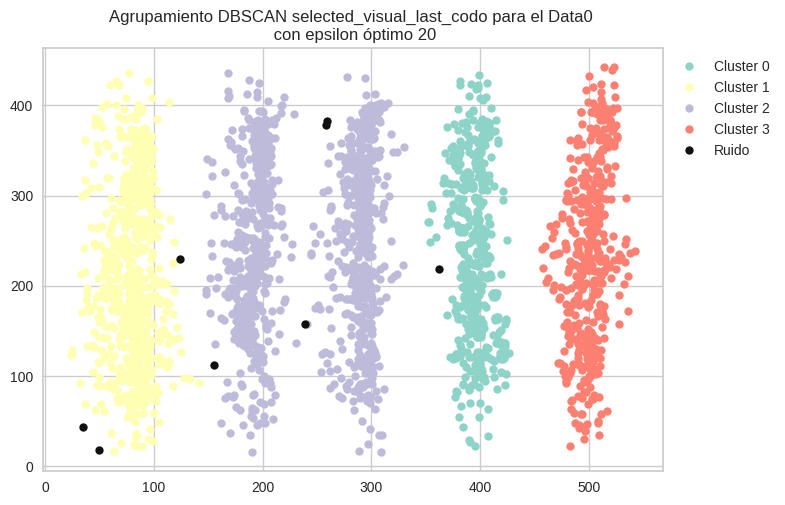

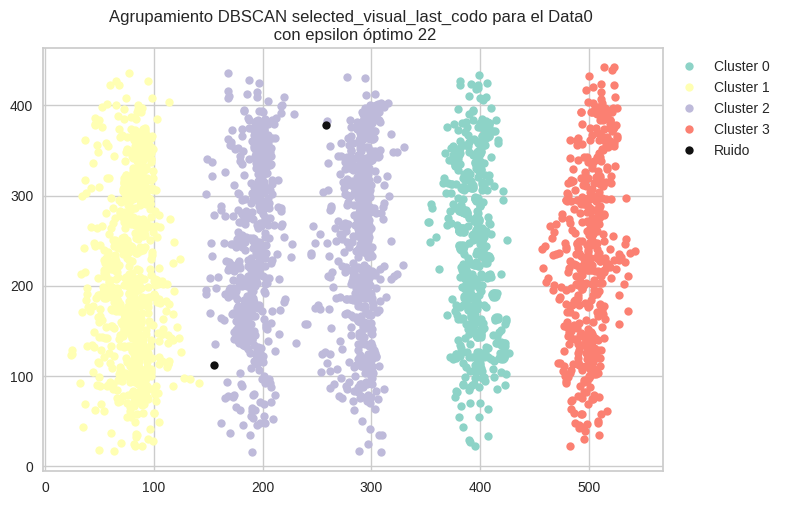

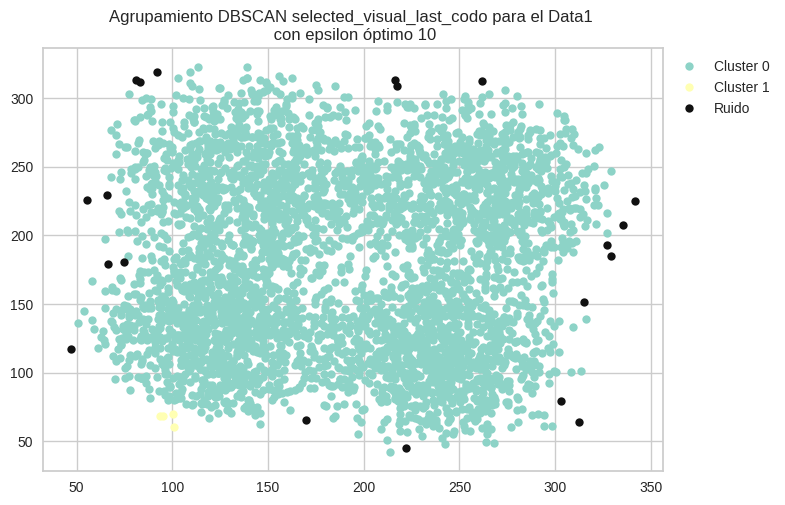

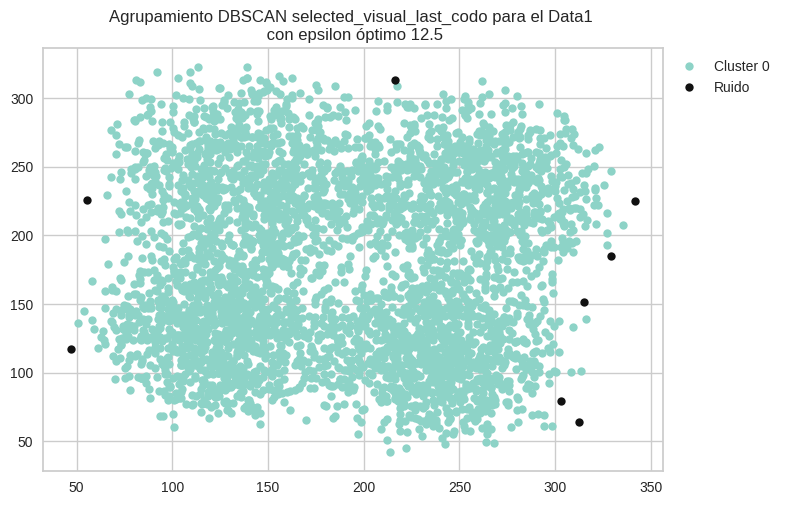

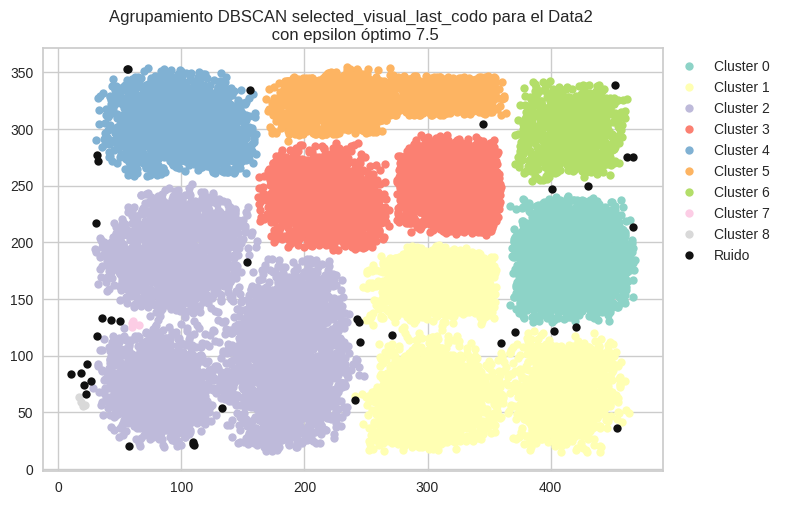

...

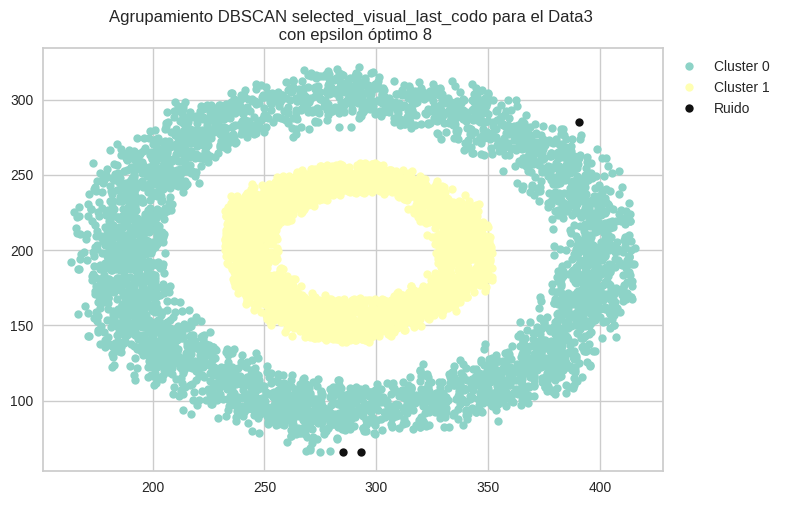

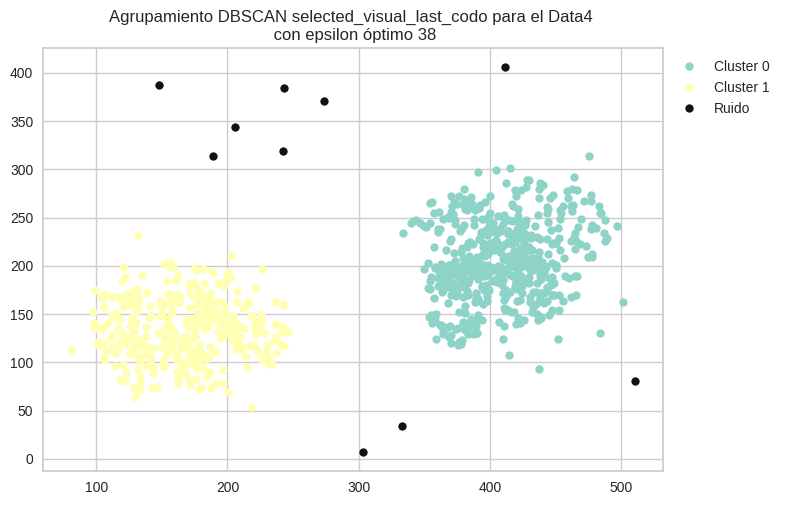

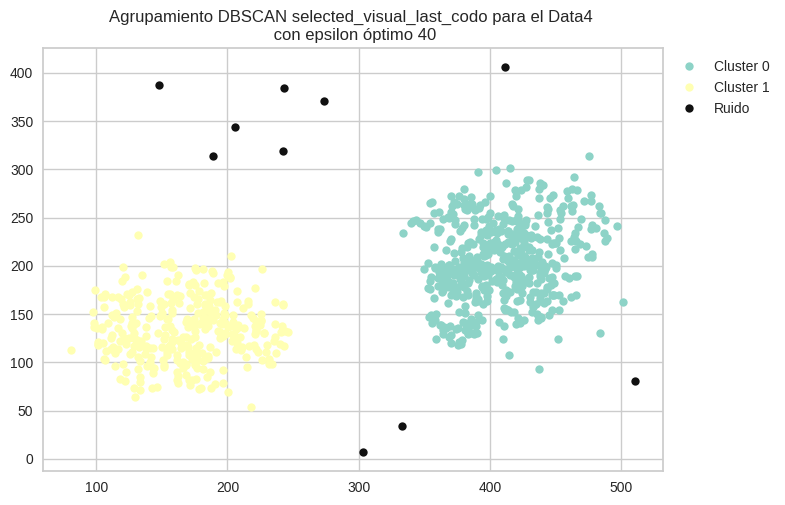

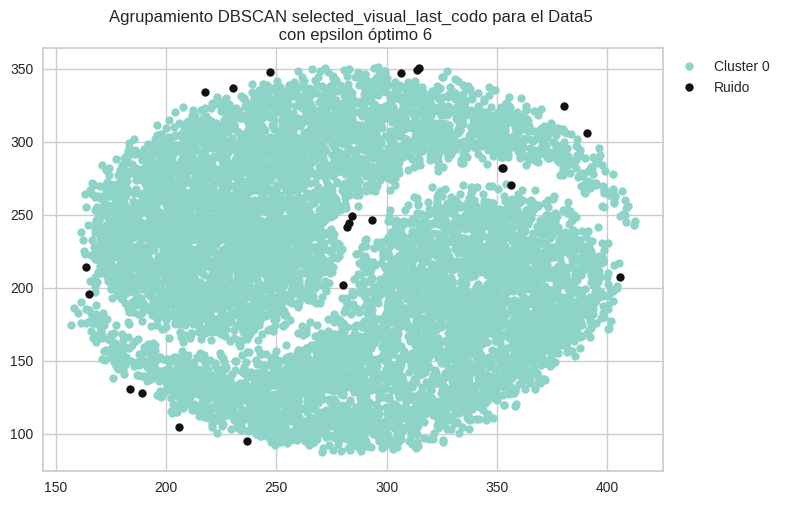

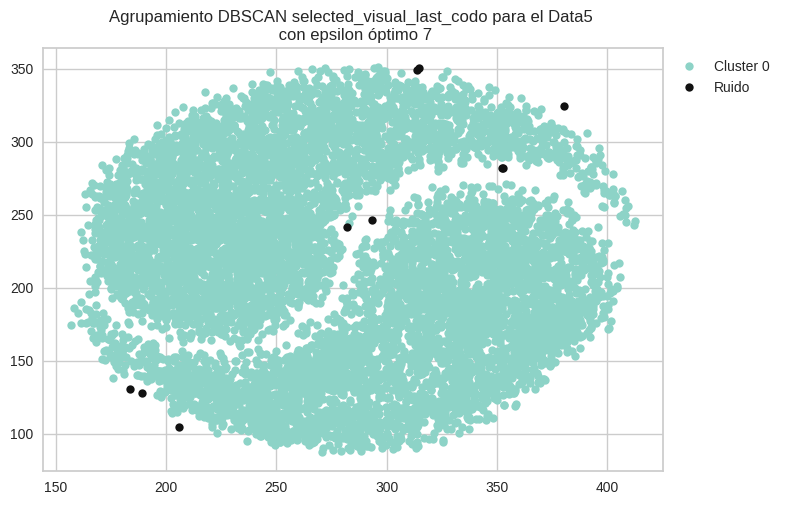

In [27]:
for i,data in datos.items():
    plot_all_strategy_DBSCAN(data.copy(), i, method=data_with_eps[i])

In [28]:
eps_selected=[[18],[8.5],[5.6],[5],[36],[4.7]]
for i,eps in enumerate(eps_selected):
    k_for_data={'selected_visual_last_codo':eps}
    data_with_eps[i]=k_for_data

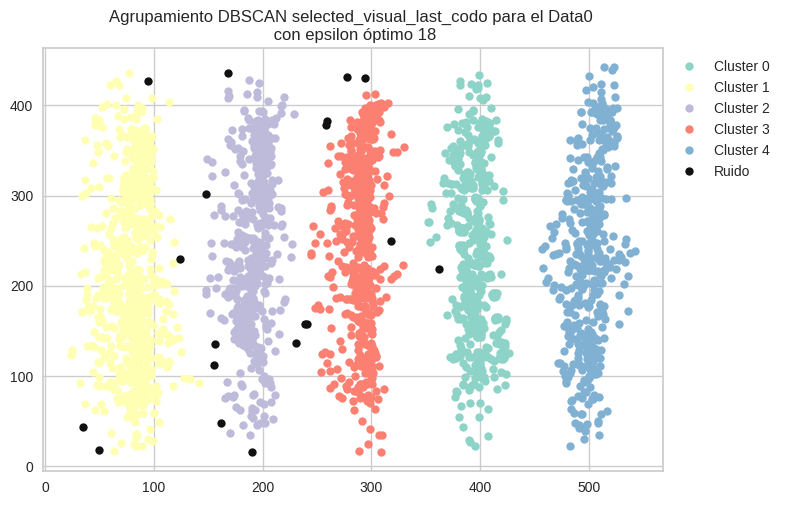

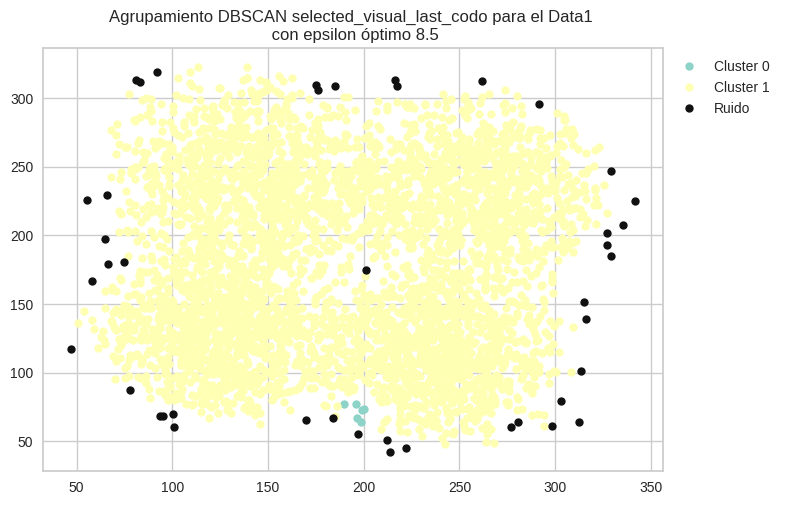

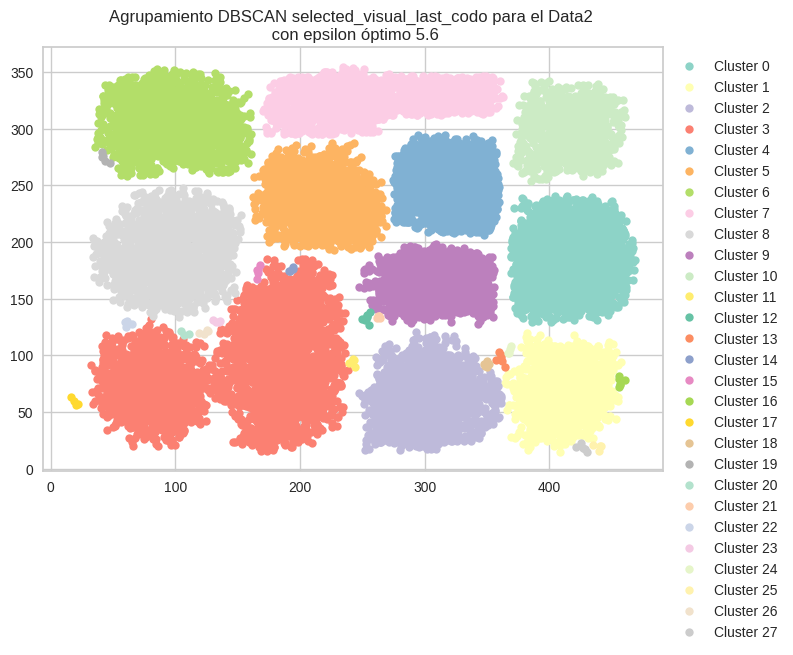

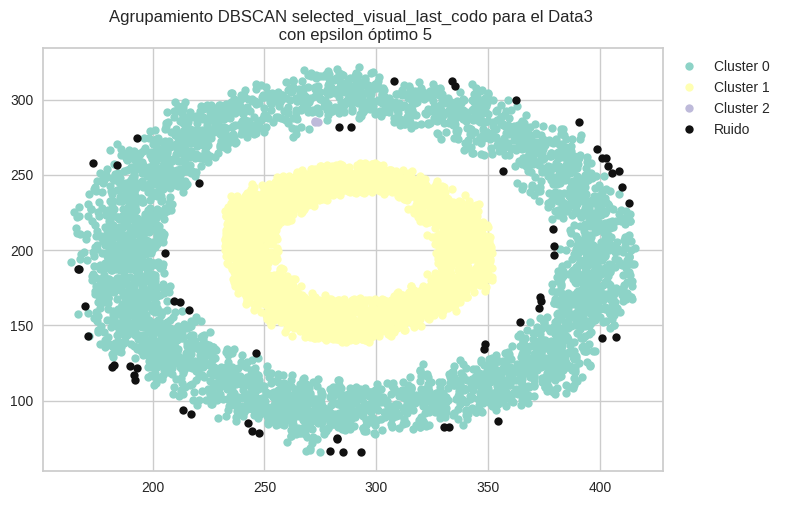

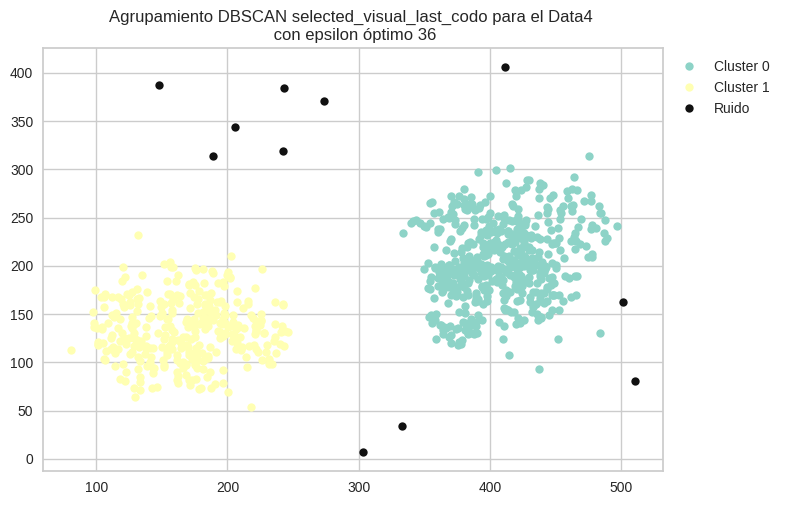

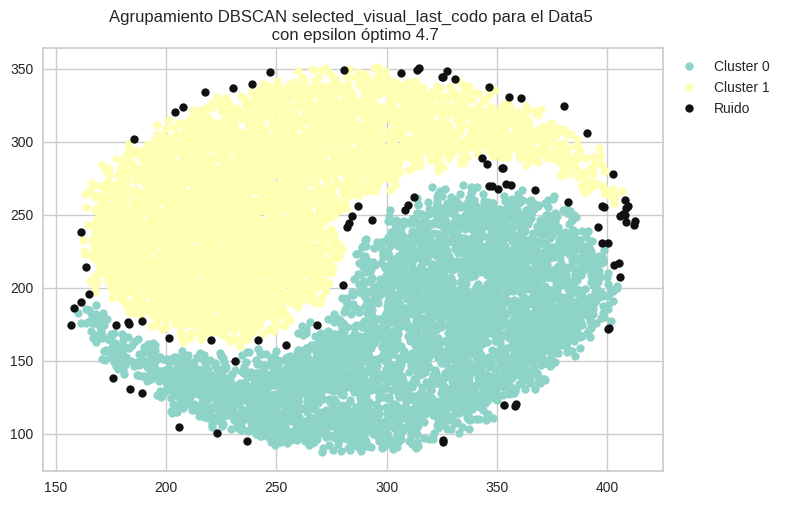

In [29]:
for i,data in datos.items():
    plot_all_strategy_DBSCAN(data.copy(), i, method=data_with_eps[i])

**Comentario:** Comentemos los resultados por dataset. Las opciones contempladas las identificaremos da la siguiente manera: 
* Opción 1: Eps obtenido usando la segunda derivada y la distancia media. 
* Opción 2: Eps obtenido usando la segunda derivada y la distancia individual. 
* Opción 3: Eps obtenido usando la distancia media y a ojo. 
* Opción 4: Eps obtenido usando la distancia individual y a ojo (primera parte de la curva). 
* Opción 5: Eps obtenido usando la distancia individual y a ojo (última parte de la curva).
* Opción 6: Eps obtenido usando la distancia individual y a ojo (valores probados a ojo a partir de los resultados de la opción 5).

- Dataset 1: recordemos que este dataset cuenta con 5 grupos en la realidad. Veamos los resultados de cada una de las opciones contempladas.
    * Opción 1: se ha obtenido un valor de eps de aproximadamente 18 que ha dado lugar a 6 clústeres. Pese a no ser el resultado deseado en comparación a KMeans y KMedois, DBscan obtiene clústeres con una forma muy similar a la real, por lo tanto, esto ya nos indica que, de momento, DBscan podría ser el método de agrupamiento indicado para este tipo de clústeres.
    * Opción 2: con un valor de eps de 26.8 se obtienen 3 clústers y nada de ruido. Los clústeres son completamente separables. 
    * Opción 3: se escogido un valor de eps 7.5 que da como resultado 27 clústers por lo que no es un valor adecuado. También se ha probado el valor 8 y da un resultado similar al anterior. Por último, se ha seleccionado un valor de eps de 9 pero también da un número muy alto de clusteres (2) y mucho ruido. 
    * Opción 4: se ha seleccionado eps=12.5 que da lugar a 14 clústeres y ruido. Realmente los clústeres más grandes son 5 y se asemejan bastante a la realidad por lo que con un valor óptimo de eps podríamos obtener un resultado muy similar a la realidad. Algo muy similar ocurre para los valores de eps 13 y 14, que dan lugar a 12 y 8 clústeres por lo que sabemos que probablemente con un valor de eps mayor podríabmos obtener los 5 clústeres que buscamos. 
    * Opción 5: se ha seleccionado en primer lugar un valor de eps de 18 el cual da lugar a 5 clústers, cumpliendo con la teoría anterior, y poco ruido. Los clústeres tiene una forma prácticamente idéntica a los reales. Con eps=19 ya obtenemos solo 4 grupos. 
    * Opción 6: vistos los resultados de la opción 5, se han probado los valores 18.25 y 18.5. El primero de los valores de eps ha dado un resultado visualmente idéntico a al anterior con valor 18. El valor 18.5 ya da lugar a 4 clústeres. 
    * Conclusión: eps con valor 18 es la mejor opción. 

- Dataset 2: 
    * Opción 1: con este primer procedimiento se obtiene un valor de eps de 13 aproximadamente que da lugar a un solo clúster. 
    * Opción 2: esta opcion obtiene un valor de eps de 14.9 y de forma similar al anterio da lugar a un solo clúster. 
    * Opción 3: con un valor de eps de 4 se obtienen 27 clústers pero en este caso 3 de ellos están bien difernciados asemejandose bastante a la realidad. Ya con un valor de 5 y 27 clústeres obtenemos un resultado pésimo con un solo grupo grande y el resto pequeños. 
    * Opción 4: se han seleccionado los valores de eps 6 y 7, ambos dan lugar a un numero de grupos mayor que 4 donde también solo uno de los grupos prácticamente incluye a todas las observaciones. 
    * Opción 5: nada
    * Opción 6: se han seleccionado, finalmente, los valores de eps de 10 y 12.5 pero tampoco han dado resultados muy distintos.
    * Conclusión: el método de dbscan no es apropiado para este clúster ya que ninguno de los valores estudiados ha dado un resultado decente. 

- Dataset 3:
    * Opción 1: con eps=10 se obtienen solamente 3 clústers. Aunque no sea el número de grupos correcto se pueden ver dos grupos que se corresponden a dos de los grupos reales del conjunto de datosm. 
    * Opción 2: con un valor de 13 de eps obtenemos un solo clúster por lo que no es correcto. 
    * Opción 3: se ha escogido un valor de 3 y pese al número de clústers identificados (un total de 27) los grupos más grandes son un total de 12, es decir, el número real de clústeres. Además, la forma de los grupos también es idéntica a la realidad. Con un valor de 3.5 obtenemos prácticamente el mismo resultado. 
    * Opción 4: se han seleccionado los valores 3.9, 4 y 4.5 que dan lugar los tres a 27 clusteres también, y la forma de de los grupos se asemeja a los resultados del apartado anterior. 
    * Opción 5: igual que la opción 1. 
    * Opción 6: por último, visualmente se han seleccionado los valores de eps 8 y 9 dando lugar a 7 y 4 clústeres, respectivamente. En ambos, se han identificado correctamente algunos de los grupos, coincidiendo en tamaño y forma con la realidad. 
    * Conclusión: Ninguno de los resultados anteriores nos dan un total de 12 clústeres. De todos modos, dbscan es capaz de identificarlos como grupos grandes como en el caso de la opción 3 y sobre todo respectando la forma real de los mismos. 

- Dataset 4: 
    * Opción 1: se ha obtenido un valor de eps de 7 aprox. dando lugar a dos clústeres prácticamente idénticos a los reales pero con algo de ruido. 
    * Opción 2: con un valor de 10.4 se obtienen dos grupos totalmente separables y exáctamente iguales a los reales sin ningún ruido. 
    * Opción 3: con un valor seleccionado de 2.5 se obtienen 27 clústeres donde solo el uno de ellos, el grupo del centro, se ha formado correctamente mientras en el externo se han identificado muchos más subgrupos de los existentes. Con un valor de 3 se repite el escenario anterior pero vemos que dentro de los subgrupos algunos son notablemente más grandes que los otros. 
    * Opción 4: con un valor seleccionado de 4, se obtienen 13 clústeres pero solamente dos de ellos son realmente diferenciables asemejandose más a los reales. 
    * Opción 5: se han seleccionado los valores de eps de 29, 30 y 35 pero solamente dan lugar a un solo cluster. 
    * Opción 6: por último, se han probado los valores 6, 7, 8 y 9 y se ha visto como los cuatro dan lugar a dos grupos pero eps=9 no ha tenido ruido. 
    * Conclusión: Hemos visto que valores de eps pequeños como los menores a 4 dan lugar a muchos grupos pequeños pero al aumentar el valor, solamente dos grupos se hacen notablemente más grandes coincidiendo en forma con el real en ocasiones, incluso llegando al caso ideal con valores como 9 o 10 pero a medida que eps se hace más grande no se identifican grupos.  

- Dataset 5: 
    * Opción 1: con un valor de 28 aproximadamente, se han identificado dos grupos y ruido, donde parte de dicho se corresponde con el tercer grupo. De todas formas, los dos grupos coinciden en forma con los reales. 
    * Opción 2: con un valor de 94.8 se han identificado 3 grupos donde el más pequeño cuenta con observaciones que realmente le pertenecen pero algunas de ellas (la parte inferior de la gráfica) se han asociado a los otros dos grupos. 
    * Opción 3: con un valor de 6 y 7 se forman 27 clústeres por lo cual es incorrecto. También con un valor de 8 se obtienen muchos clusteres pero los dos más grandes son los de siempre. 
    * Opción 4: se ha seleccionado un valor de 10 que ha dado lugar a 6  clústeres y también se han escogido los valores 17, 18 y 19 con los que se han obtenido solamente dos grupos y ruido. 
    * Opción 5: se ha probado con el valor de eps 10, el cual coincide con el caso anterior, y 18 que también forma solamente dos grupos y ruido. 
    * Opción 6: por último se han probado los valores 38 y 40 pero también obtienen solamente dos grupos y ruido.
    * Conclusión: Solamente se ha conseguido obtener tres grupos con un valor de eps de 94.8 que tampoco coinciden totalmente con los reales pero generalmente con dbscan se logran identificar correctamente los dos grupos más grandes. 

- Dataset 6: 
    * Opción 1: con eps=6.86 no se logra identificar ningún grupo. 
    * Opción 2: con eps=11.46 actúa de la misma manera que el caso anterior. 
    * Opción 3: con el valor seleccionado de 3.2 se identifican 27 grupos pero dos de ellos son notablemente más grandes coinciendo en forma con los reales. Este valor nos indica que puede existir un valor de eps en el que se identifiquen los dos grupos de manera exactamente igual a los reales. Ya con un valor de 2.5 los 27 grupos son más pequeños. 
    * Opción 4: se han seleccionado los valores 3.7 y 4 dando lugar a 15 y 8 grupos respectivamente donde solo dos de ellos son nuevamente más grandes. 
    * Opción 5: se han seleccionado los valores de eps 4, 5 y 6 y se han obtenido 9, 4 y 1 grupos, respectivamente. Vemos como al aumentar el valor de eps el número de grupos disminuye y además la forma de los mismos sigue asemejándose a la realidad.  
    * Opción 6: Dados los resultados anteriores se han probado los valores de 5.25, 5.5 y 5.75 y se han generado 4, 3 y 2 grupos, respectivamente, con algo de ruido. 
    * Conclusiones: Vemos como dbscan es el método adecuado para este tipo de clústeres.  

# Ejercicio 4

Hierarchical Clustering

In [30]:
for i,data in datos.items():
    display(data.head())

,x,y,color
0,394.778257,162.929596,3
1,113.187672,136.498196,0
2,400.937252,194.179802,3
3,194.372621,208.106101,2
4,290.609779,135.674950,1


,x,y,color
0,199.115034,72.641121,1
1,196.880523,247.744708,2
2,88.426271,233.962425,2
3,118.578789,264.044188,2
4,249.572490,260.896521,0


,x,y,color
0,400.806675,174.702750,6
1,401.154038,70.450386,0
2,294.722093,30.296820,4
3,415.366580,86.633522,0
4,181.464244,83.254630,1


,x,y,color
0,239.650438,300.176323,0
1,288.373881,102.813599,0
2,334.129409,165.764844,1
3,193.401962,202.979989,0
4,294.588391,98.569759,0


,x,y,color
0,355.297197,148.880238,1
1,402.111403,244.566989,1
2,383.443863,224.191167,1
3,424.774071,207.348790,1
4,398.722062,214.262629,1


,x,y,color
0,281.762010,186.024837,1
1,212.503675,199.031585,0
2,180.014895,259.379060,0
3,302.372404,284.465182,0
4,328.759727,176.945518,1


In [31]:
import scipy.cluster.hierarchy as sch
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster import hierarchy


In [32]:
def dintacia_mas_significativa_old(distancias):
    # Calculamos las diferencias en distancias entre fusiones consecutivas
    diferencias = np.diff(distancias)

    # Calculamos un umbral basado en, por ejemplo, un múltiplo de la desviación estándar de las diferencias
    umbral = np.percentile(diferencias, 99.935) + np.std(diferencias) # + 2 * np.std(diferencias)

    # Identificamos los índices donde las diferencias superan el umbral
    indices_significativos = np.where(diferencias > umbral)[0]

    # Si existe al menos un salto significativo, seleccionamos el primero de ellos
    if indices_significativos.size > 0:
        indice_elegido = indices_significativos[0]
        distancia_optima_corte = distancias[indice_elegido]
    else:
        # En caso de que no haya saltos que cumplan el criterio, optamos por un valor por defecto o una lógica alternativa
        distancia_optima_corte = distancias[0]  # O cualquier otra lógica que prefieras

    return distancia_optima_corte

def distancia_mas_significativa(distancias):
    # Calculamos las diferencias en distancias entre fusiones consecutivas (primera derivada)
    diferencias = np.diff(distancias)
    
    # Calculamos la segunda derivada de las distancias
    diferencias_segunda = np.diff(diferencias)
    
    # Identificamos el índice del cambio más drástico, que es donde la segunda derivada es máxima
    indice_cambio_drastico = np.argmax(np.abs(diferencias_segunda))
    
    # La distancia óptima para el corte es justo después del cambio más drástico
    distancia_optima_corte = distancias[indice_cambio_drastico+1]  # +1 porque np.diff reduce el tamaño del array

    return distancia_optima_corte

def distancia_mas_significativa_con_cambio_relativo(distancias):
    # Calculamos las diferencias en distancias entre fusiones consecutivas
    diferencias = np.diff(distancias)
    
    # Calculamos el porcentaje de cambio entre las diferencias consecutivas
    # Evitamos la división por cero agregando un pequeño valor epsilon
    epsilon = 1e-10
    cambios_relativos = np.diff(diferencias) / (diferencias[:-1] + epsilon) * 100
    
    # Establecemos un umbral basado en, por ejemplo, el percentil 95 de los cambios relativos
    umbral = np.percentile(np.abs(cambios_relativos), 75)
    
    # Identificamos los índices donde los cambios relativos superan el umbral
    indices_significativos = np.where(np.abs(cambios_relativos) > umbral)[0]
    
    #print(indices_significativos)
    # Si existe al menos un cambio significativo, seleccionamos el primero de ellos
    if indices_significativos.size > 0:
        indice_elegido = indices_significativos[-1] - 1 # Ajustamos el índice debido al cálculo de las diferencias
        print(indice_elegido)
        distancia_optima_corte = distancias[indice_elegido]
    else:
        # En caso de que no haya cambios que cumplan el criterio, optamos por un valor por defecto
        distancia_optima_corte = distancias[-1]  # Usamos la última distancia como default
    
    return distancia_optima_corte #distancia_optima_corte


def dendrograma(data,i=0,method='ward',threshold=99,criterion='distance'):
    # Seleccionamos las columnas 'x' e 'y' para el agrupamiento
    X = data.iloc[:, [0, 1]].values

    plt.figure(figsize=(17, 10))
    plt.title(f'Dendrograma Data{i+1} method = {method}')
    plt.xlabel('Clientes')
    plt.ylabel('Distancias Euclidianas')
    # plt.grid(True)  # Esta línea está comentada, pero puedes descomentarla si deseas ver la cuadrícula

    # Generación del dendrograma
    # Utilizar linkage para realizar la agrupación jerárquica
    # Comprobación de codo: graficar las distancias entre sucesivas agrupaciones
    Z=sch.linkage(X, method=method)
    dendrograma = sch.dendrogram(Z)
    
    # Calculamos la inconsistencia para cada enlace
    inconsist = sch.inconsistent(Z)

    # Seleccionamos un umbral basado en la inconsistencia
    # Por ejemplo, elegir un umbral que esté por encima del 75% de las inconsistencias calculadas
    threshold = np.percentile(inconsist[:, -2], threshold)
        
   
    
    # Calculamos las distancias de fusión
    distancias = Z[:, 2]

    # Calculamos las diferencias en distancias entre fusiones consecutivas
    diferencias = np.diff(distancias)

    # Encontramos el índice del mayor salto en distancia
    indice_mayor_salto = np.argmax(diferencias)

    # La distancia óptima para el corte es justo después del mayor salto
    distancia_optima_corte = dintacia_mas_significativa_old(distancias) # distancias[indice_mayor_salto]
    
    clusters = sch.fcluster(Z, distancia_optima_corte, criterion=criterion)

    # El número óptimo de clusters sería el número de clusters formados
    print(distancia_optima_corte)
    num_optimo_clusters = len(set(clusters))
    plt.hlines(y=distancia_optima_corte,xmin=0,xmax=10000000000,lw=3,linestyles='--')
    plt.show()
    return num_optimo_clusters
    

4124.359307073855


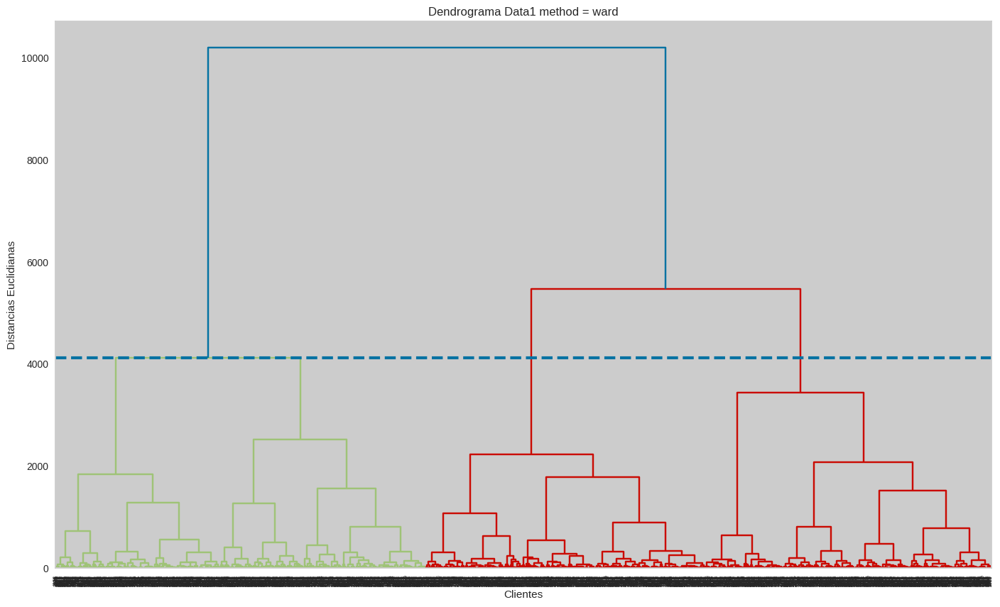

1217.936688705885


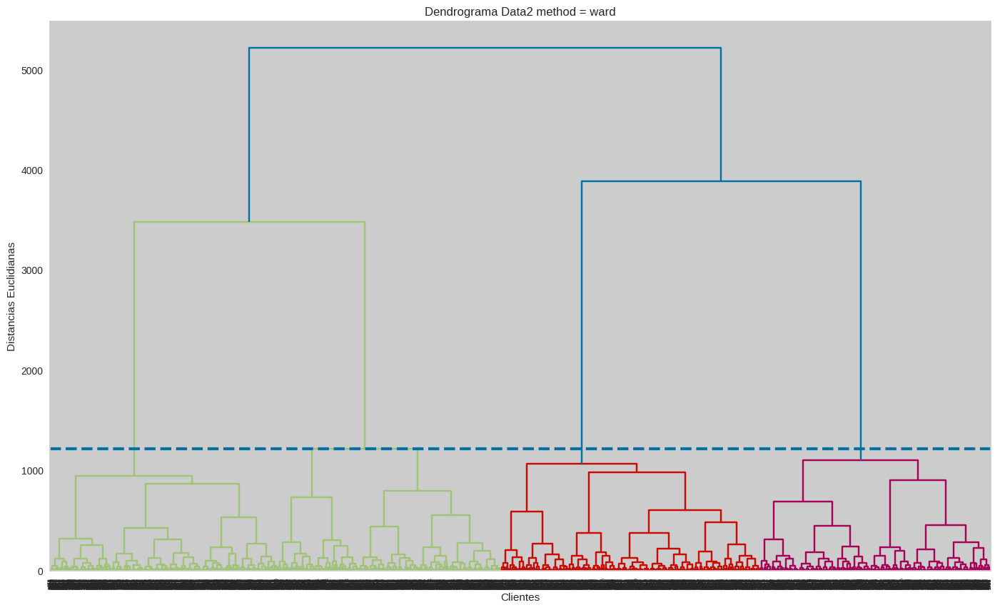

1130.390308497666


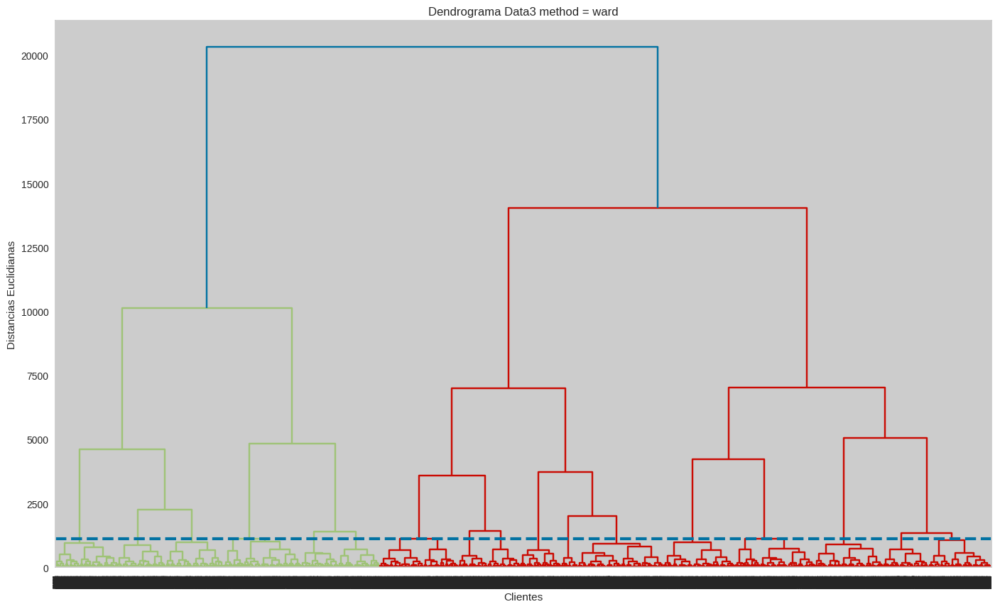

1386.6332789649653


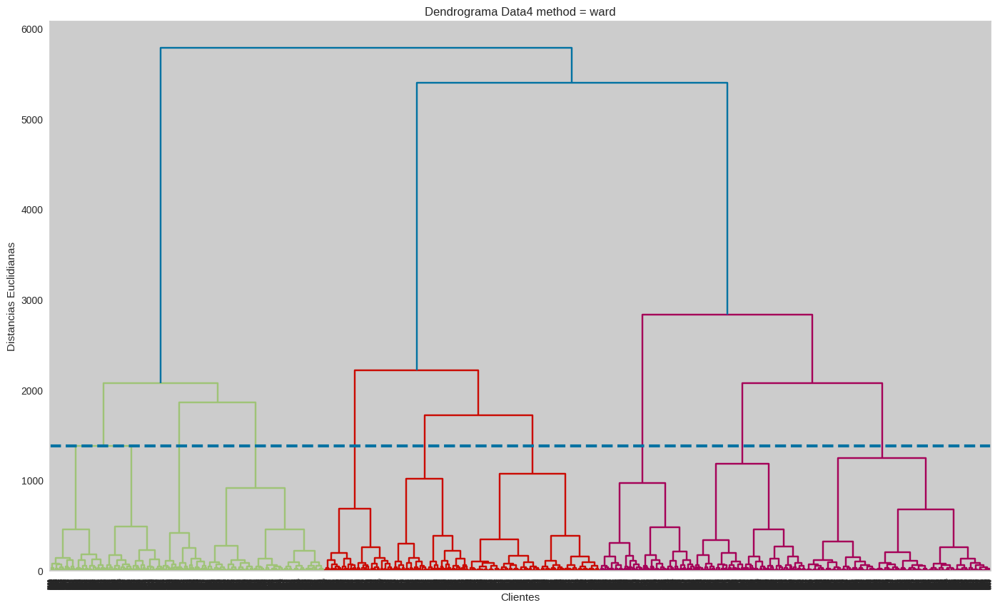

1104.973317445235


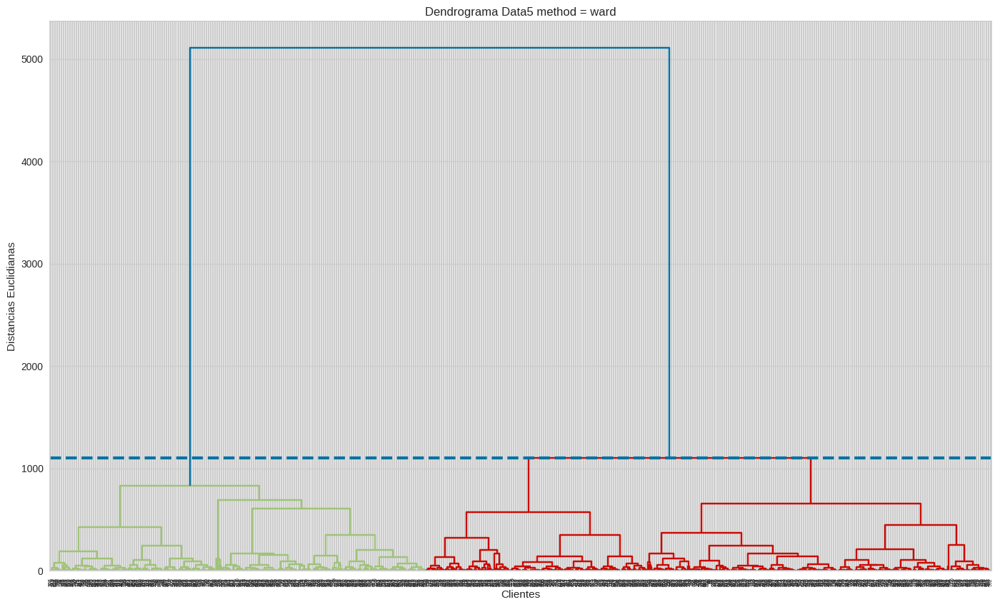

1462.2354630063257


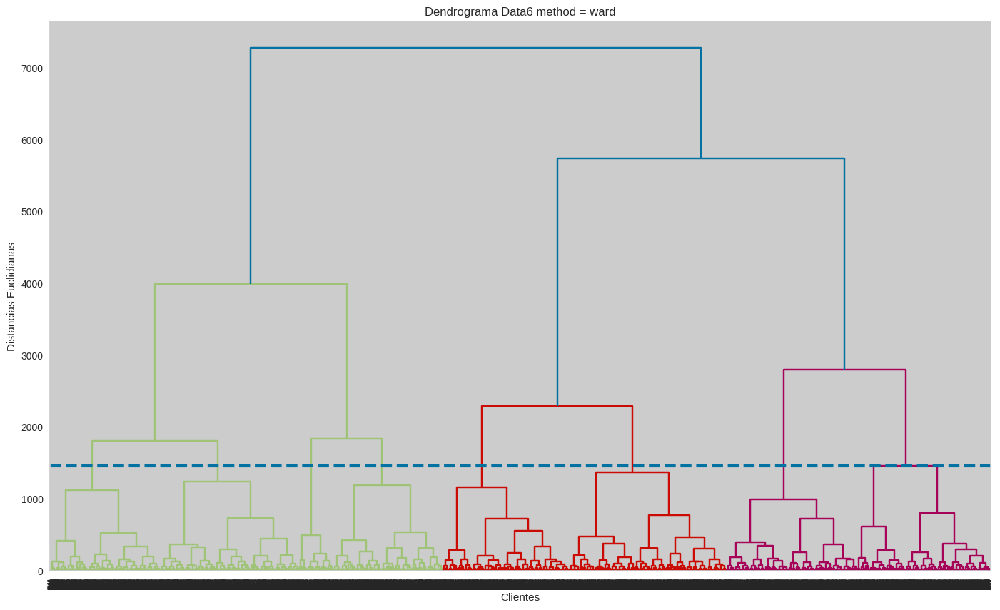

In [33]:
methods=['ward']
data_with_n_clusters={}    
for i,data in datos.items():
    #if i>0:
    #    break
    k_for_data={}
    for method in methods:
        n_cluster=dendrograma(data,i,method)
        k_for_data[method]=n_cluster
    data_with_n_clusters[i]=k_for_data
   

In [34]:
print(data_with_n_clusters)

{0: {'ward': 3}, 1: {'ward': 4}, 2: {'ward': 17}, 3: {'ward': 9}, 4: {'ward': 2}, 5: {'ward': 8}}


In [35]:
from sklearn.metrics import silhouette_score

In [36]:
def silhouette(data,i=0):
    X = data.iloc[:, [0, 1]].values
    # Análisis de Silhouette para diferentes números de clústeres
    silhouette_coefficients = []

    # Consideramos desde 2 hasta un límite razonable dado el tamaño de los datos
    for k in range(2, 20):
        clusters = sch.fcluster(sch.linkage(X, method='ward'), k, criterion='maxclust')
        score = silhouette_score(X, clusters)
        silhouette_coefficients.append(score)

    # Graficar los coeficientes de Silhouette para diferentes valores de k
    plt.figure(figsize=(10, 7))
    plt.plot(range(2, 20), silhouette_coefficients)
    plt.xticks(range(2, 20))
    plt.xlabel(f"Número de Clústeres ")
    plt.ylabel("Coeficiente de Silhouette")
    plt.title(f"Comprobación de Silhouette Data{i+1}")
    plt.show()
    

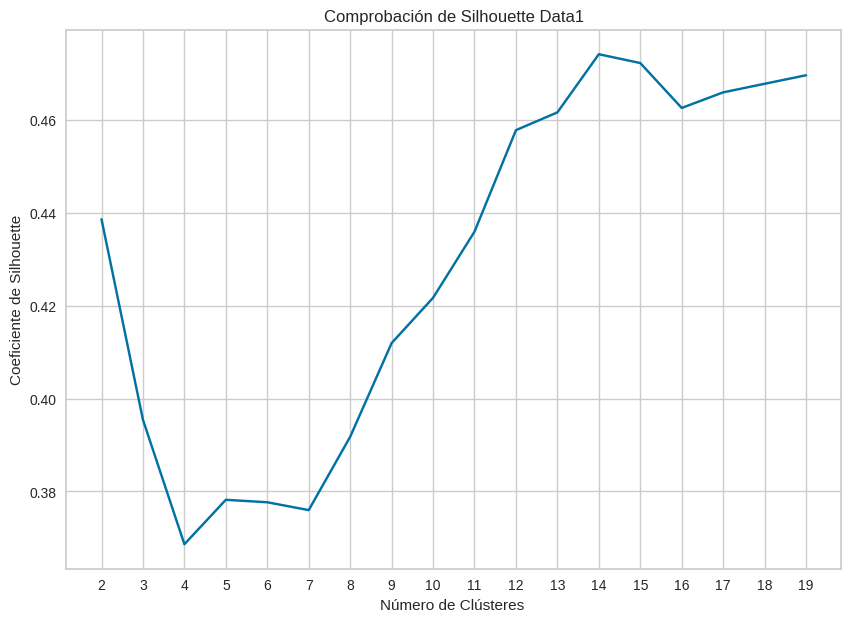

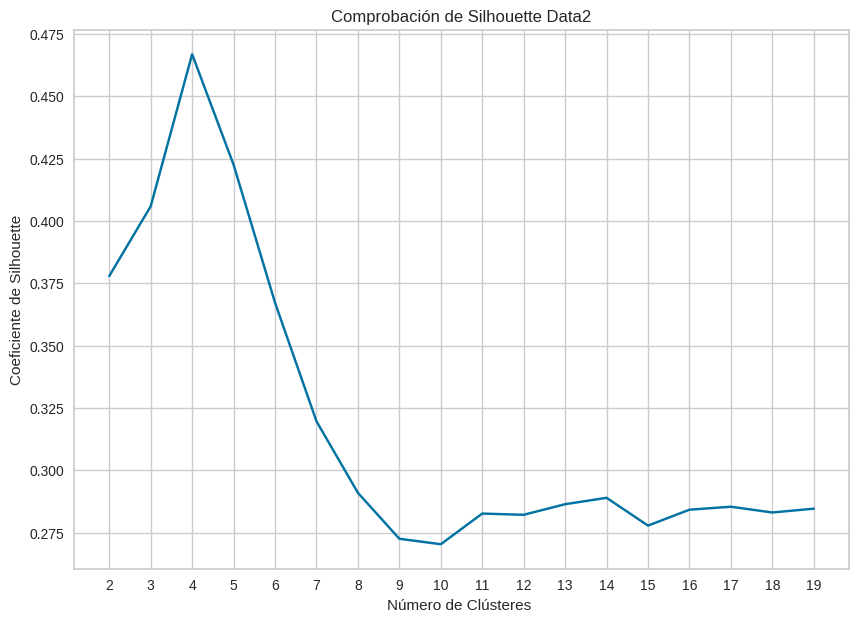

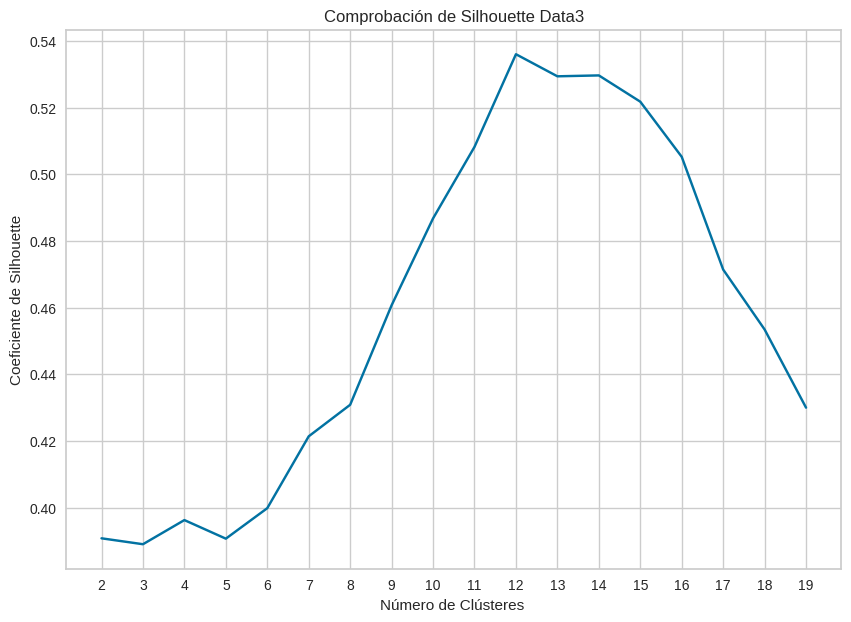

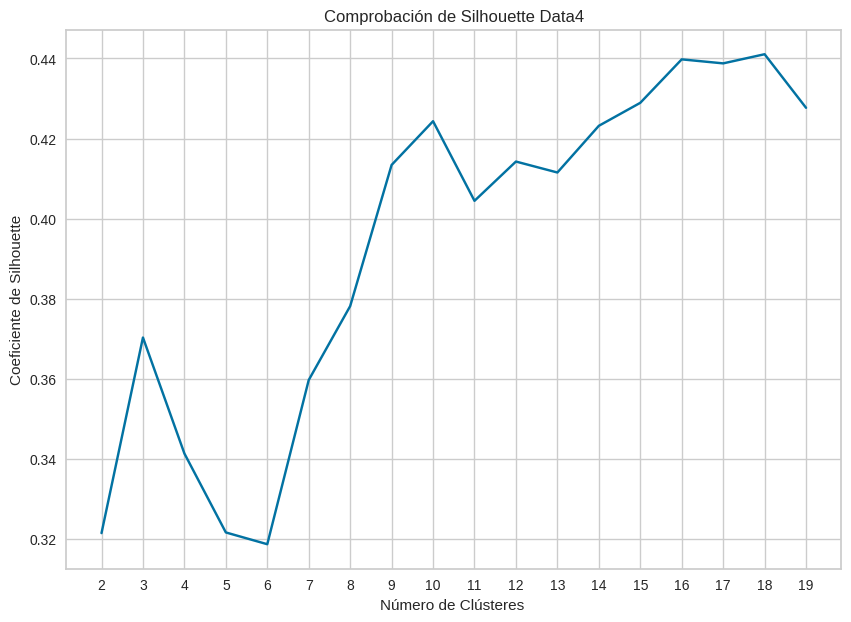

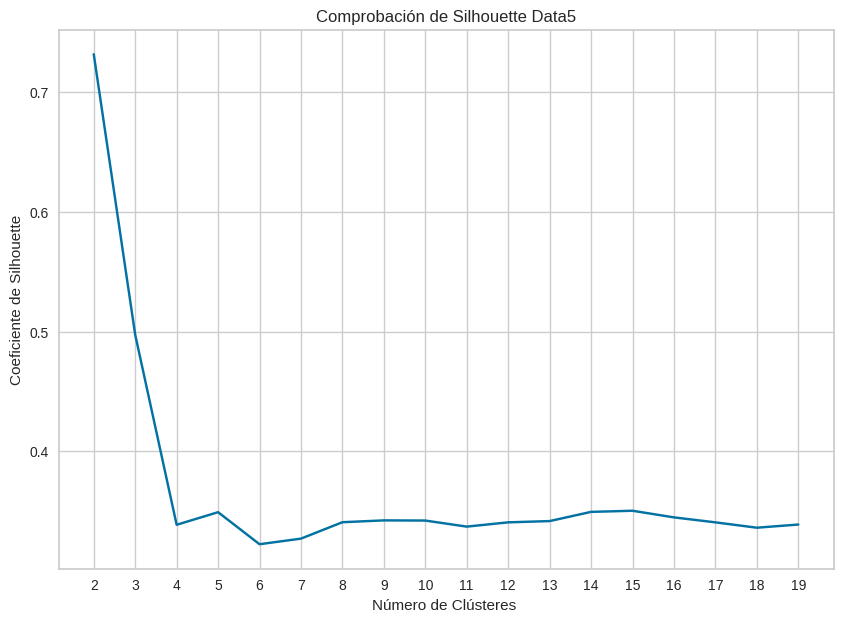

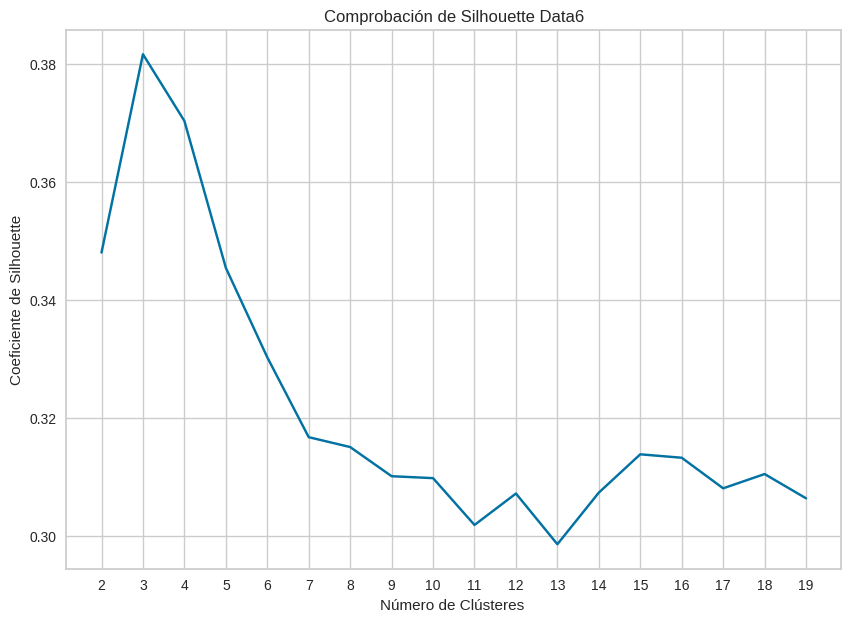

In [37]:
for i,data in datos.items():
    silhouette(data,i)

In [38]:
from sklearn.cluster import AgglomerativeClustering

In [39]:
def plot_hierarchy(data,n_clusters,i=0, method='',aglomethe=False):
    
    X = data.iloc[:, [0, 1]].values
    
    methods_avaliabled={'single','complete','average','weighted','centroid','median','ward'}
    
    if aglomethe:
        hc = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='ward')
        labels = hc.fit_predict(X)
    else:
        
        linked=sch.linkage(X, method=method) if method in methods_avaliabled else sch.linkage(X, method='ward')
        labels = sch.fcluster(linked, n_clusters, criterion='maxclust')

    # Graficar los resultados
    unique_labels = set(labels)
    #colors = [plt.cm.viridis(each) for each in np.linspace(0, 1, len(unique_labels))]
    #colors = plt.cm.Set3(np.linspace(0, 1, len(unique_labels)))
    colors_palettes = ['Set3', 'Set2', 'Pastel2']
    colors = []
    for palette in colors_palettes:
        colors.extend(plt.get_cmap(palette).colors)
    colors = np.array(colors)
    
    for k, col in zip(unique_labels, colors):
        if k == -1:
            # Color negro para ruido.
            col = 'k'
        
        class_member_mask = (labels == k)
        xy = data[class_member_mask]
        plt.plot(xy['x'], xy['y'], 'o', markerfacecolor=col, markeredgecolor='k', markersize=6, label=f'Cluster {k}' if k != -1 else 'Ruido')
    
    plt.title(f'Agrupamiento hierarchy {method} para el Data{i} \n con n_clusters óptimo {n_clusters} \n aglomethe {aglomethe}')
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.show()

def es_iterable(objeto):
    try:
        iter(objeto)
        return True
    except TypeError:
        return False
    
def plot_all_strategy_hierarchy(data,i,method={}):
    for key,n_clusters in method.items():
        #print(key,eps)
        if not(es_iterable(n_clusters)):
            n_clusters=[n_clusters]
        for num_cluster in n_clusters:
            print(key,num_cluster)
            plot_hierarchy(data,n_clusters=num_cluster,i=i,method=key)
            #plot_hierarchy(data,n_clusters=n_cluster,i=i,method=key,aglomethe=True)

In [40]:
data_with_n_clusters={}    
n_clusters_selected=[[5],[4],[12],[3],[2],[3,4]]
for i,n_cluster in enumerate(n_clusters_selected):
    k_for_data={'selected_visual_codo':n_cluster}
    data_with_n_clusters[i]=k_for_data

n_clusters_selected=[[5, 14], [4], [4, 12], [3, 10, 18], [2], [3]]
for i,n_cluster in enumerate(n_clusters_selected):
    data_with_n_clusters[i]['selected_visual_silhouette']=n_cluster
    #data_with_n_clusters[i]=k_for_data

n_clusters_selected=[[], [], [], [2], [3], [2]]
for i,n_cluster in enumerate(n_clusters_selected):
    data_with_n_clusters[i]['real_num_cluster']=n_cluster
    
print(data_with_n_clusters)

{0: {'selected_visual_codo': [5], 'selected_visual_silhouette': [5, 14], 'real_num_cluster': []}, 1: {'selected_visual_codo': [4], 'selected_visual_silhouette': [4], 'real_num_cluster': []}, 2: {'selected_visual_codo': [12], 'selected_visual_silhouette': [4, 12], 'real_num_cluster': []}, 3: {'selected_visual_codo': [3], 'selected_visual_silhouette': [3, 10, 18], 'real_num_cluster': [2]}, 4: {'selected_visual_codo': [2], 'selected_visual_silhouette': [2], 'real_num_cluster': [3]}, 5: {'selected_visual_codo': [3, 4], 'selected_visual_silhouette': [3], 'real_num_cluster': [2]}}


selected_visual_codo 5


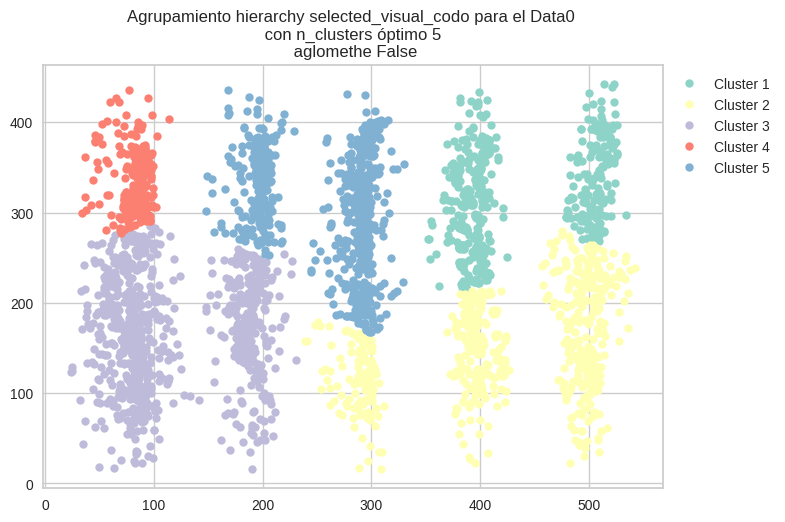

selected_visual_silhouette 5


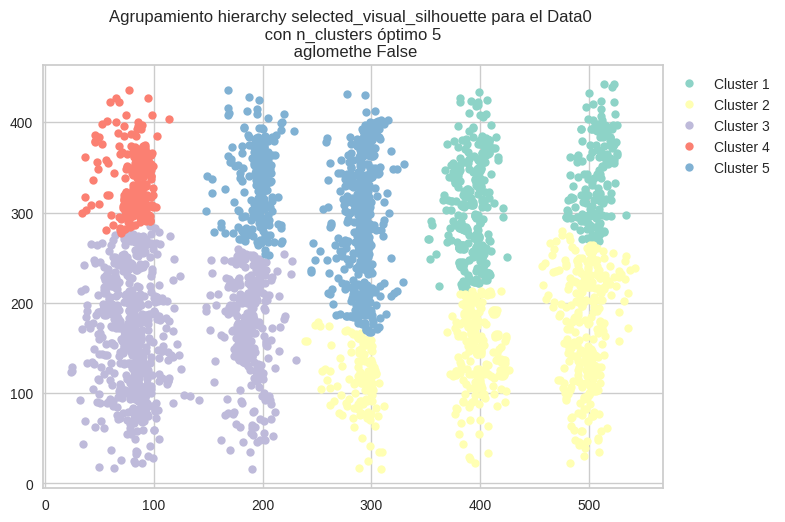

selected_visual_silhouette 14


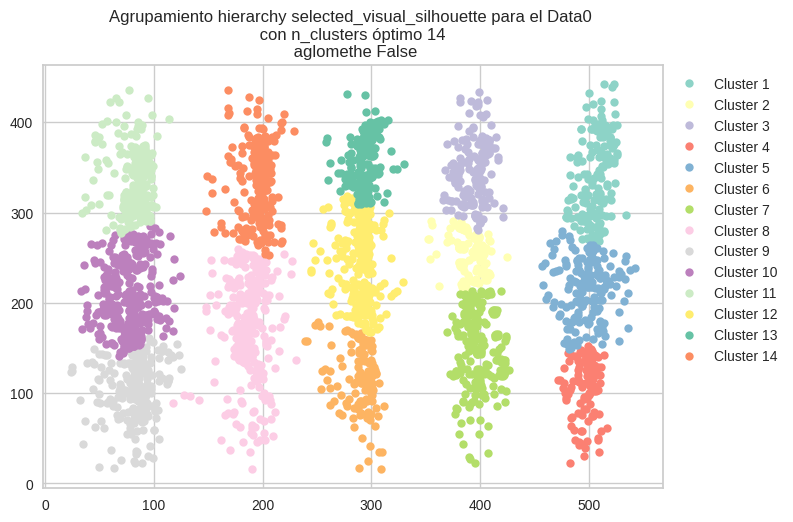

selected_visual_codo 4


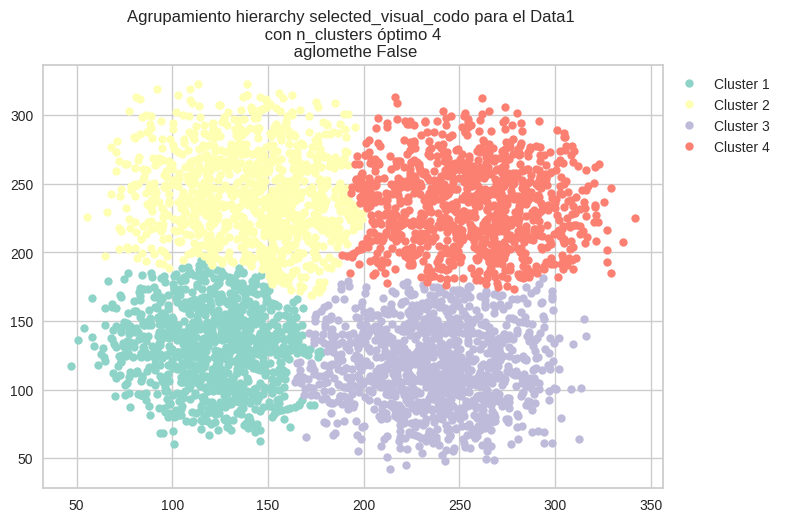

selected_visual_silhouette 4


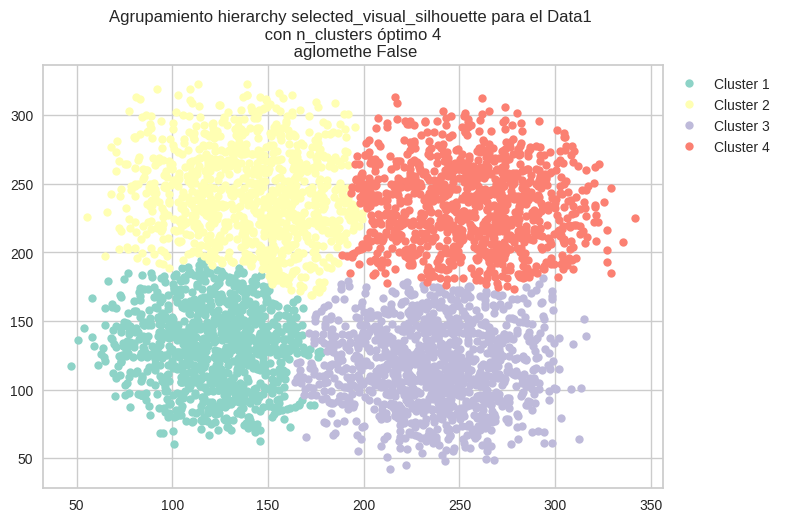

selected_visual_codo 12


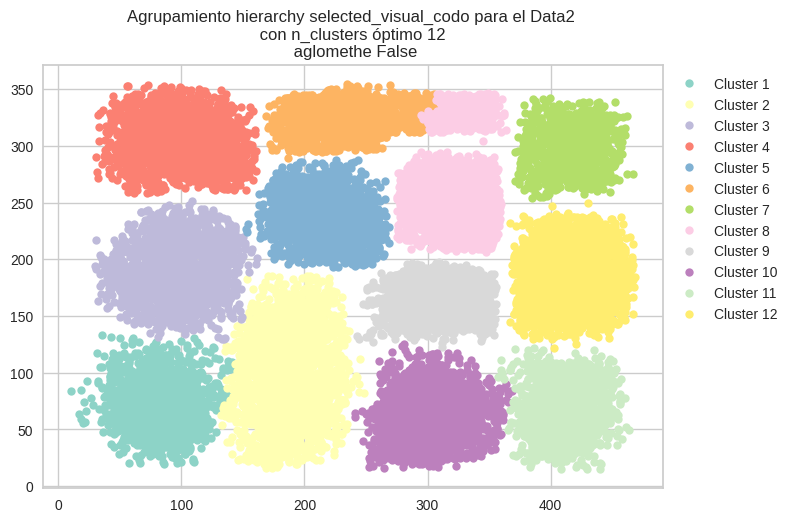

selected_visual_silhouette 4


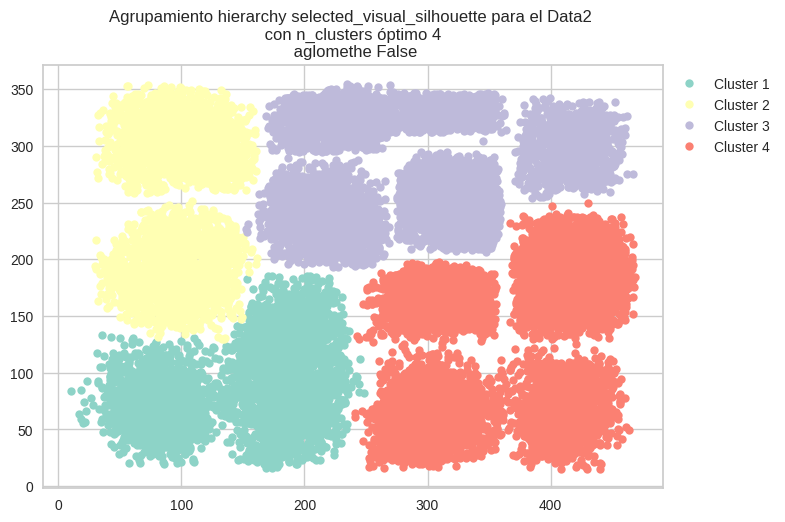

selected_visual_silhouette 12


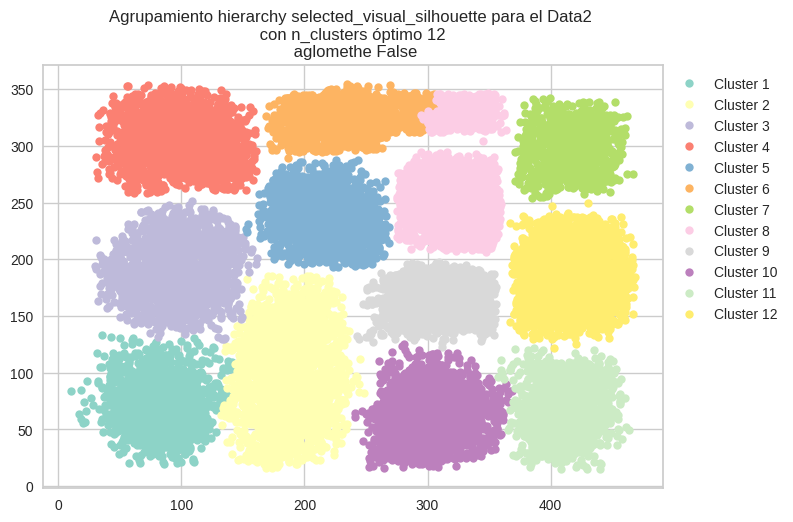

selected_visual_codo 3


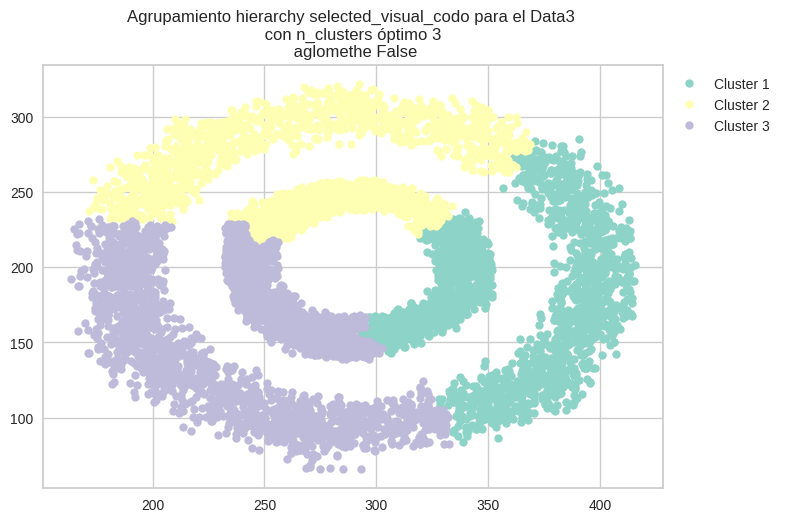

selected_visual_silhouette 3


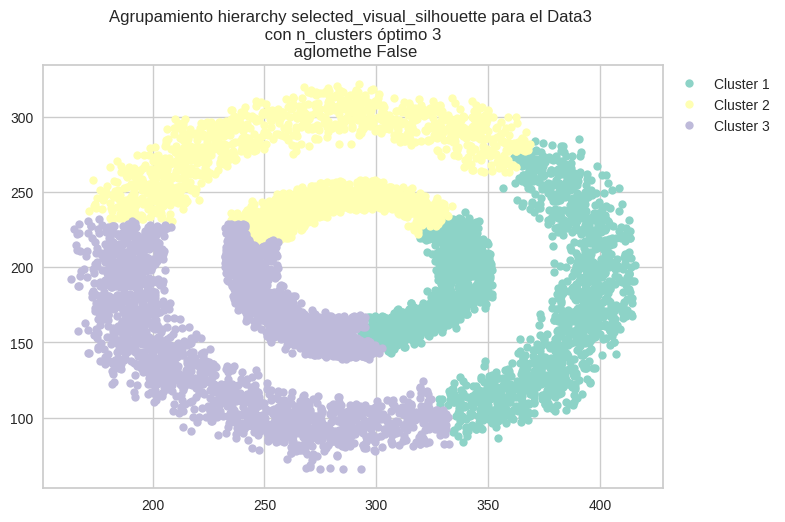

selected_visual_silhouette 10


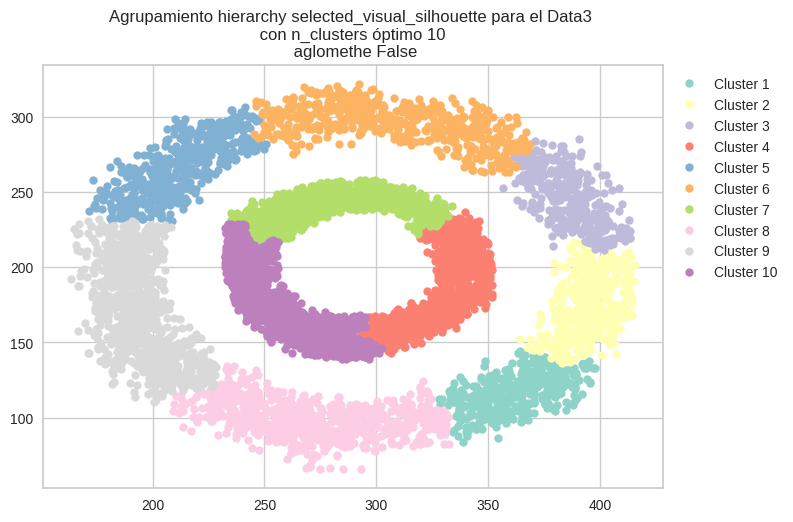

selected_visual_silhouette 18


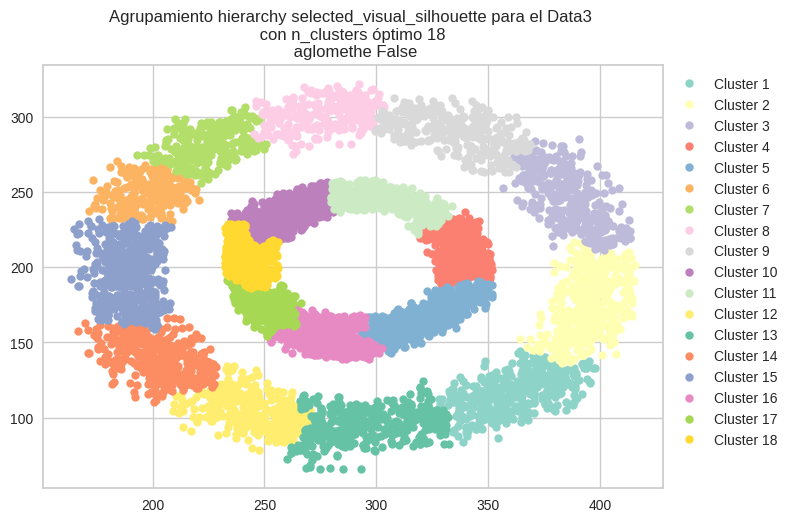

real_num_cluster 2


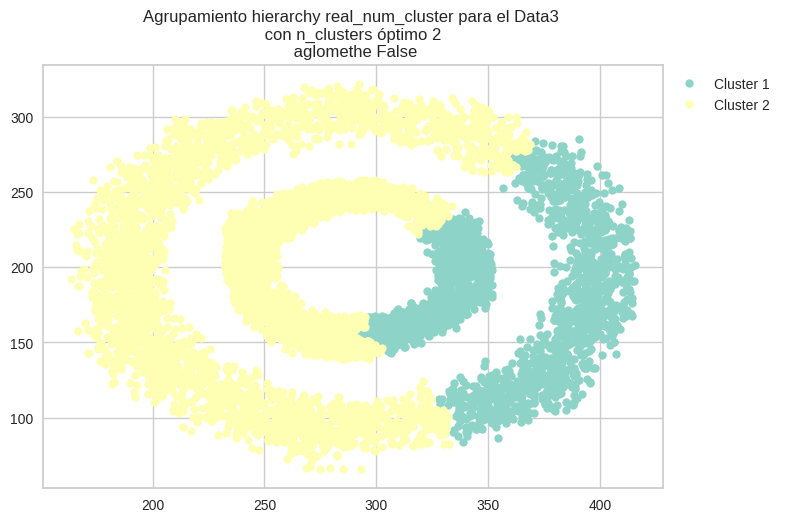

selected_visual_codo 2


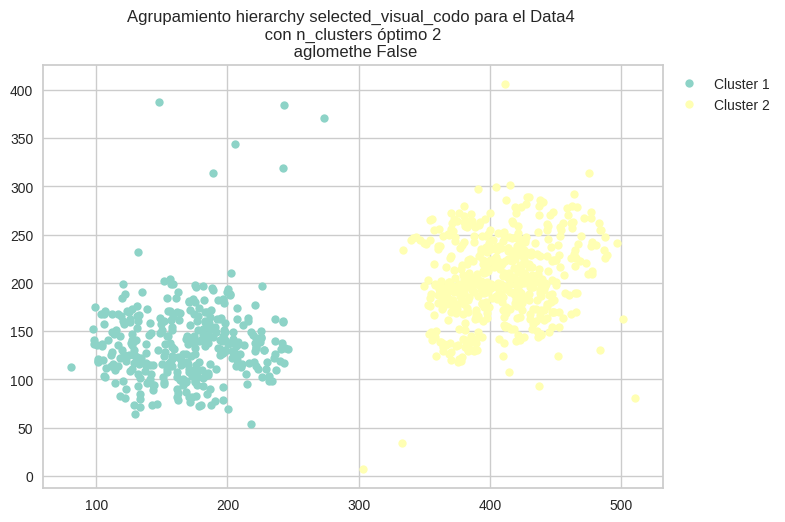

selected_visual_silhouette 2


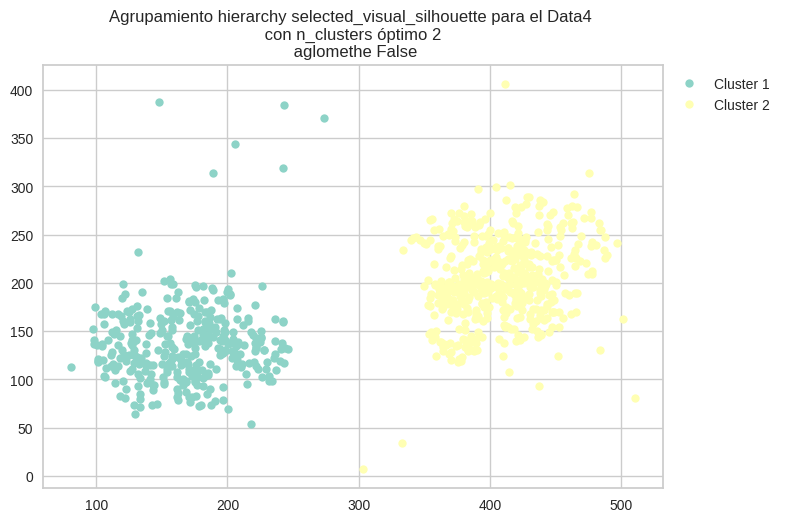

real_num_cluster 3


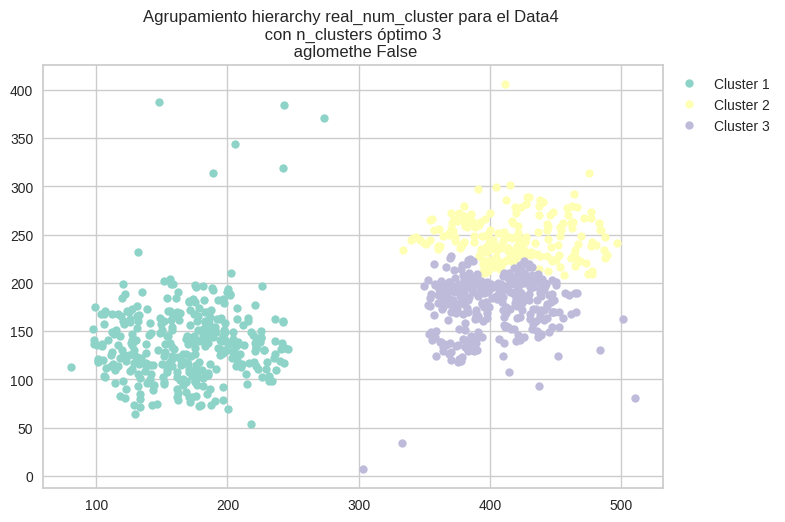

selected_visual_codo 3


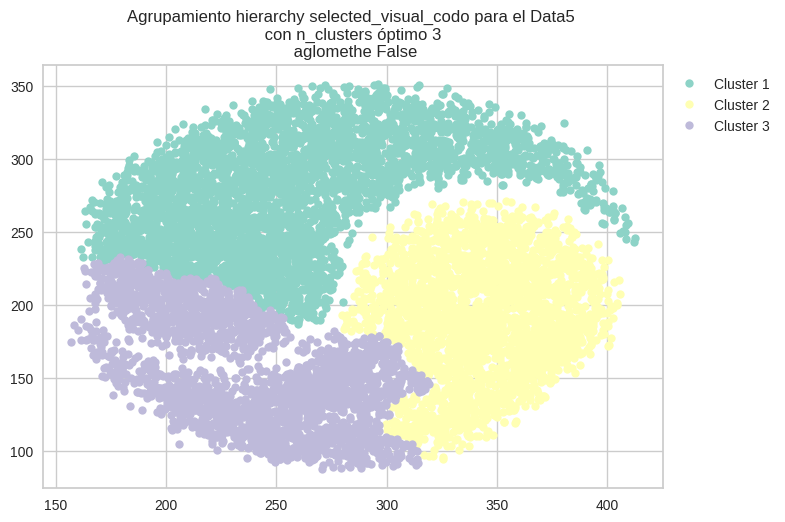

selected_visual_codo 4


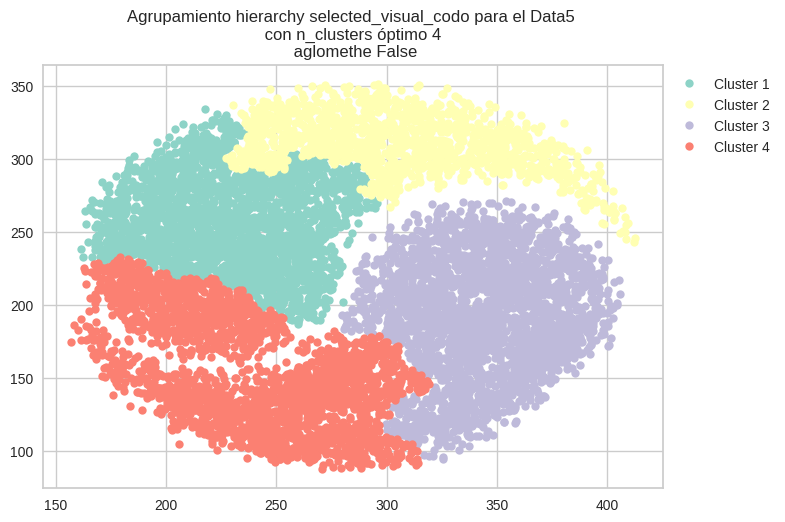

selected_visual_silhouette 3


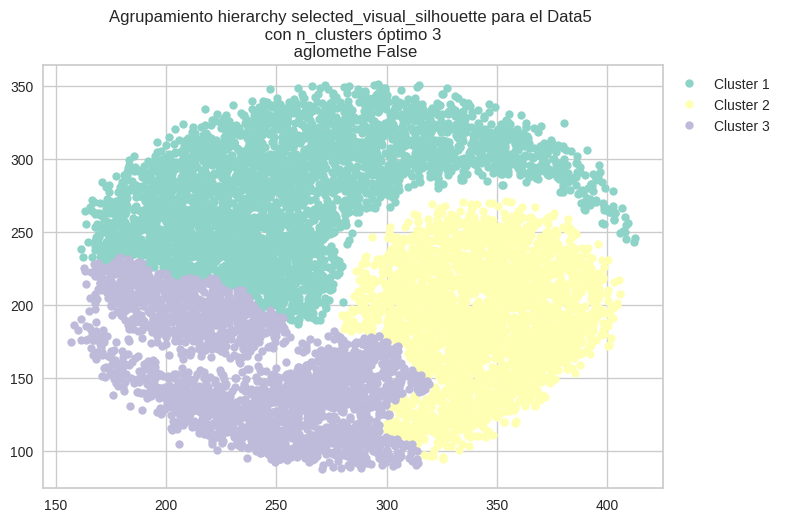

real_num_cluster 2


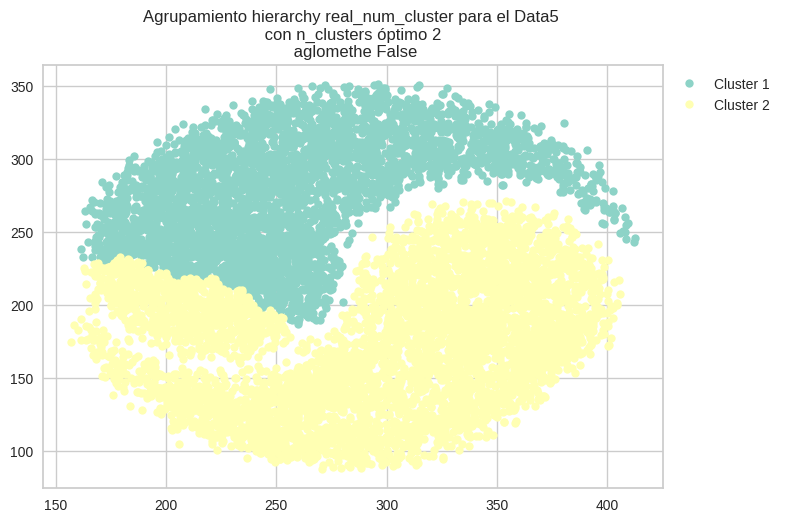

In [41]:
for i,data in datos.items():
    plot_all_strategy_hierarchy(data.copy(), i, method=data_with_n_clusters[i])

23.731820162808447


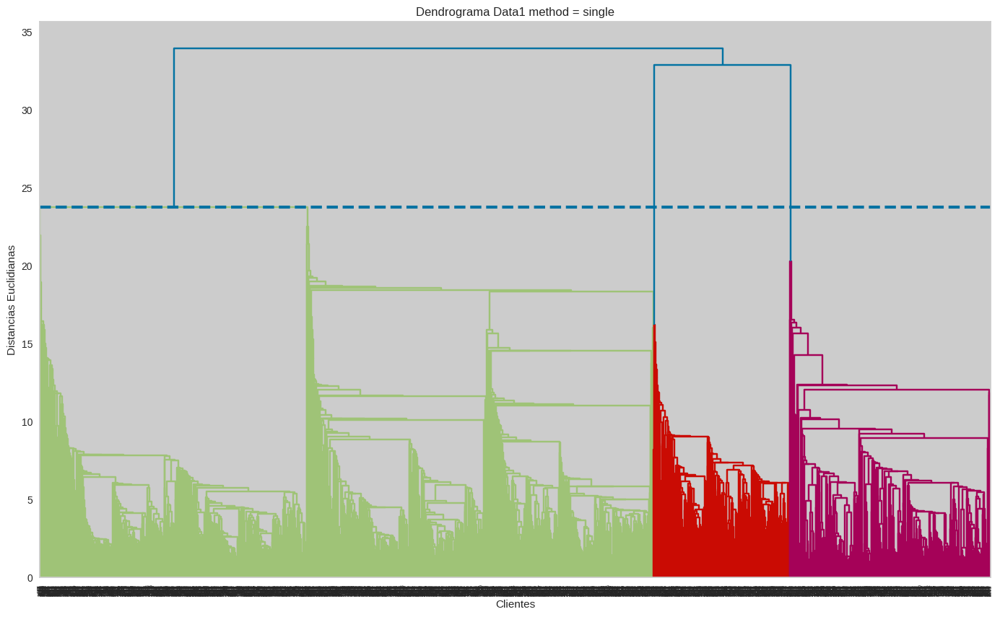

433.4351002209295


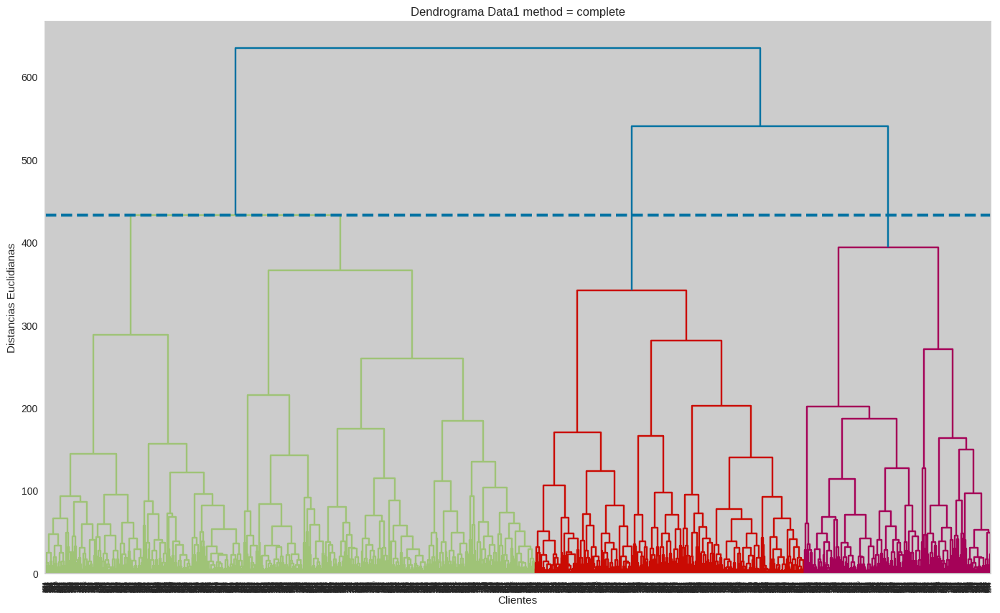

132.14377721566444


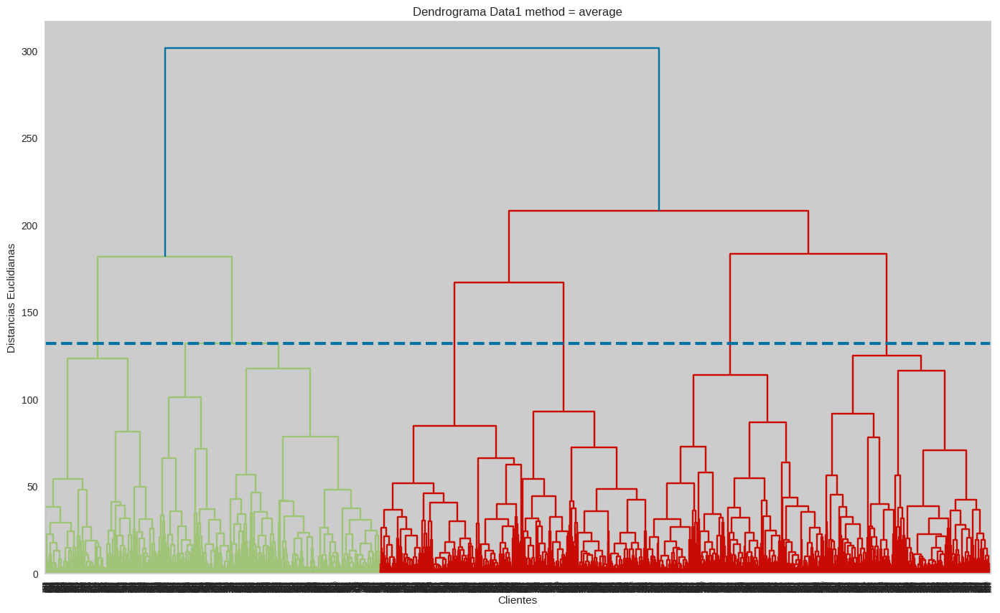

209.11161308136445


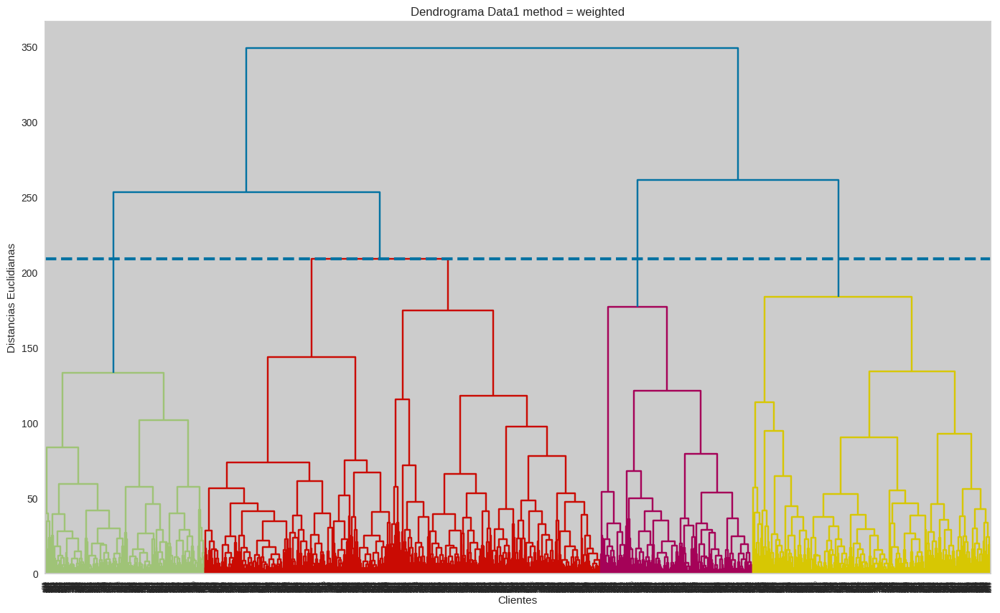

186.23015329779335


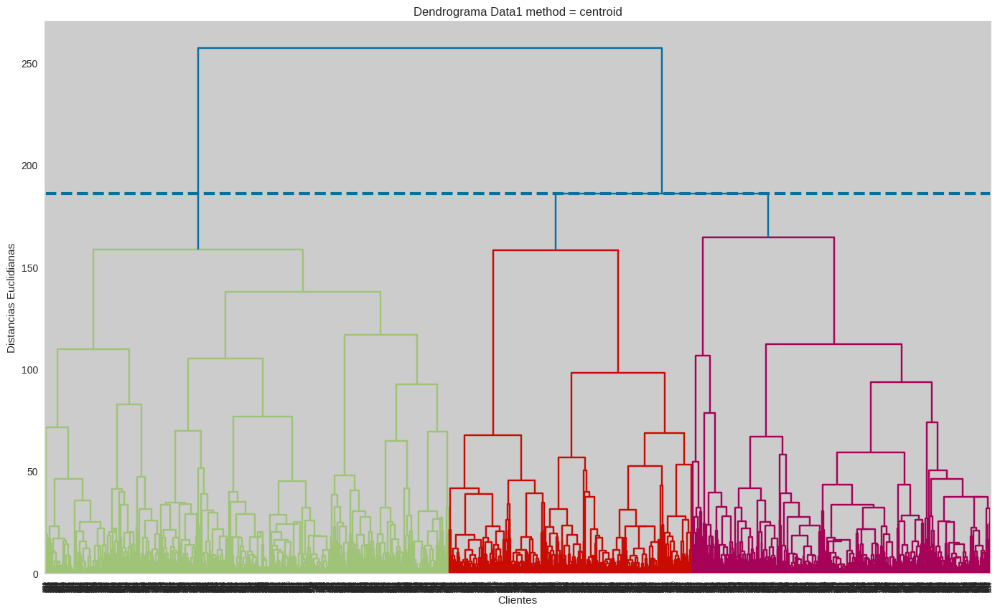

166.379380893864


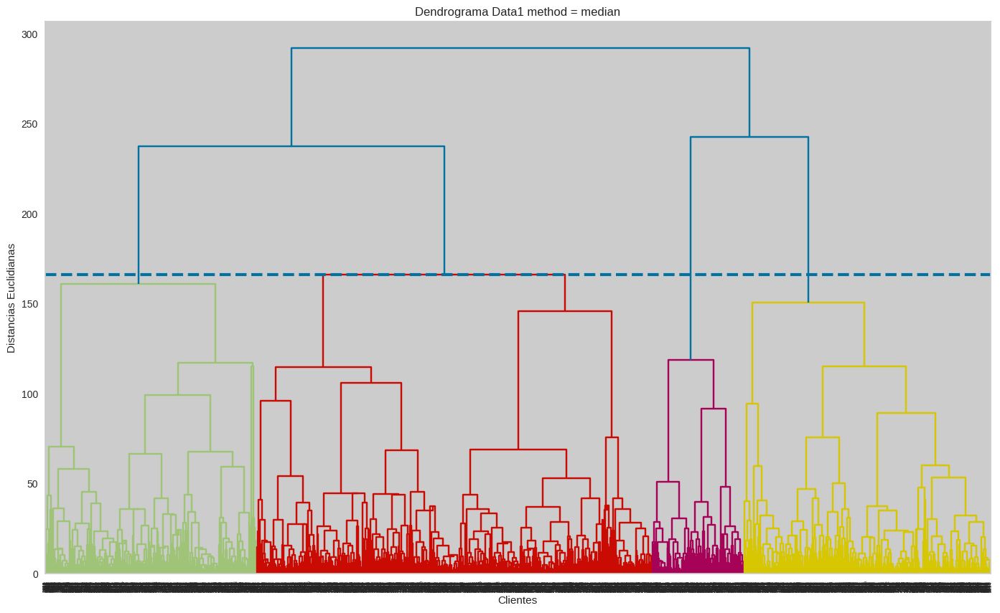

4124.359307073855


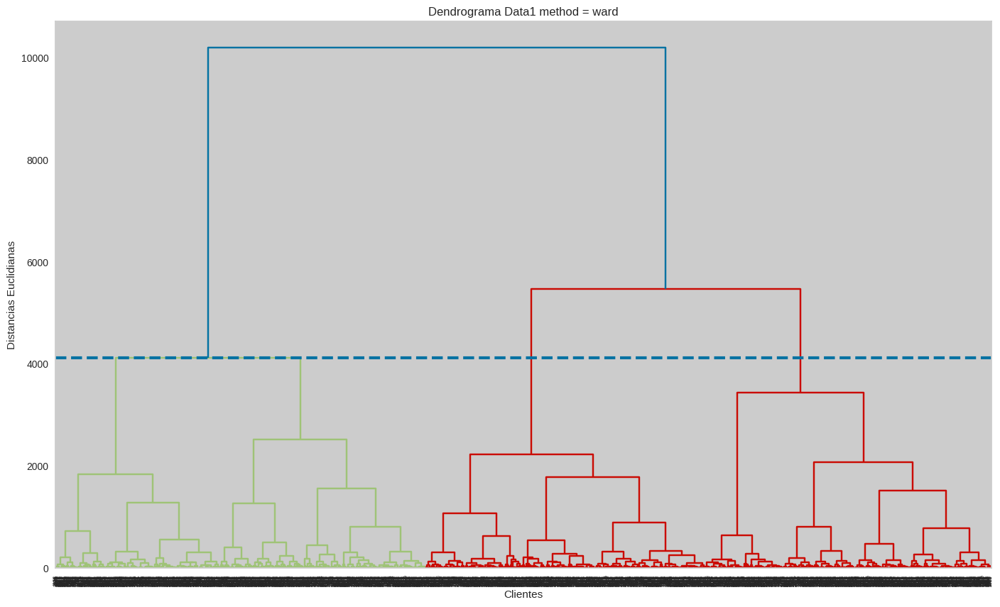

11.652943041623502


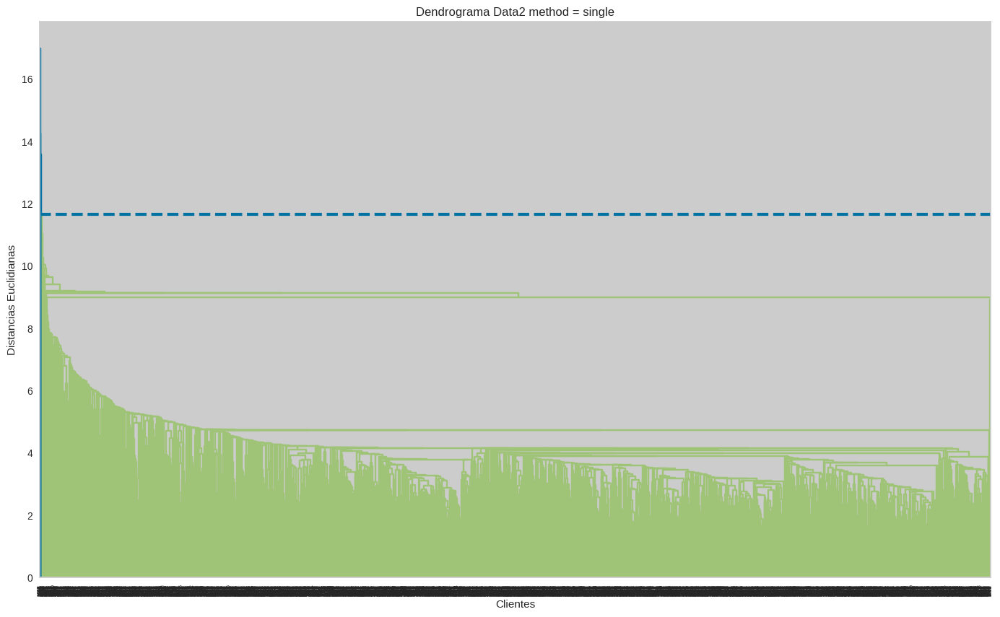

156.04665411903056


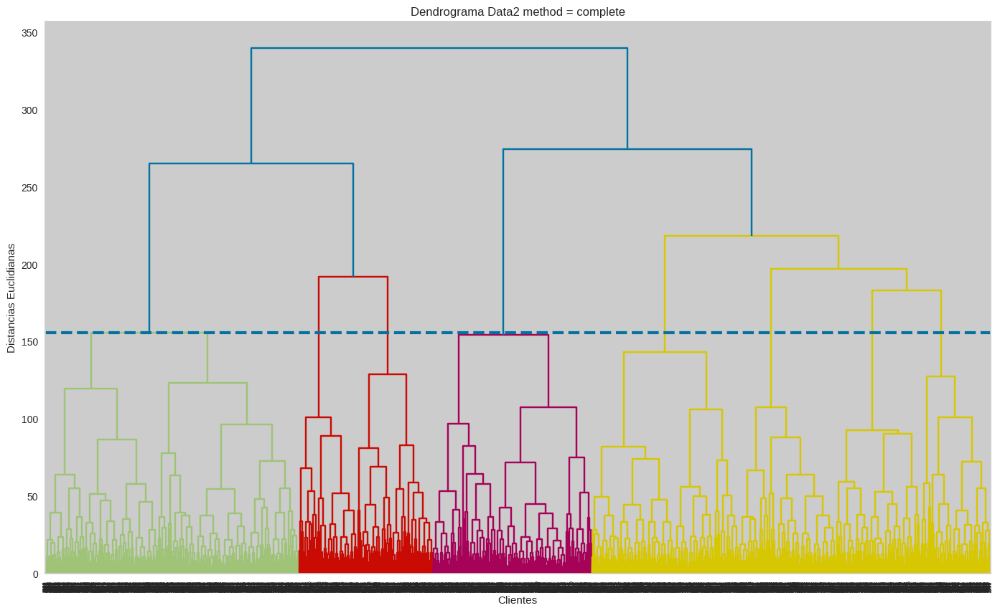

69.32985662302698


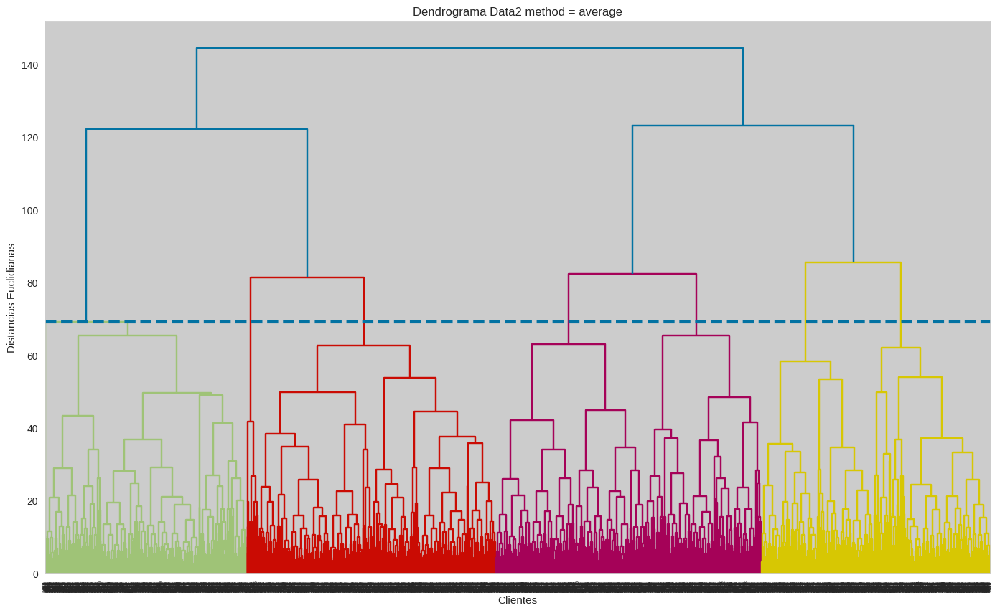

101.42977813800698


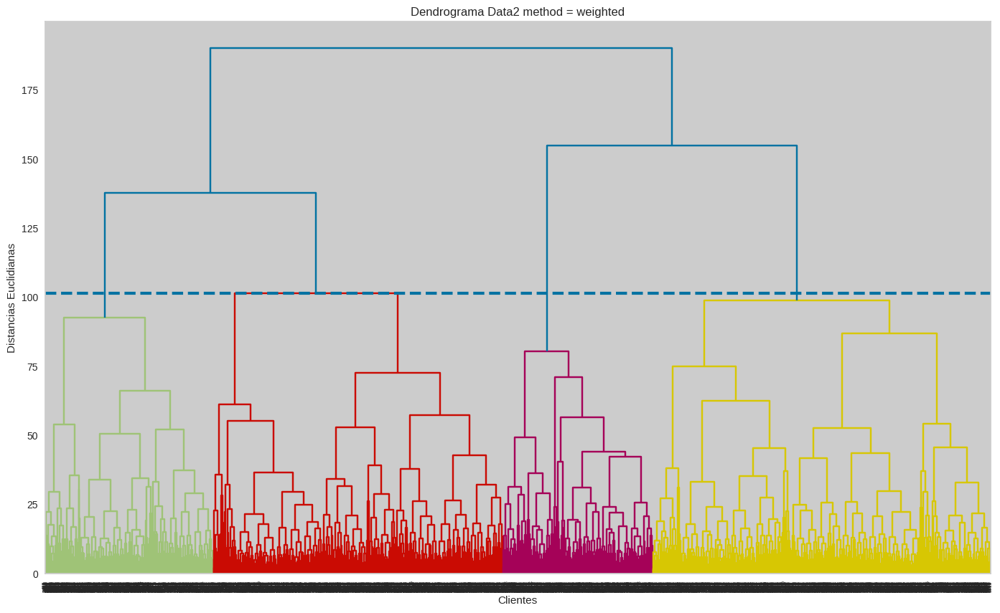

68.6934093043696


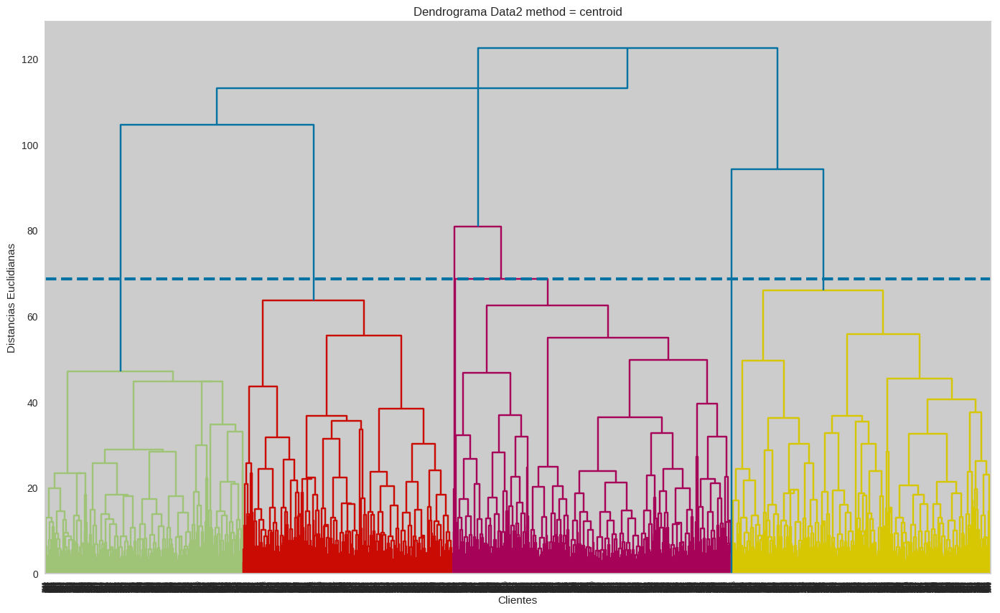

80.24418038822476


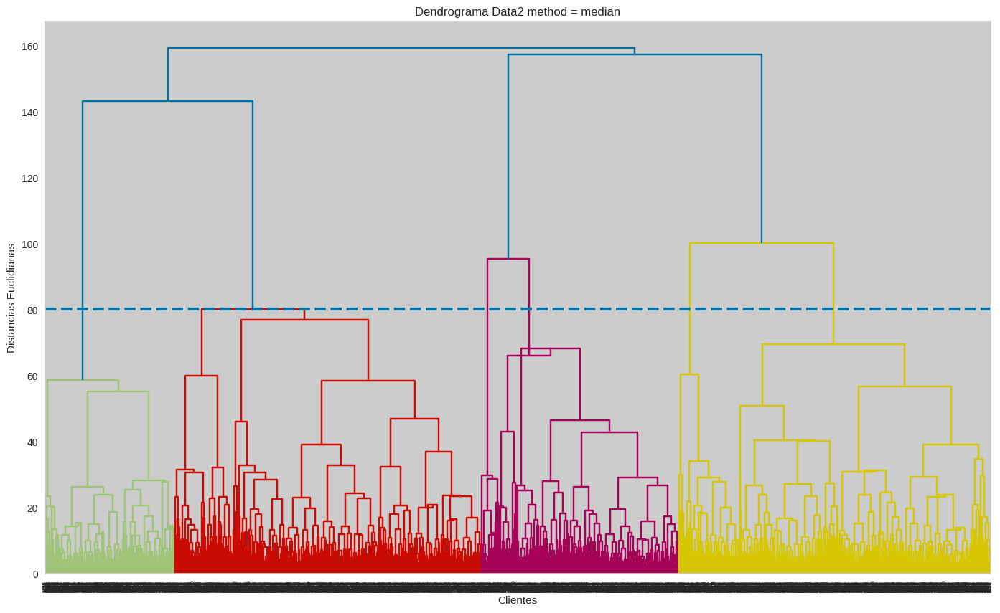

1217.936688705885


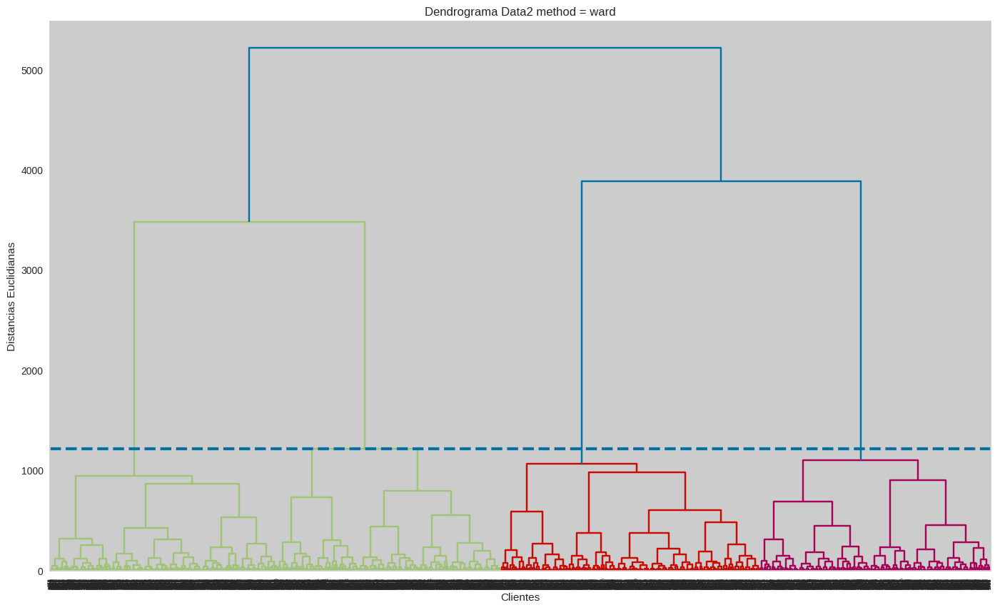

7.262072012904717


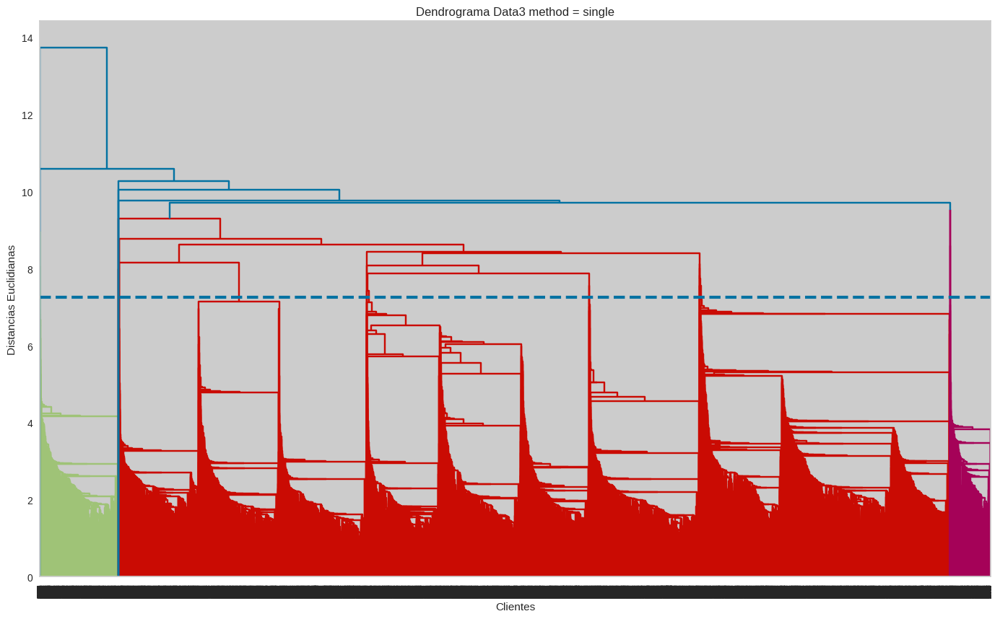

129.83737842093316


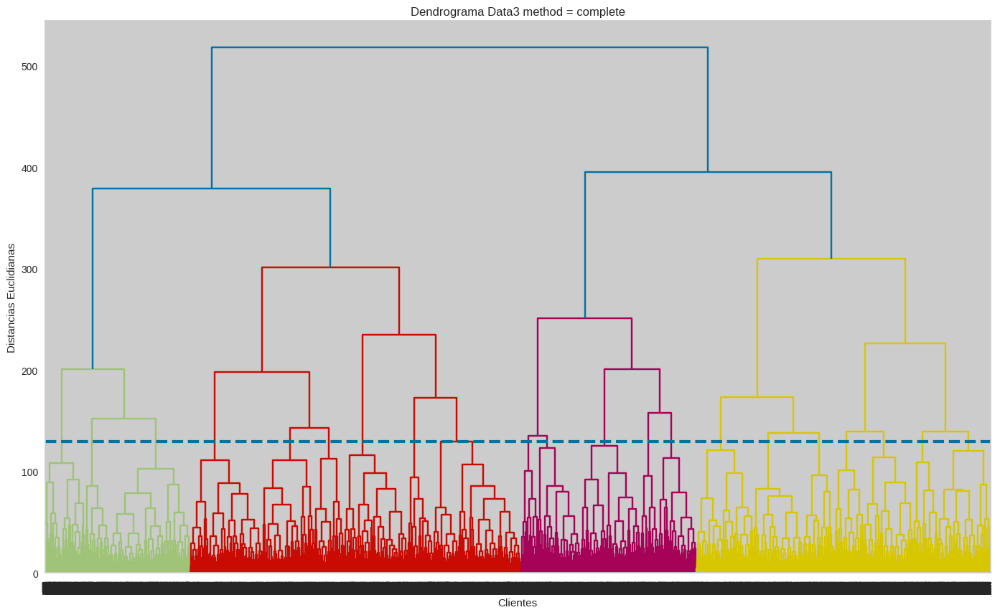

55.875358115345335


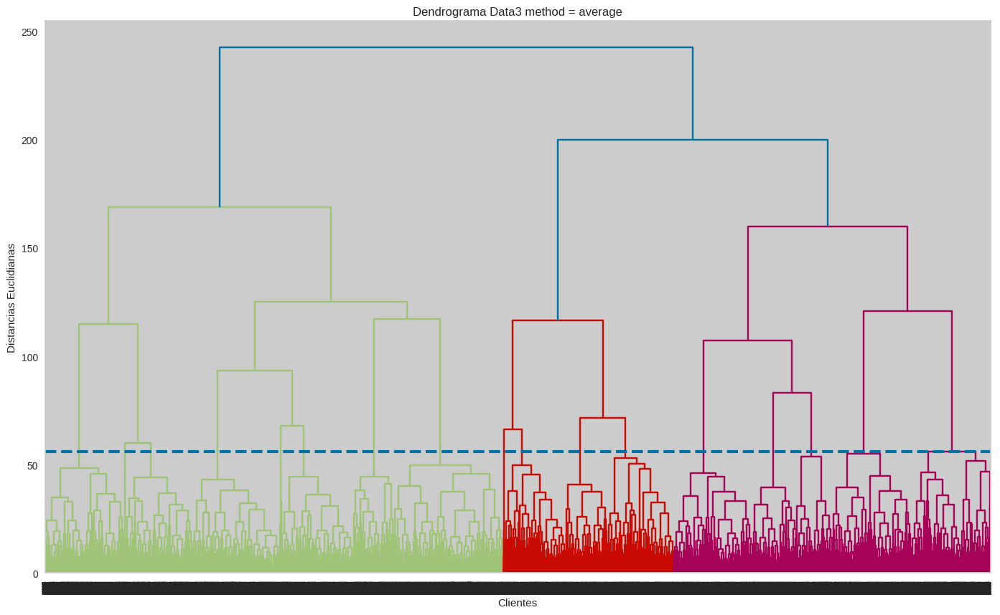

44.13504651557609


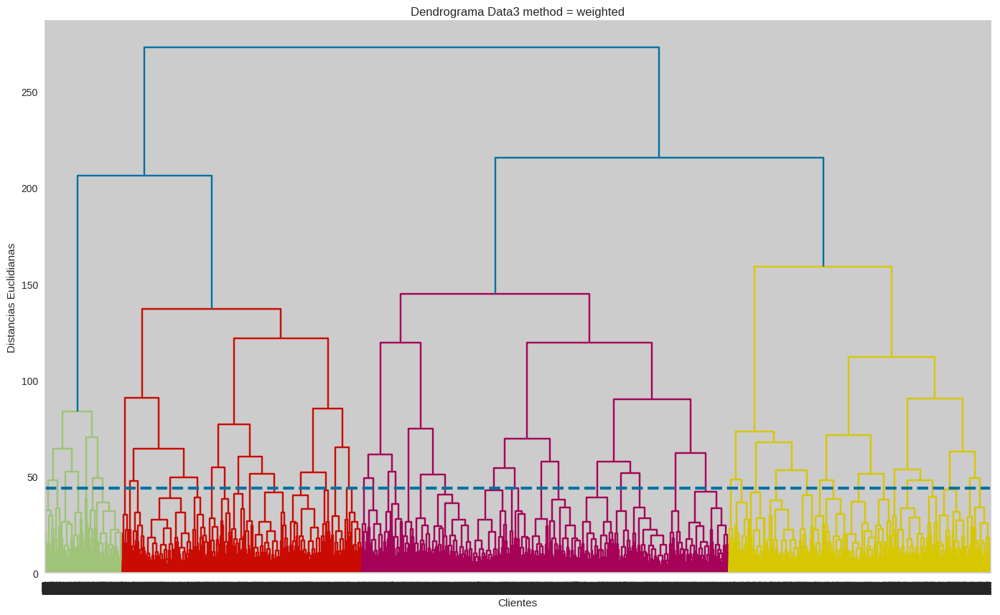

51.31342373035368


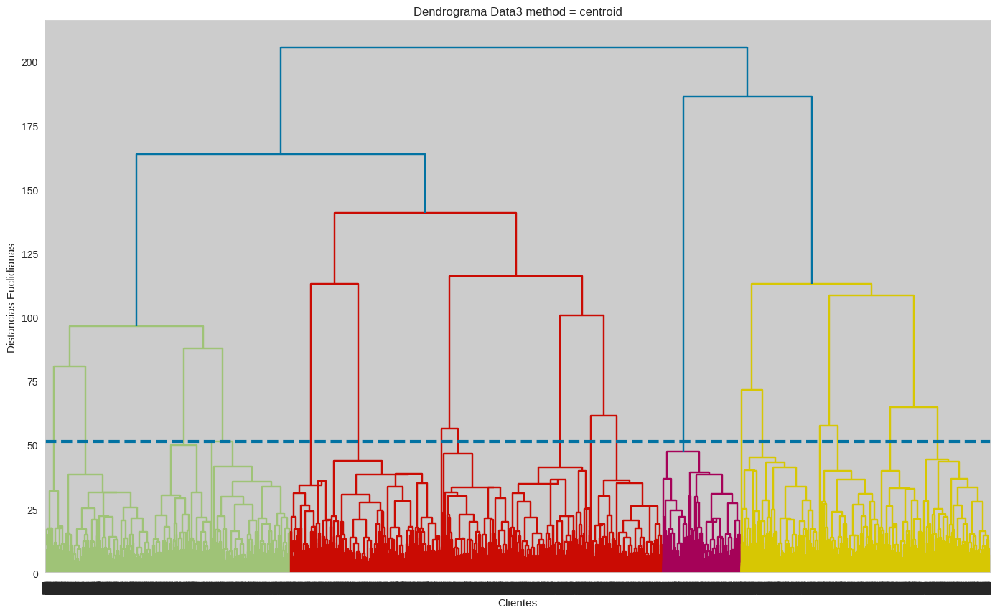

55.03595031015146


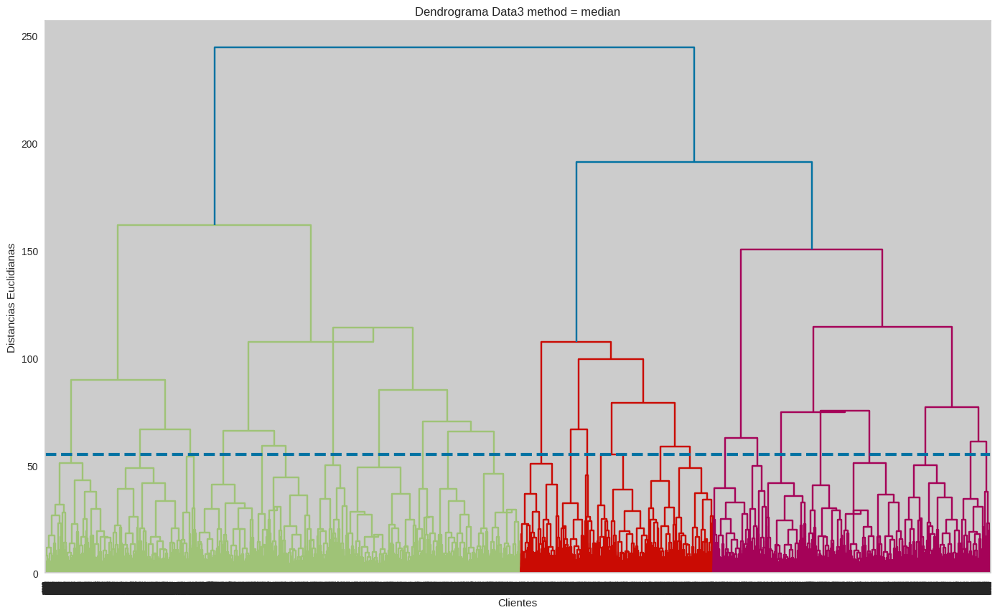

1130.390308497666


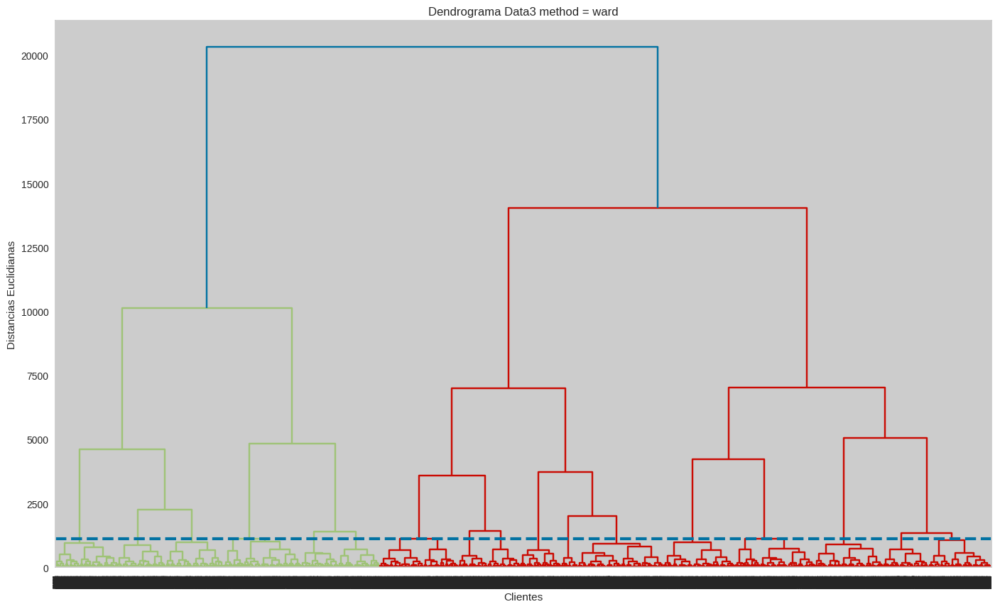

6.20227494284269


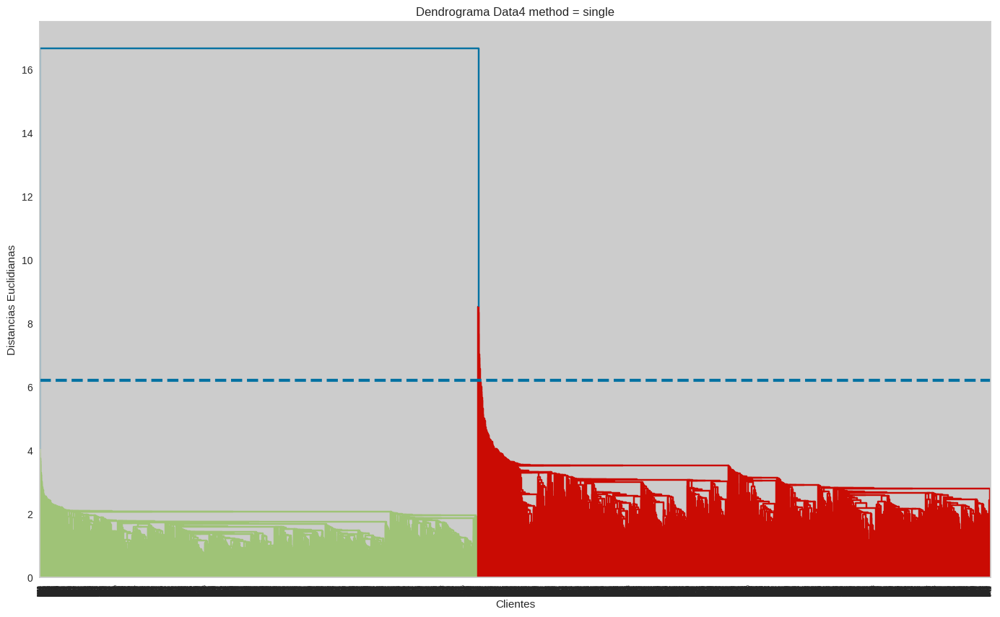

129.88118078029402


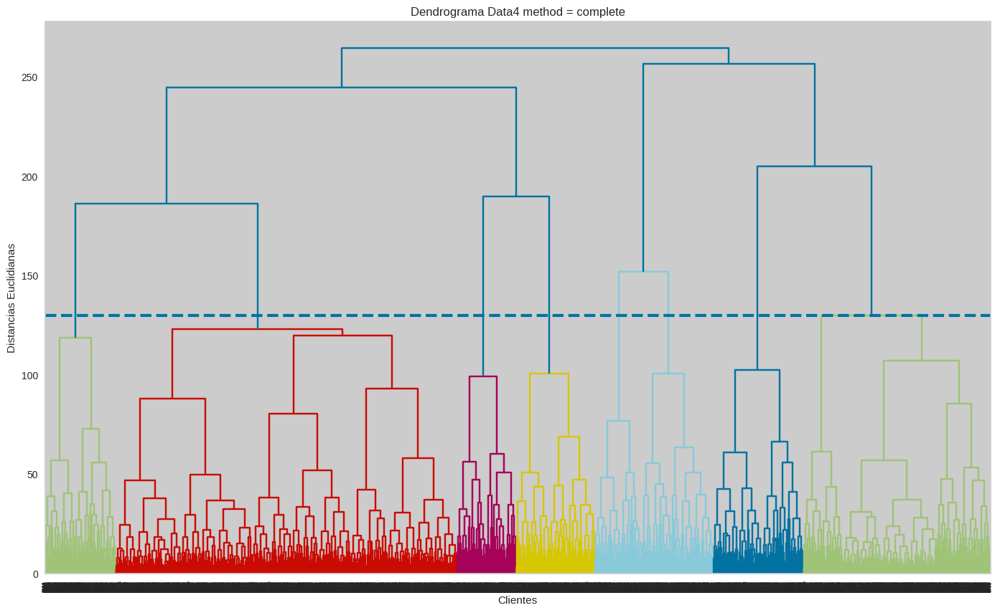

59.44355265803708


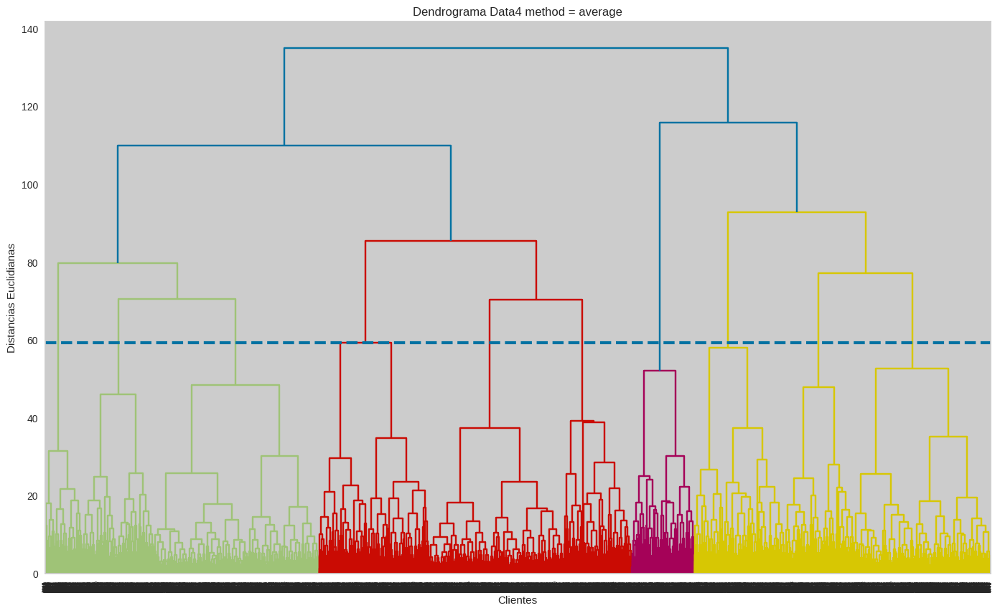

67.94473970574201


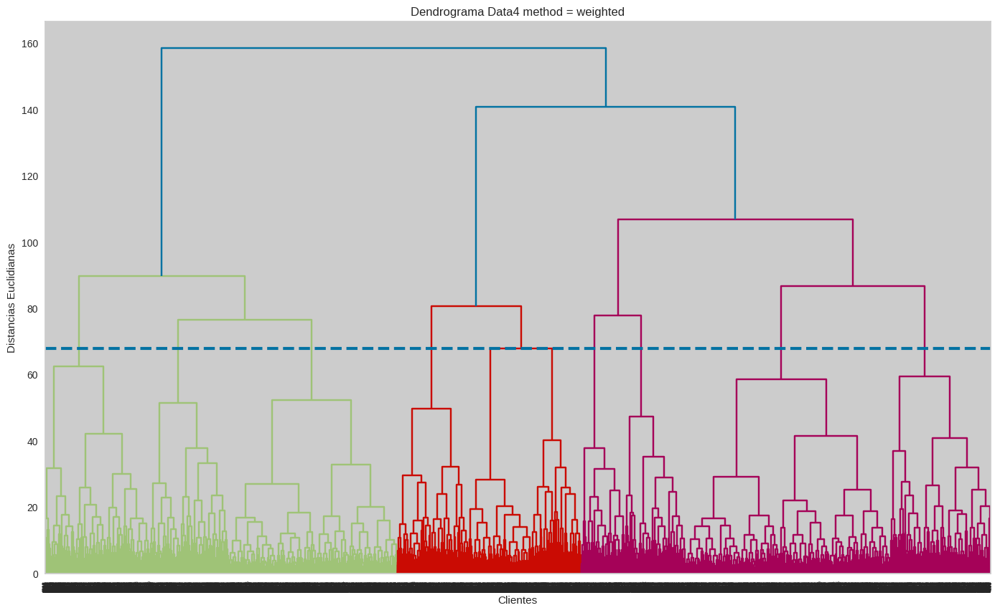

50.264360831563174


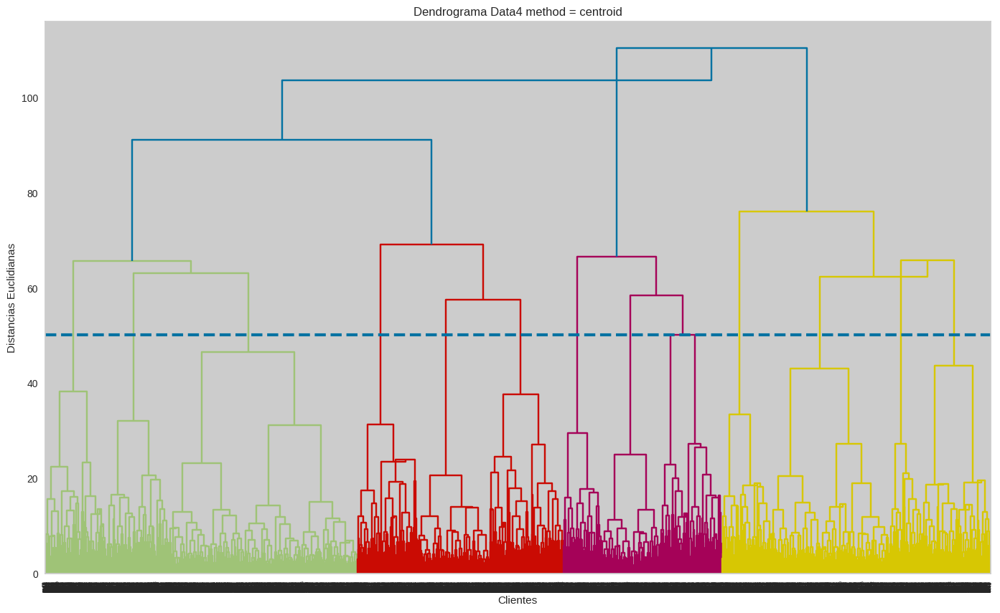

57.16213777403072


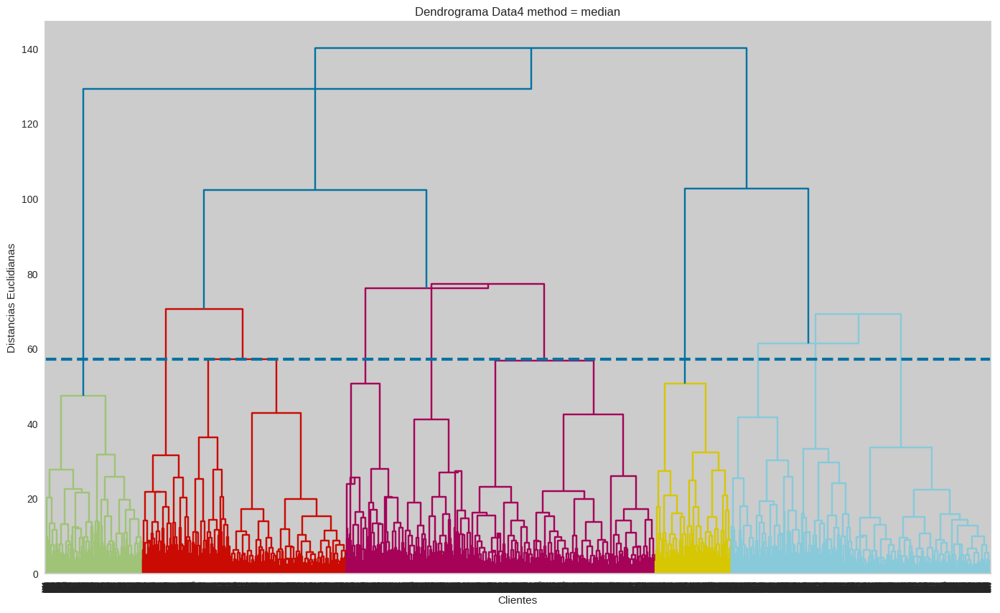

1386.6332789649653


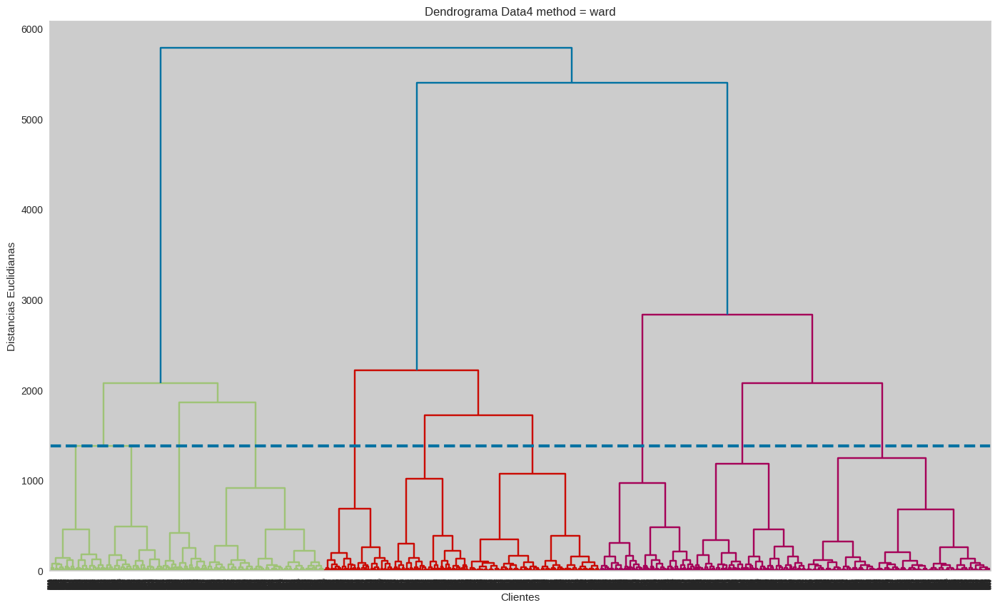

71.8965918320982


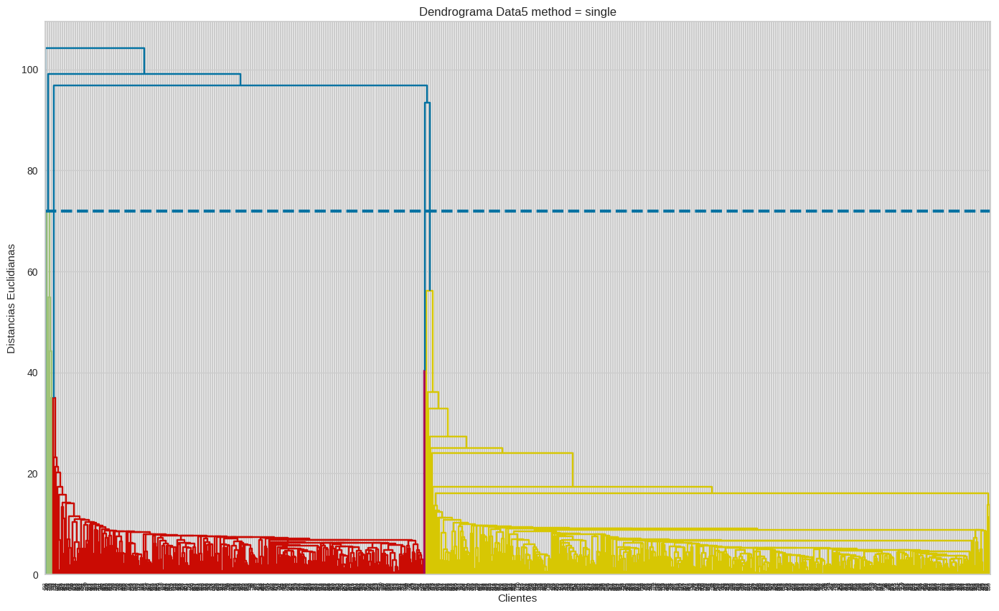

251.912502927274


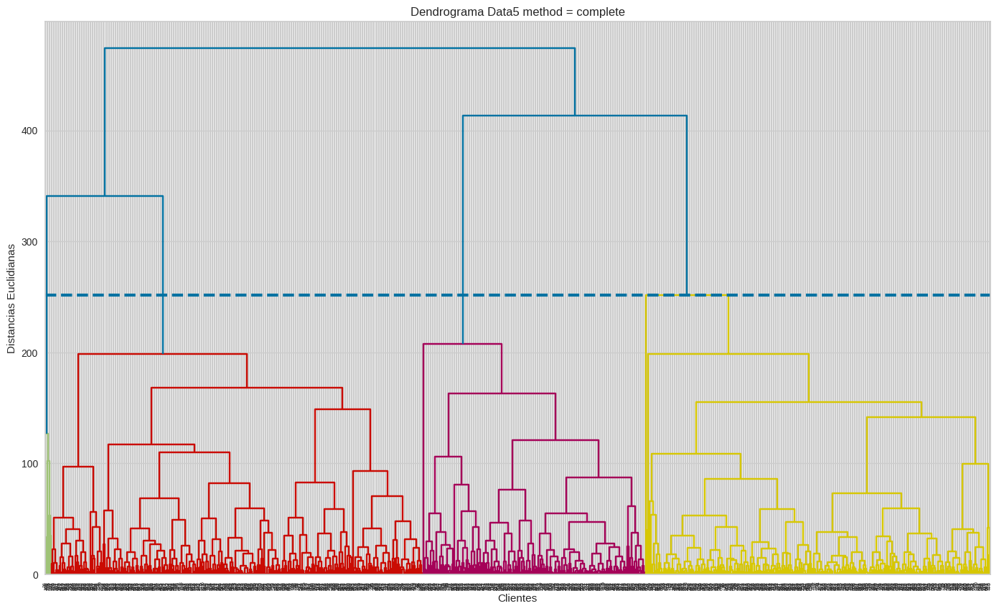

111.86786493161115


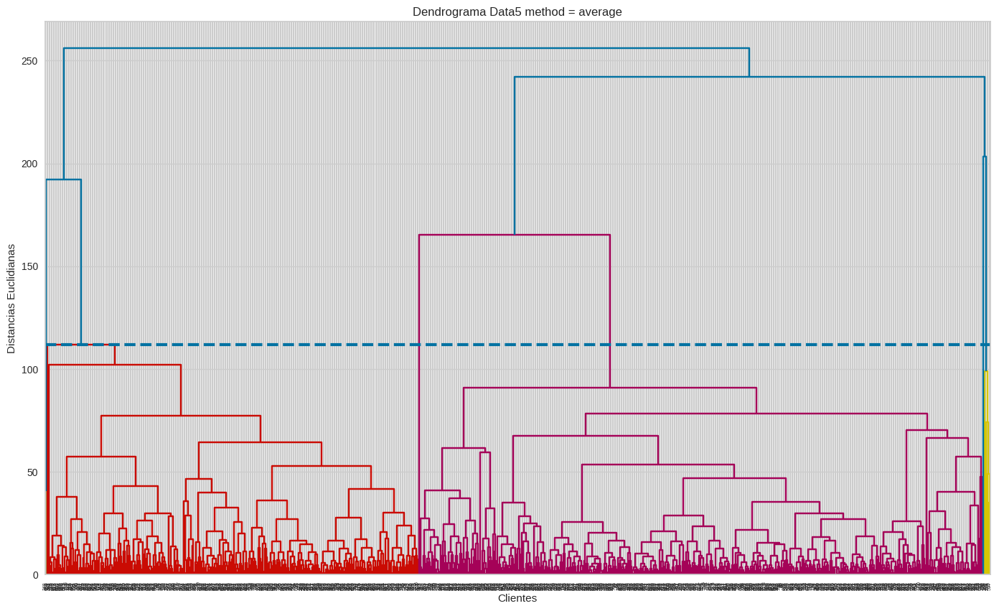

220.6555015380585


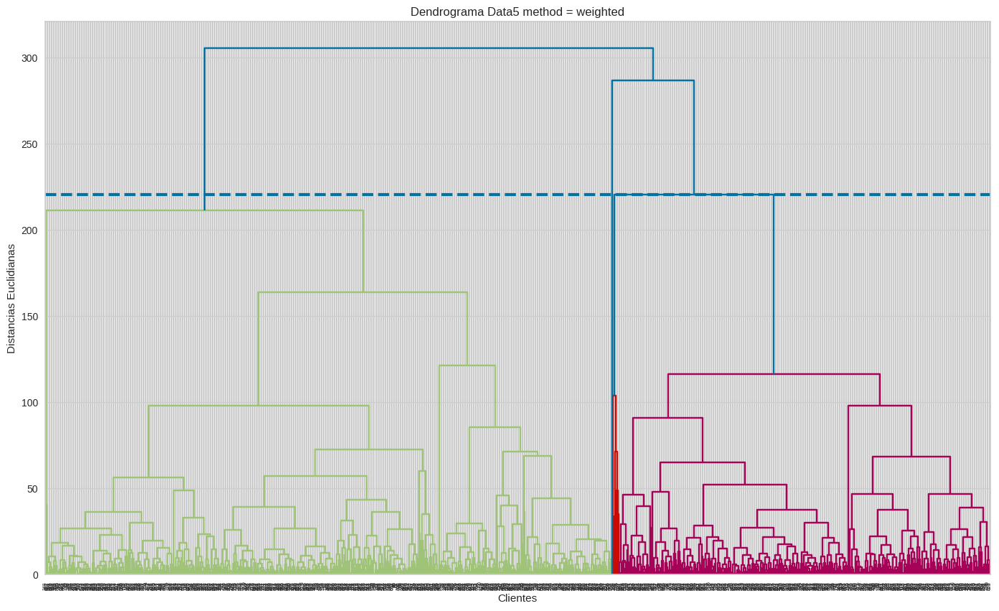

112.72090193123786


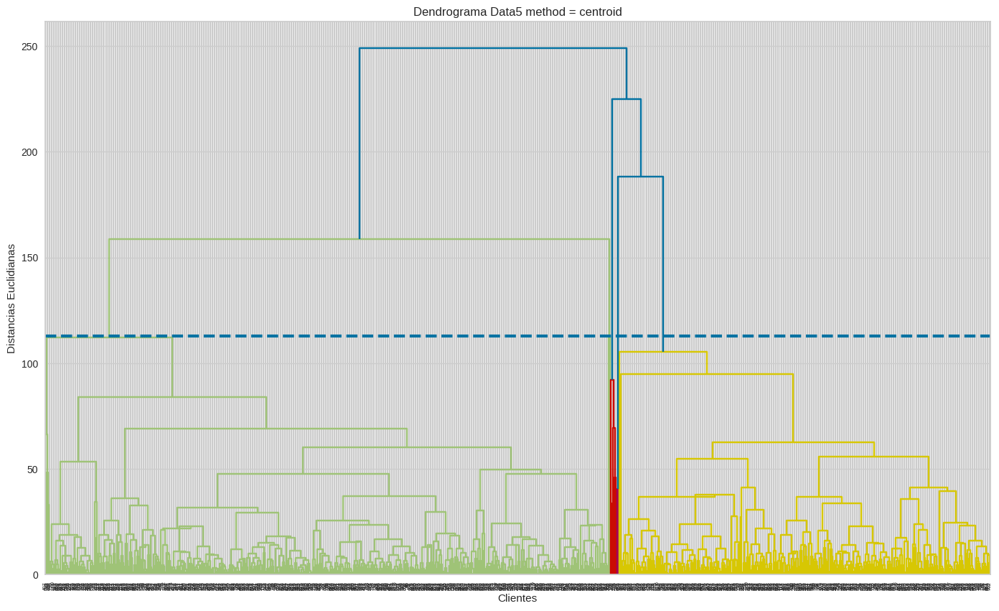

105.38022691193488


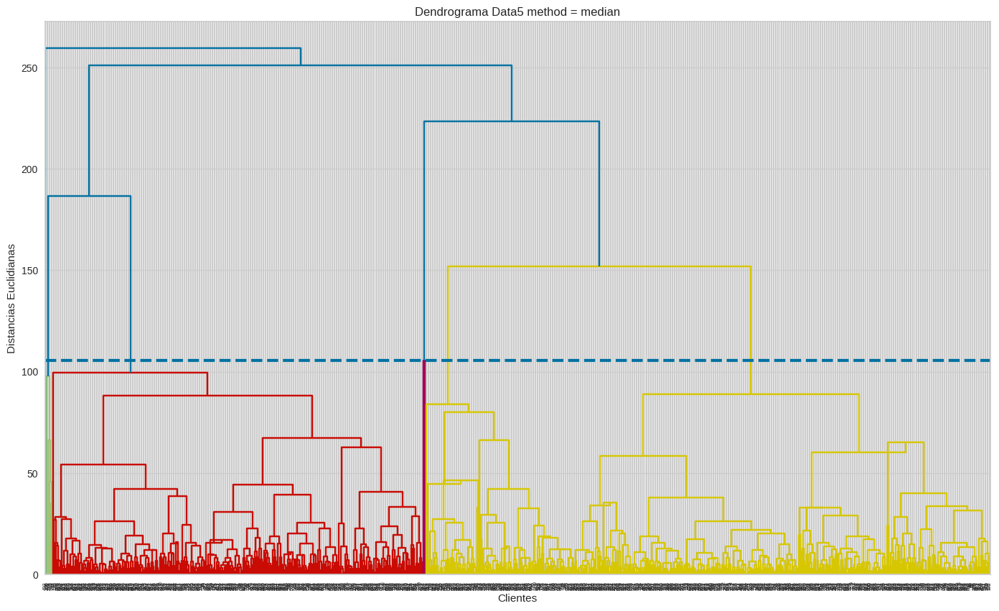

1104.973317445235


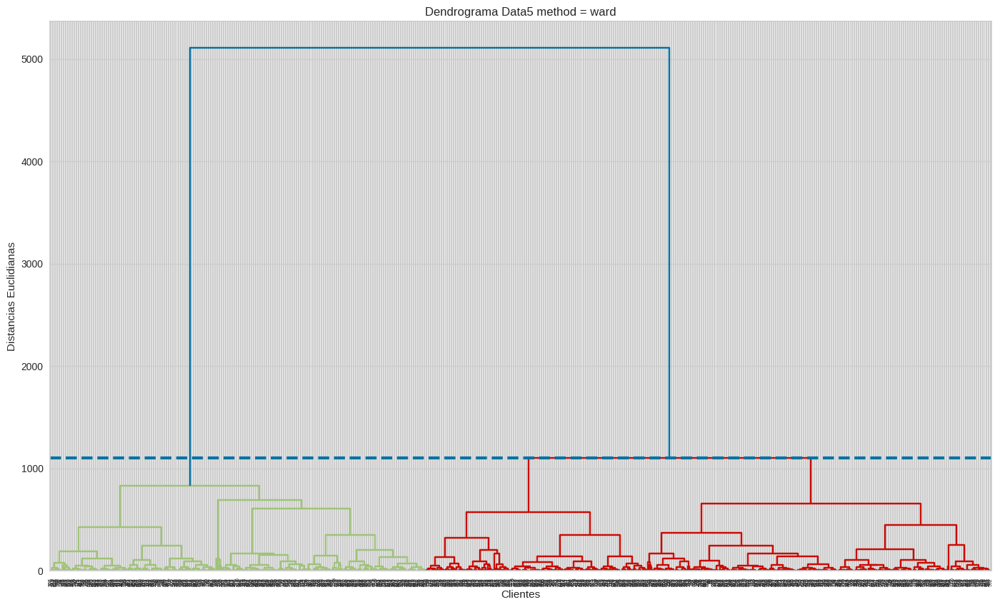

5.460570171268954


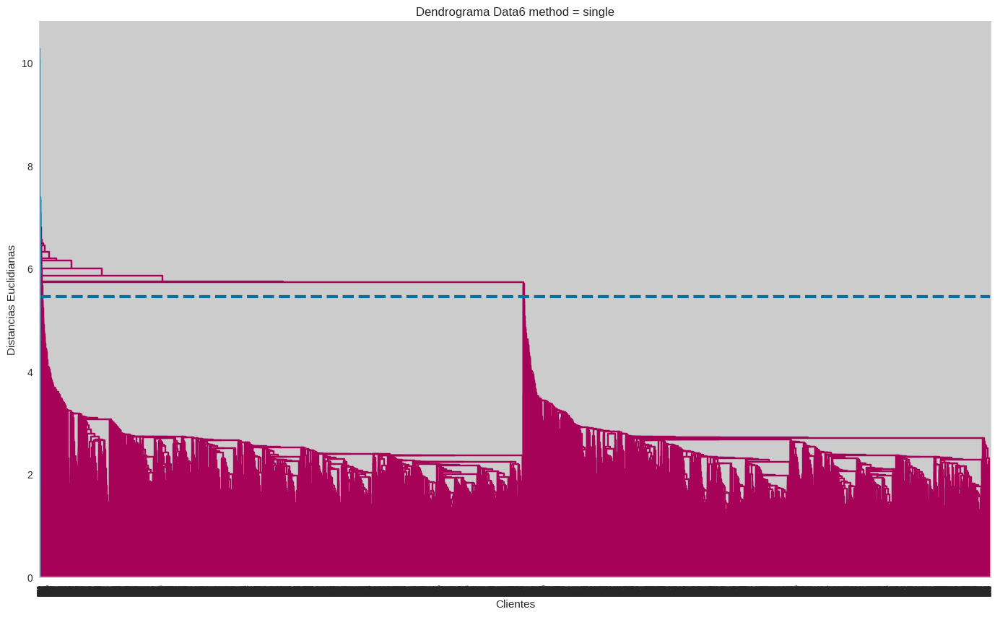

133.5697994954506


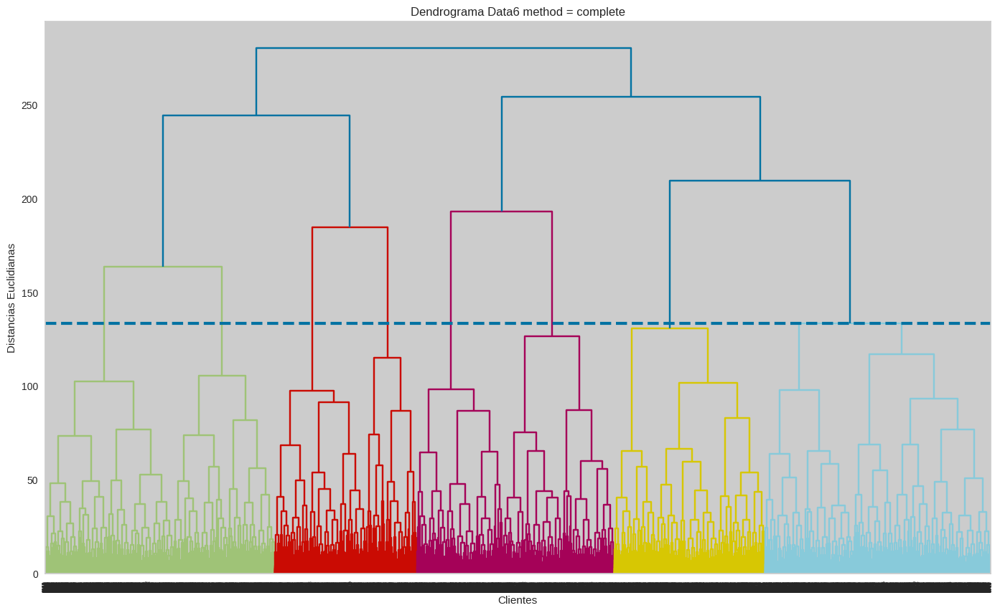

64.18002095124058


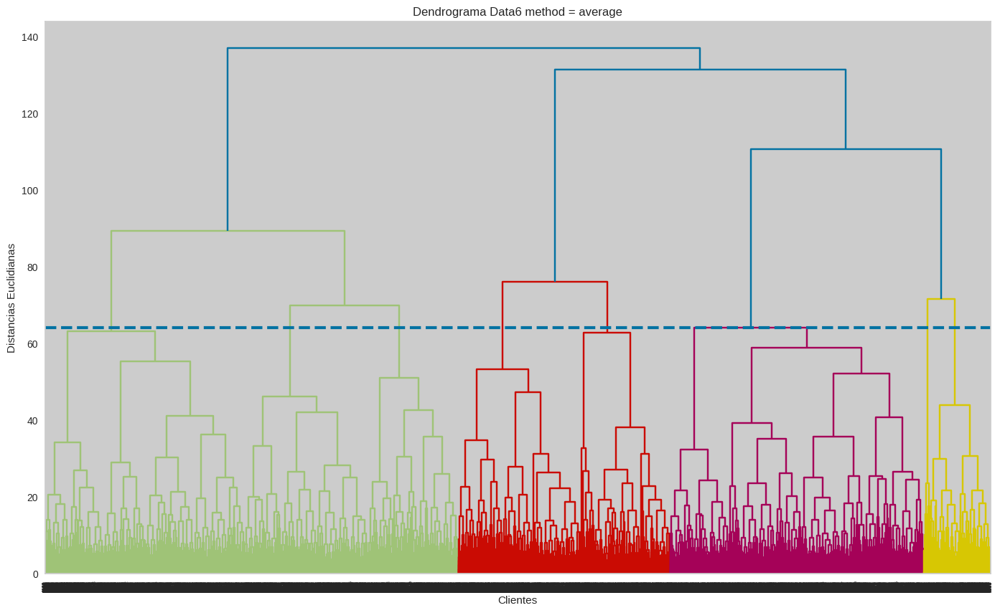

49.31097476433927


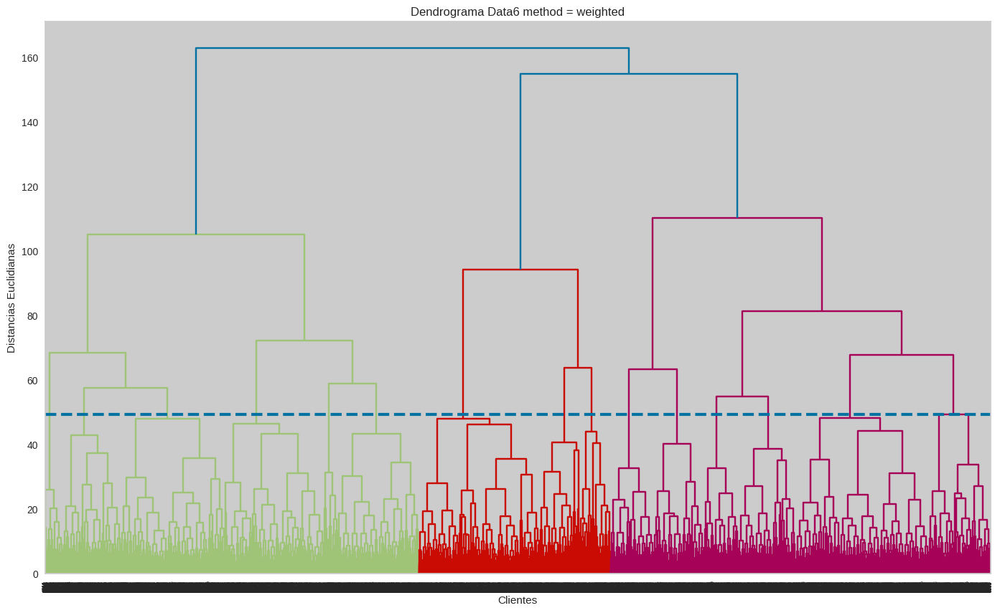

39.205322355523


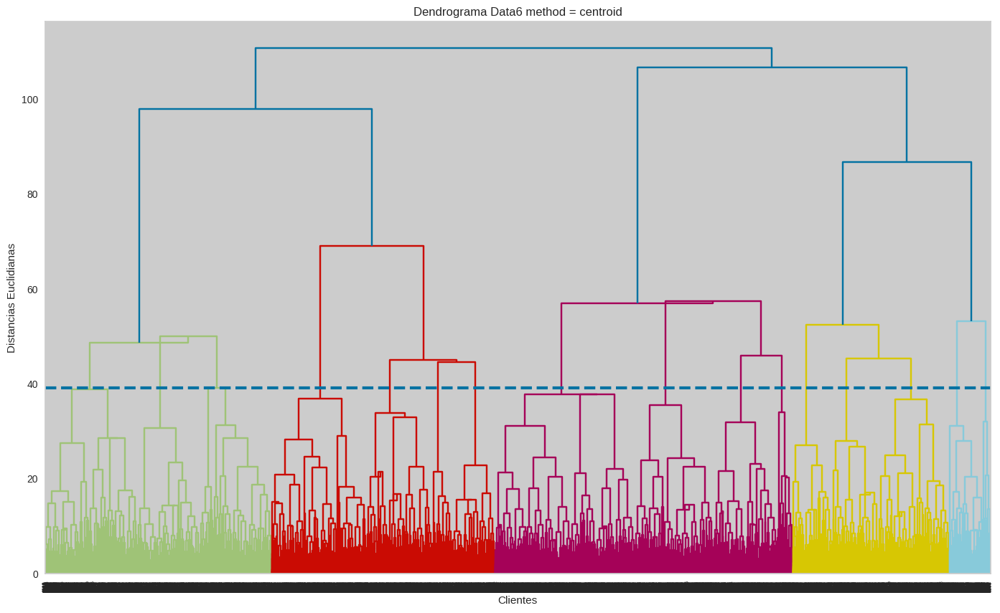

61.853054607916114


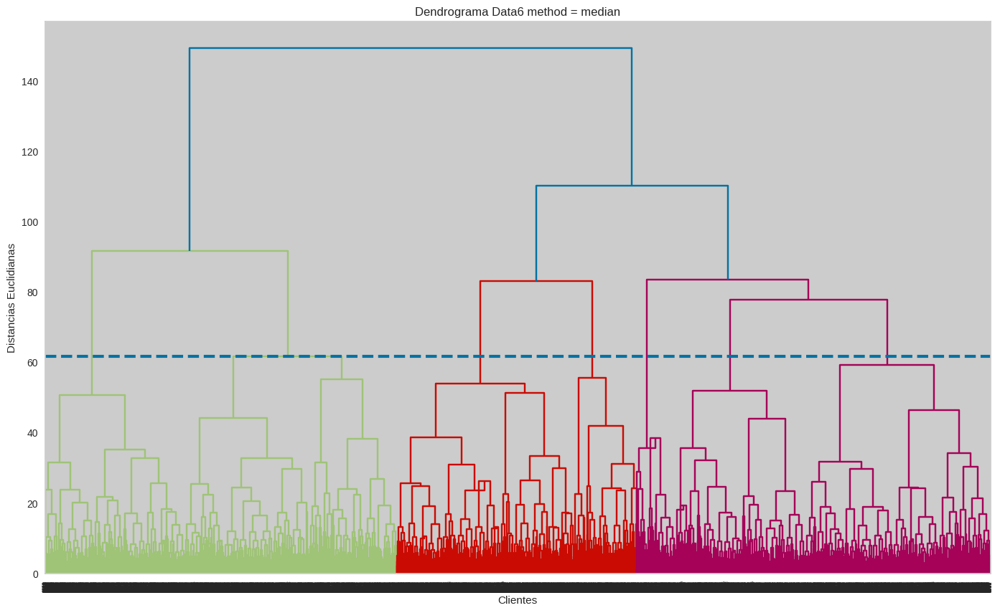

1462.2354630063257


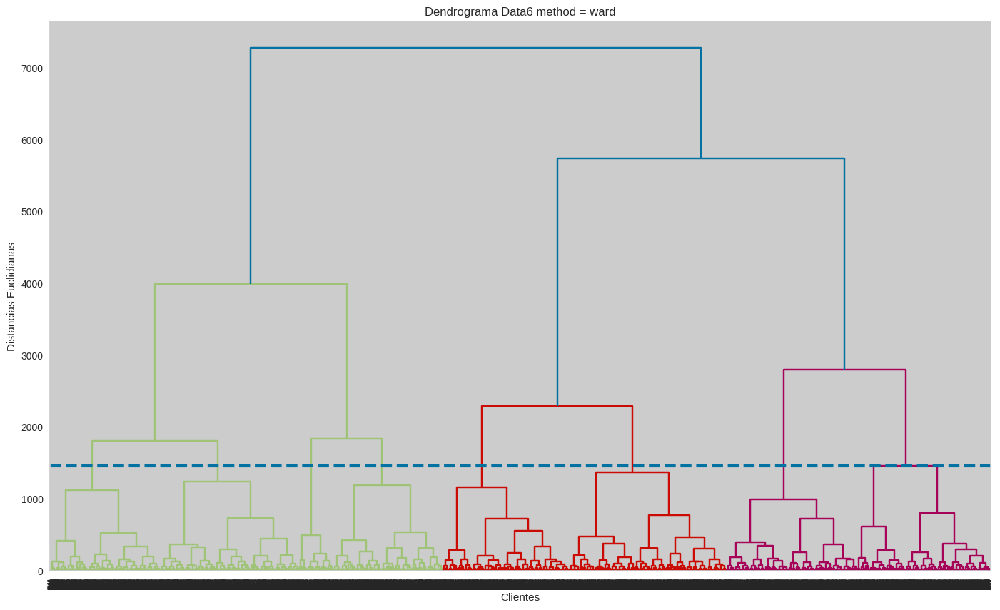

In [42]:
methods=['single','complete','average','weighted','centroid','median','ward']
data_with_n_clusters={}    
for i,data in datos.items():
    k_for_data={}
    for method in methods:
        n_cluster=dendrograma(data,i,method)
        k_for_data[method]=n_cluster
    data_with_n_clusters[i]=k_for_data

In [43]:
print(data_with_n_clusters)

{0: {'single': 3, 'complete': 3, 'average': 6, 'weighted': 4, 'centroid': 2, 'median': 4, 'ward': 3}, 1: {'single': 6, 'complete': 8, 'average': 7, 'weighted': 4, 'centroid': 6, 'median': 6, 'ward': 4}, 2: {'single': 29, 'complete': 21, 'average': 17, 'weighted': 52, 'centroid': 18, 'median': 25, 'ward': 17}, 3: {'single': 10, 'complete': 8, 'average': 10, 'weighted': 9, 'centroid': 13, 'median': 10, 'ward': 9}, 4: {'single': 5, 'complete': 4, 'average': 6, 'weighted': 3, 'centroid': 5, 'median': 6, 'ward': 2}, 5: {'single': 25, 'complete': 8, 'average': 8, 'weighted': 15, 'centroid': 16, 'median': 7, 'ward': 8}}


single 3


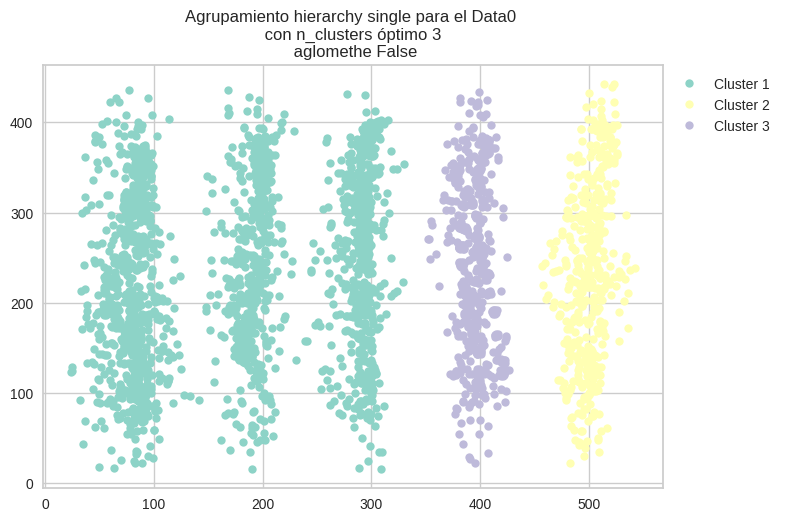

complete 3


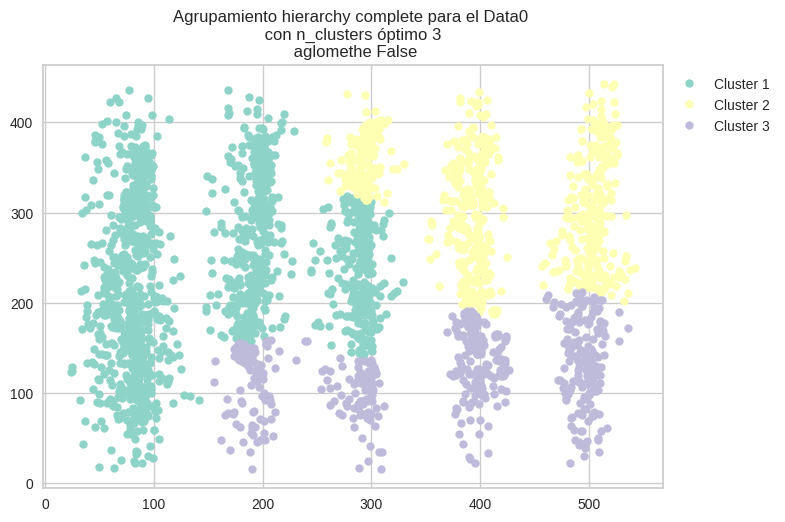

average 6


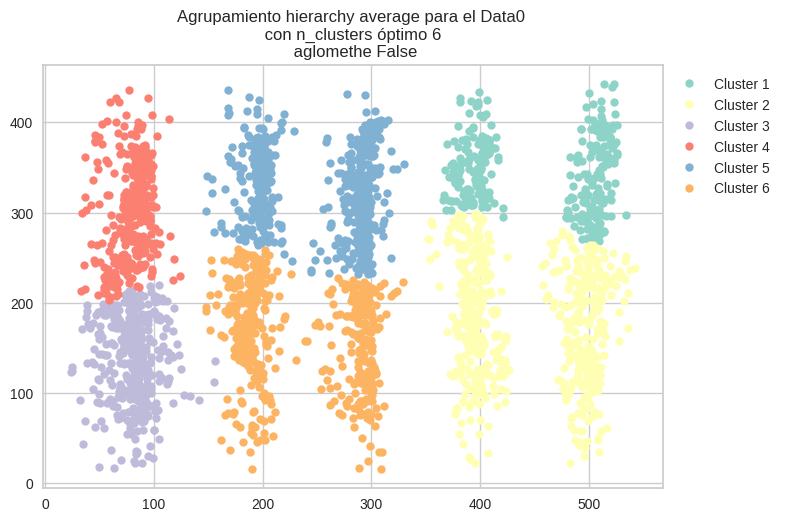

weighted 4


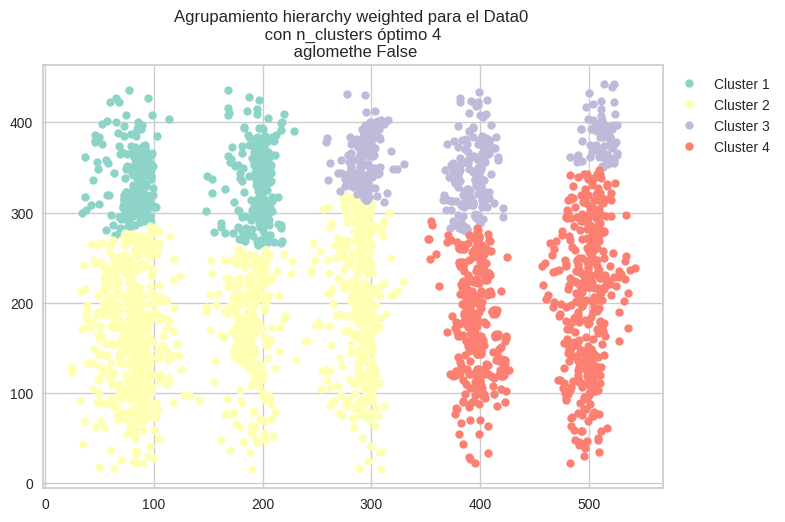

centroid 2


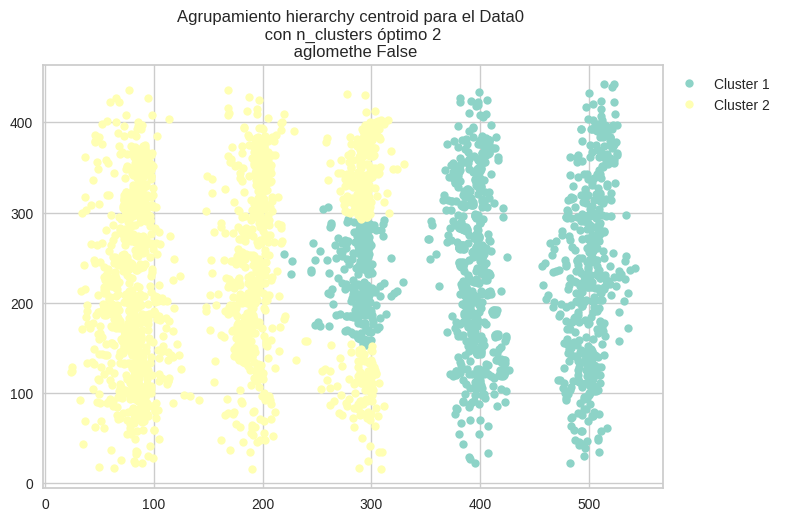

median 4


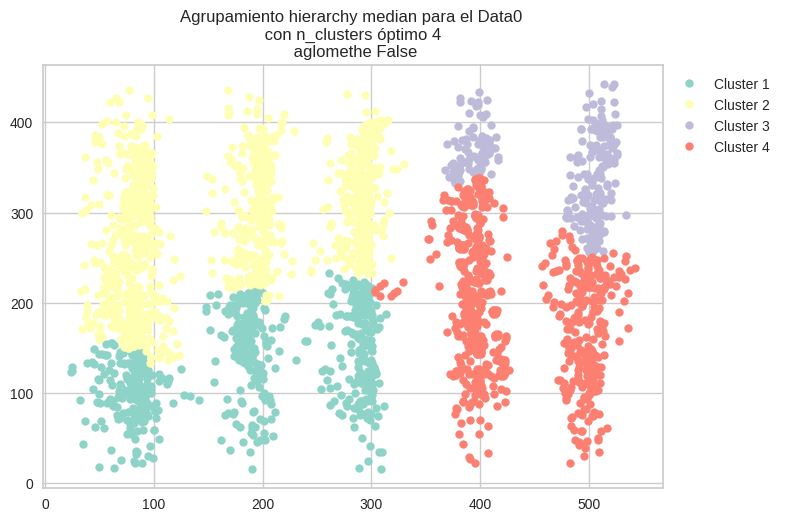

ward 3


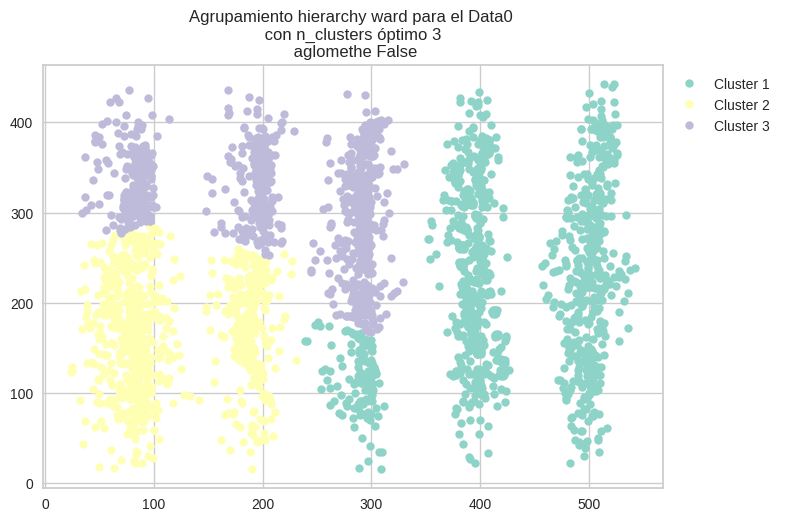

single 6


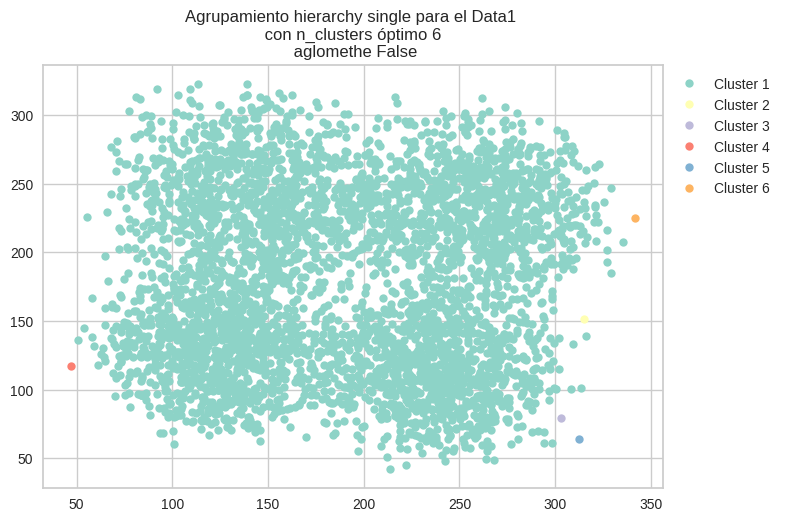

complete 8


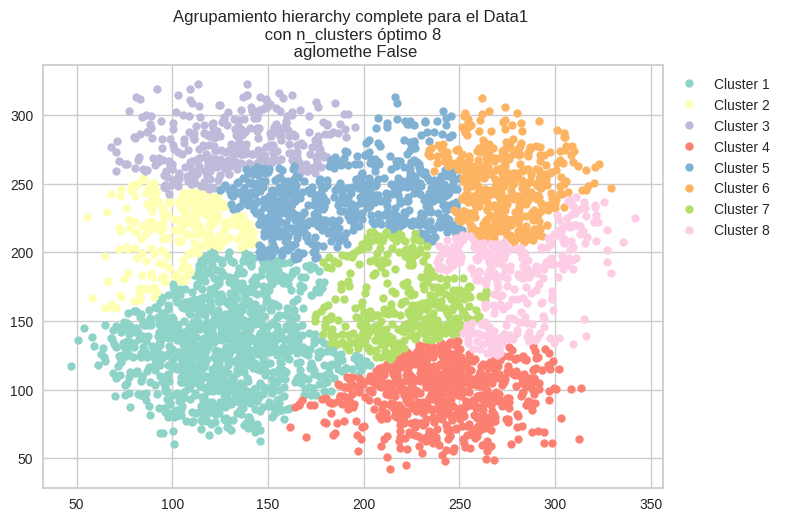

average 7


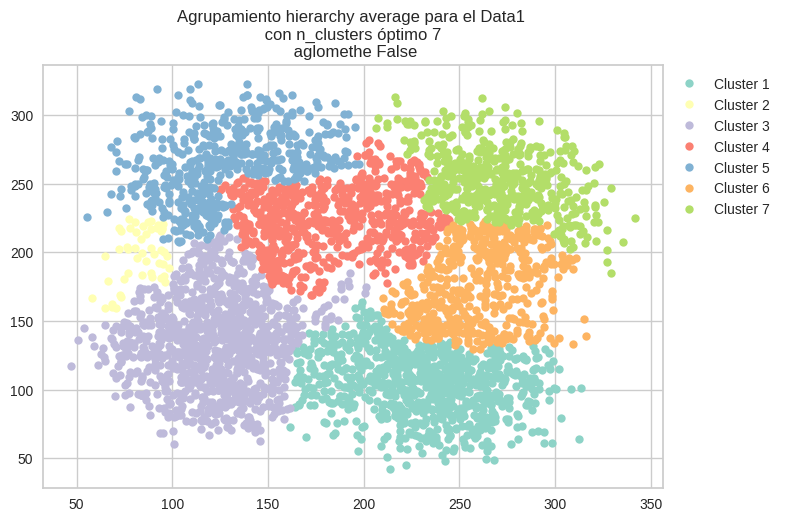

weighted 4


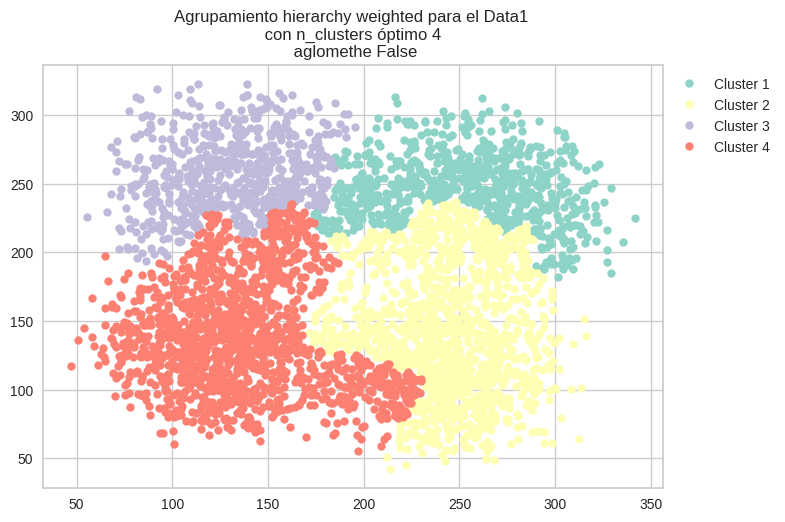

centroid 6


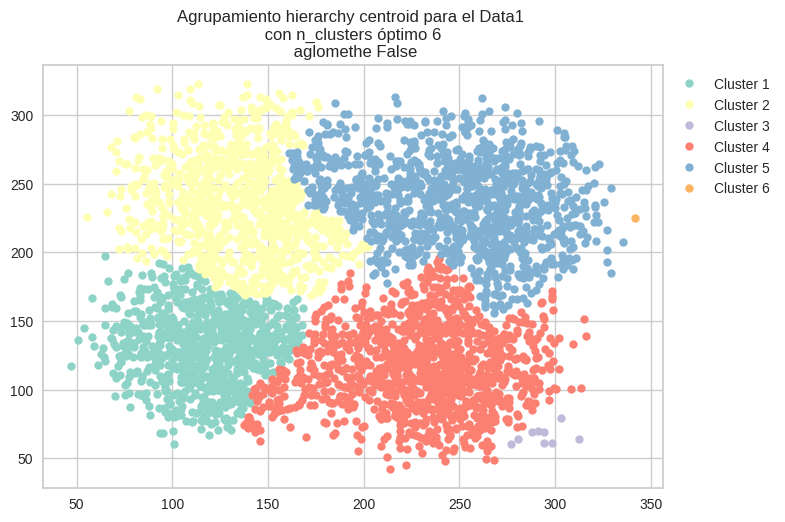

median 6


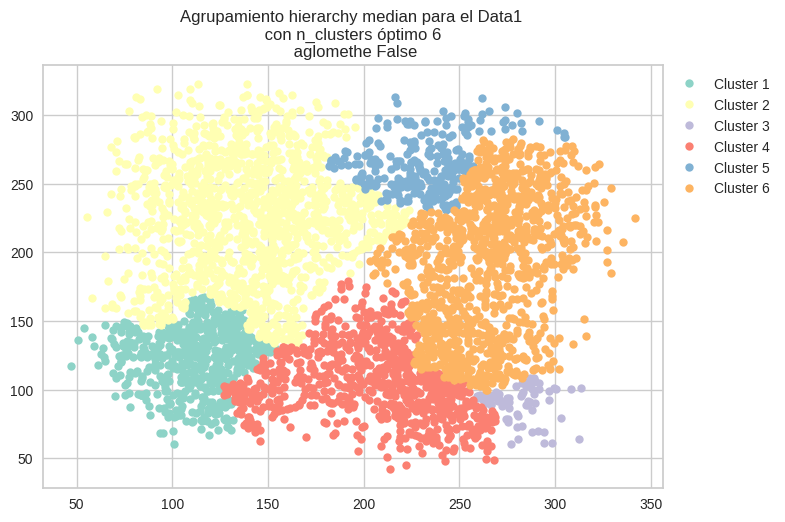

ward 4


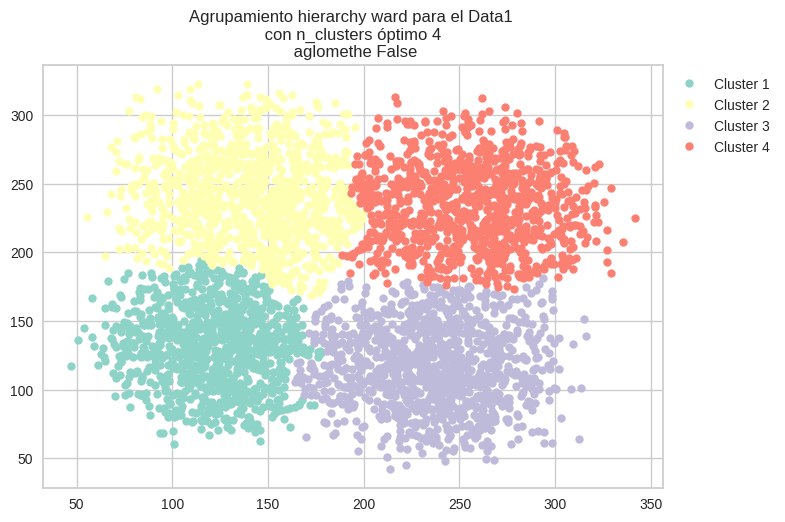

single 29


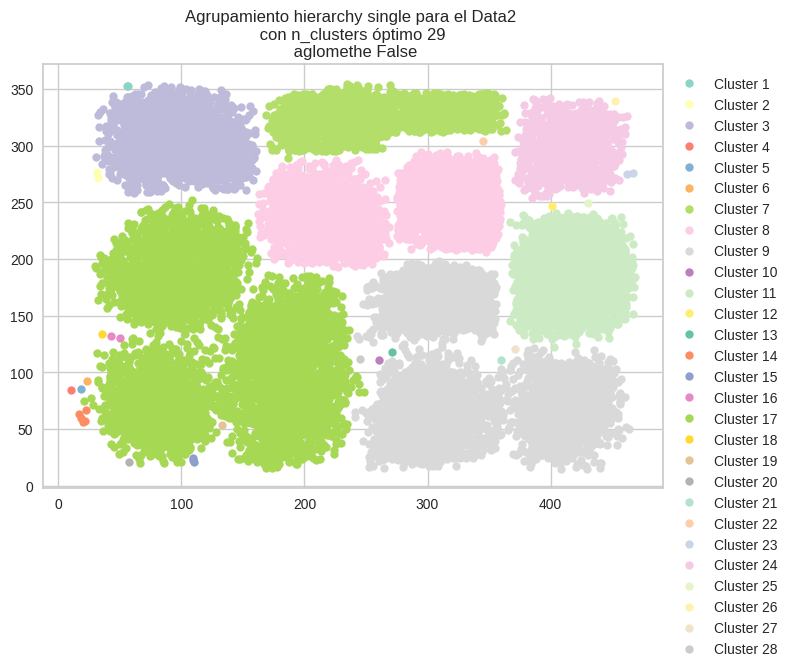

complete 21


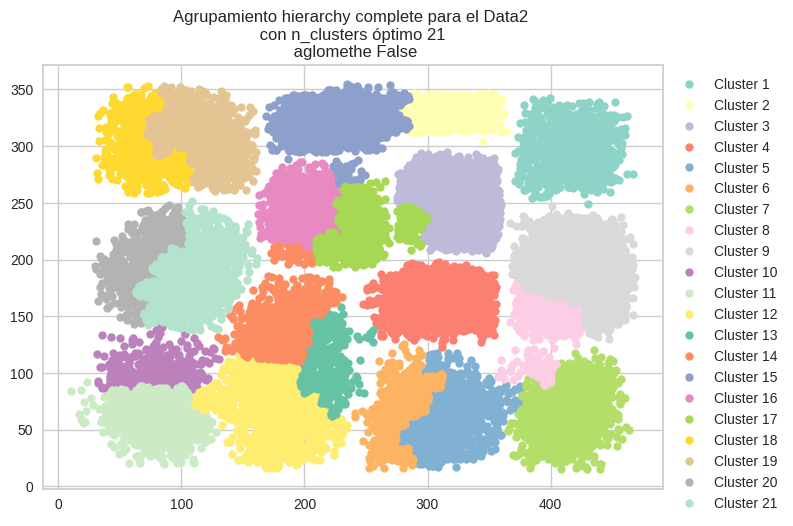

average 17


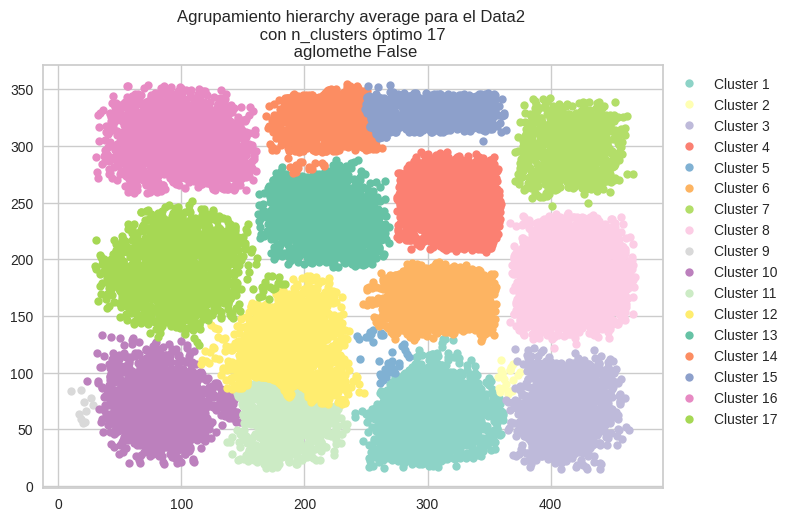

weighted 52


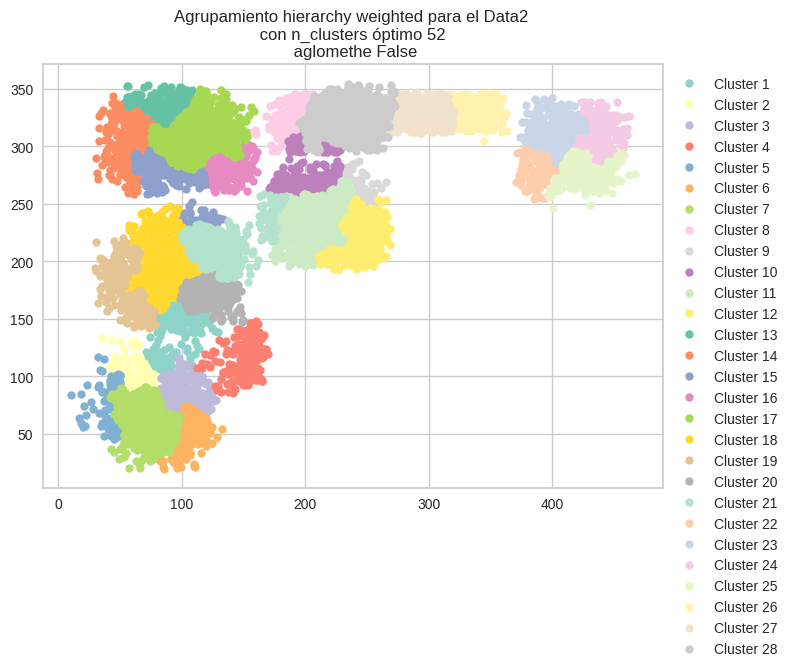

centroid 18


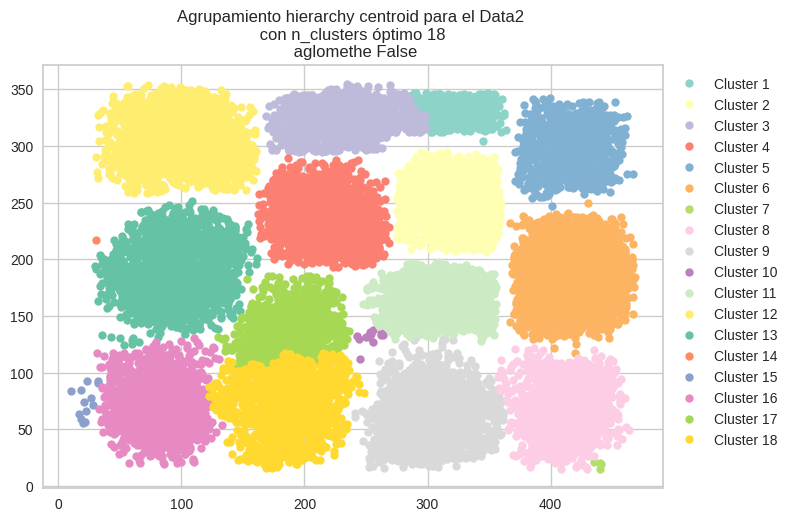

median 25


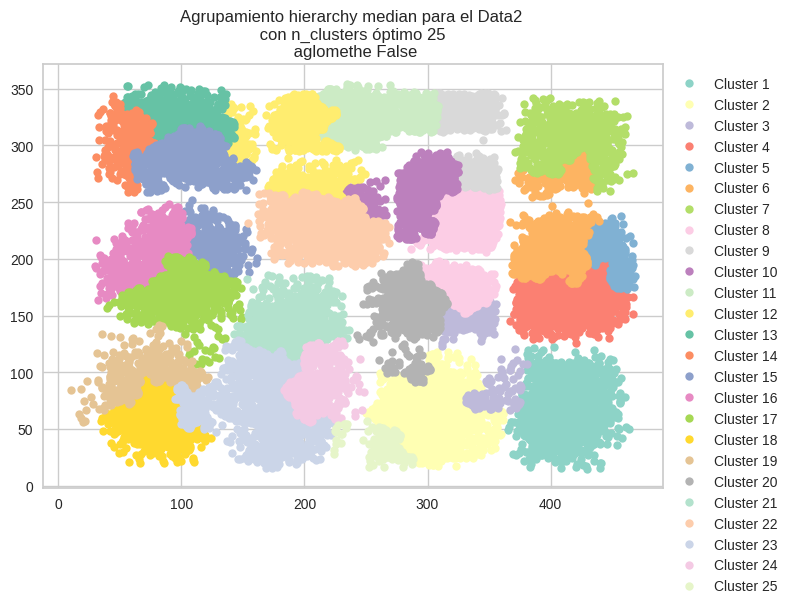

ward 17


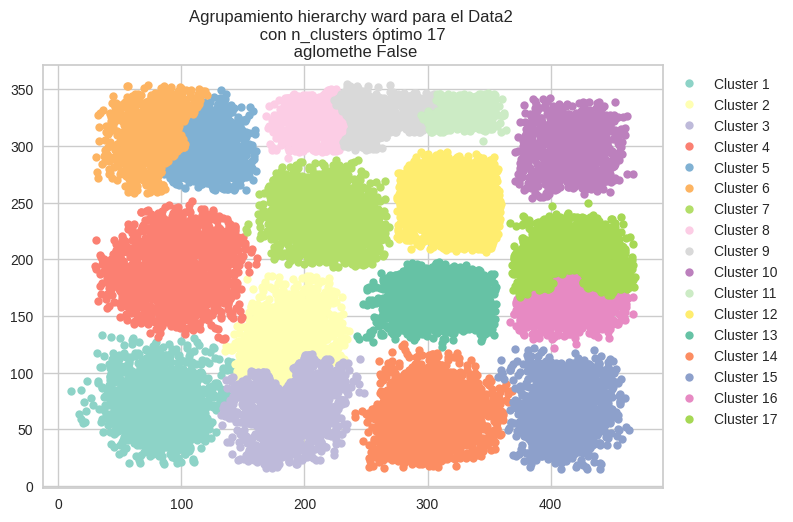

single 10


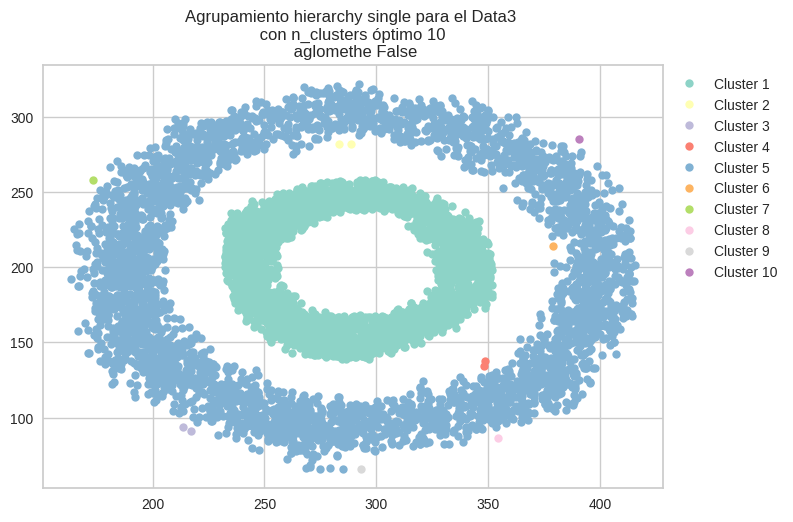

complete 8


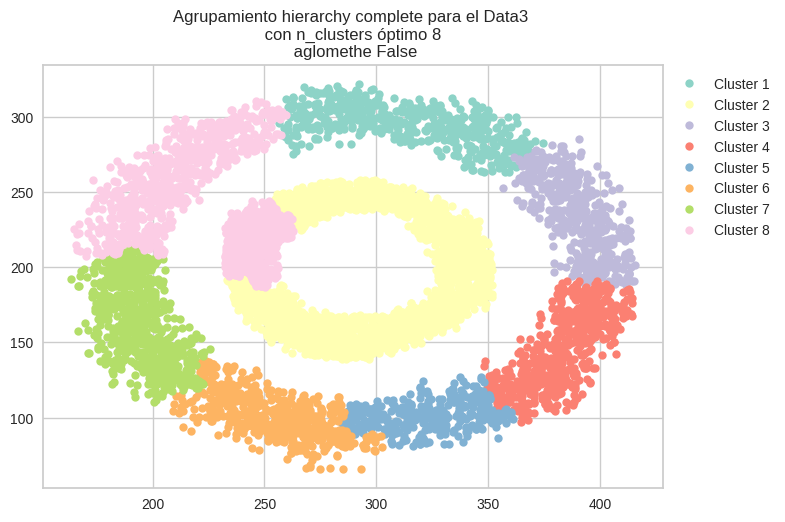

average 10


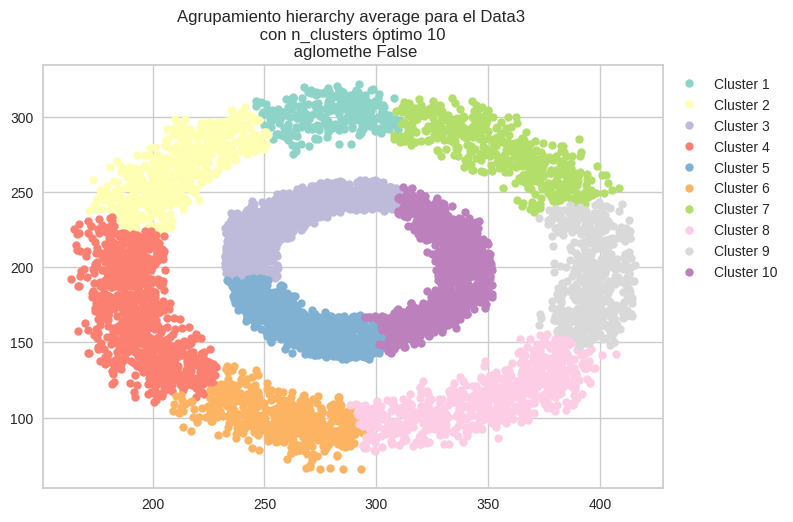

weighted 9


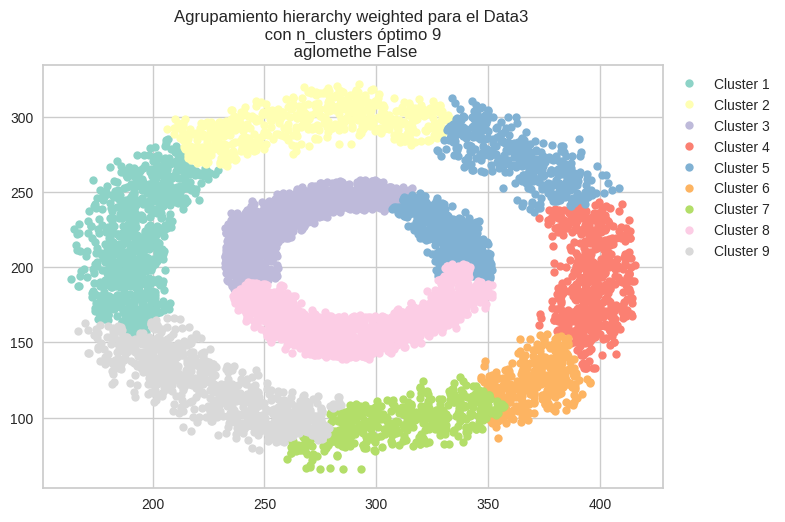

centroid 13


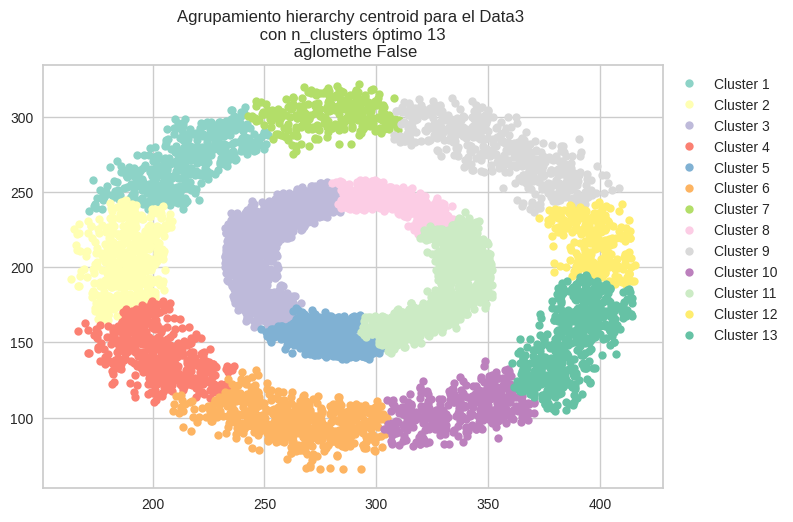

median 10


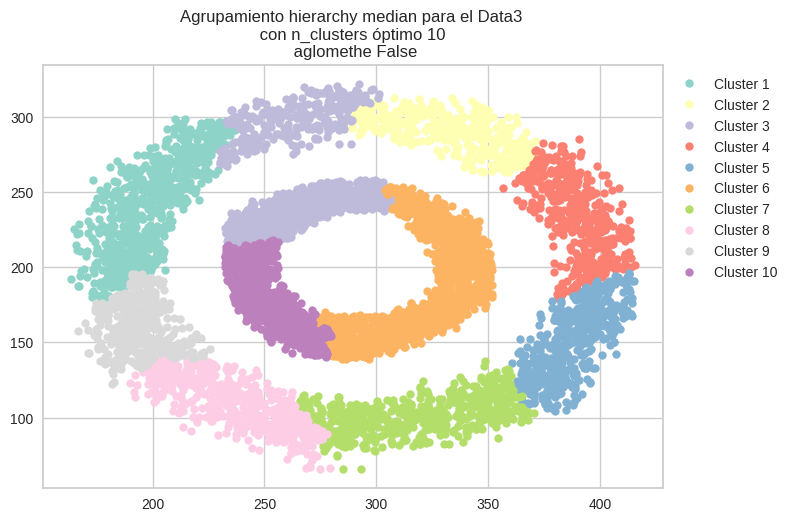

ward 9


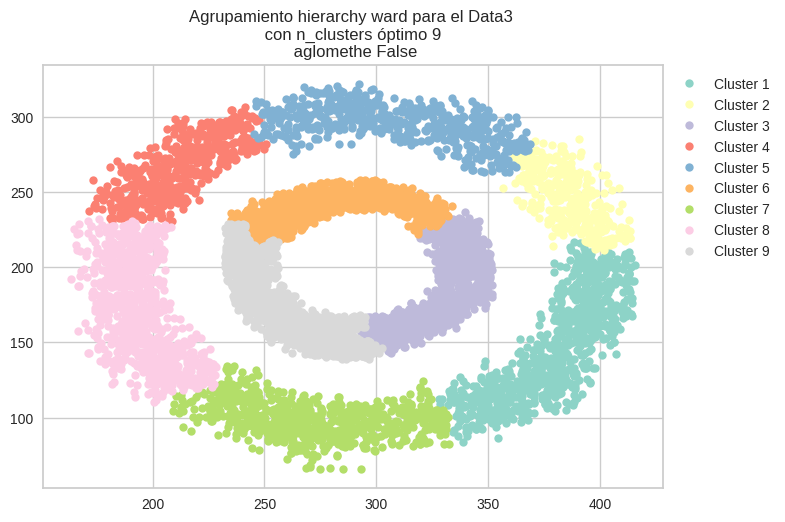

single 5


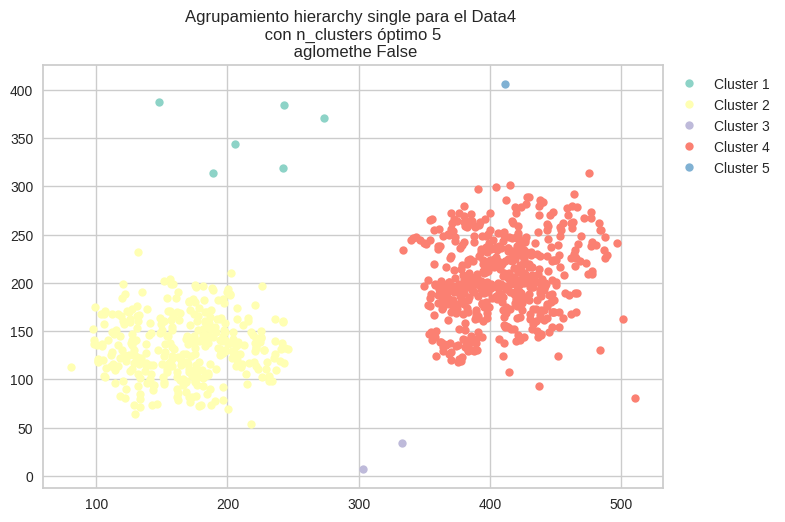

complete 4


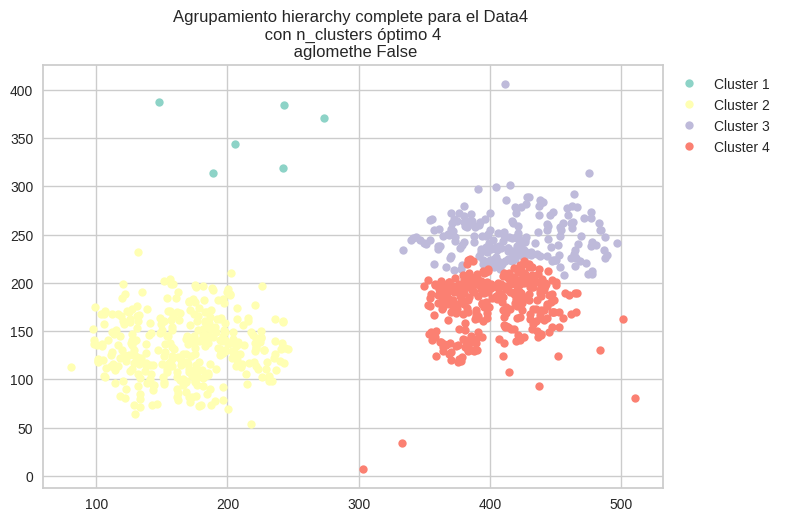

average 6


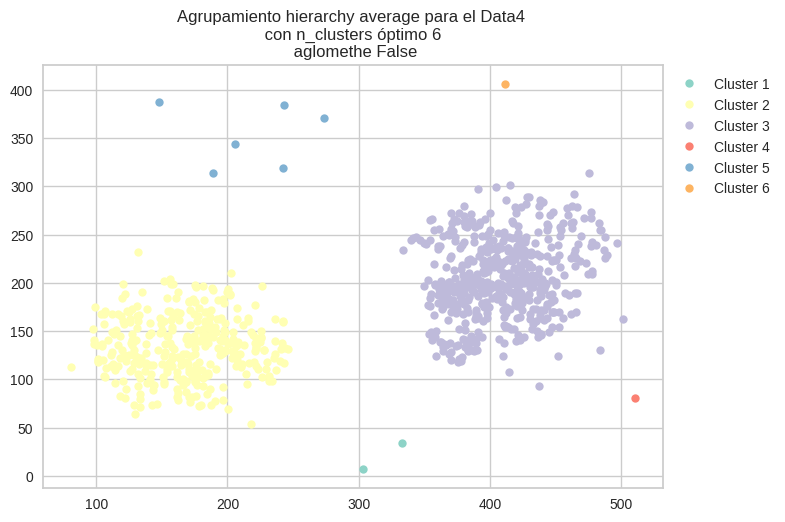

weighted 3


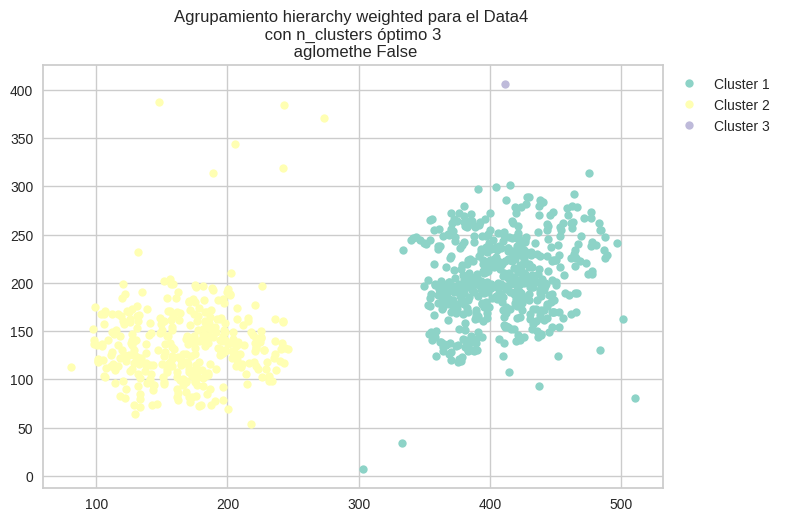

centroid 5


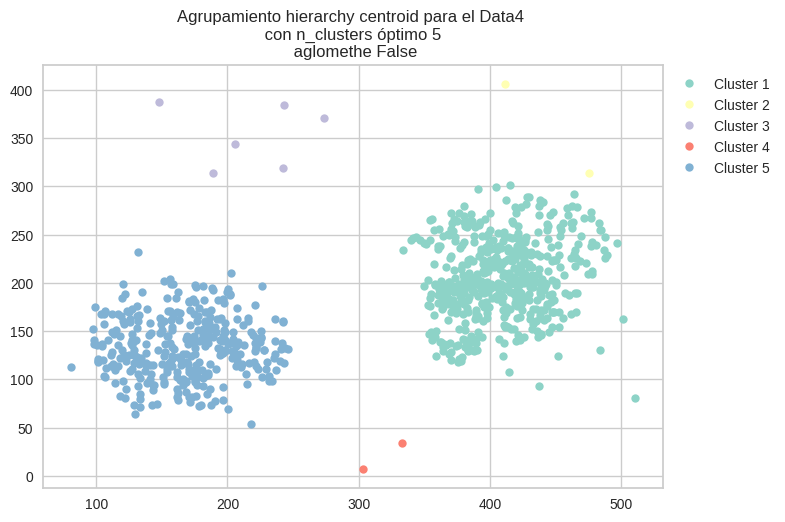

median 6


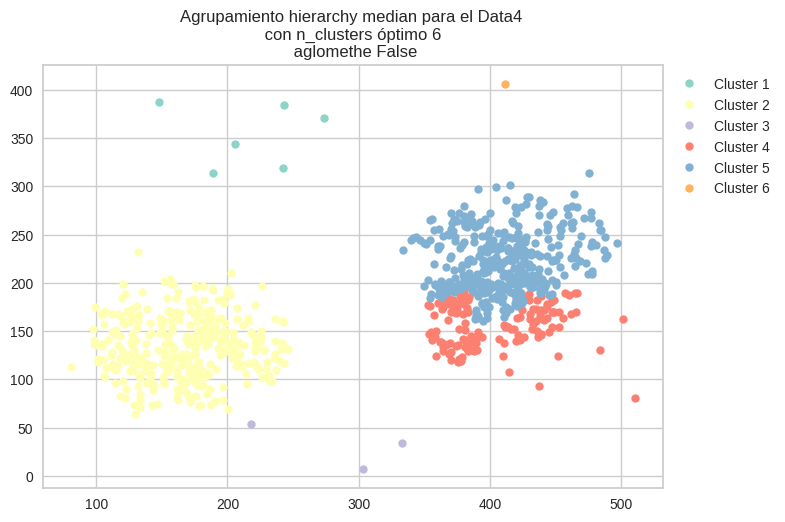

ward 2


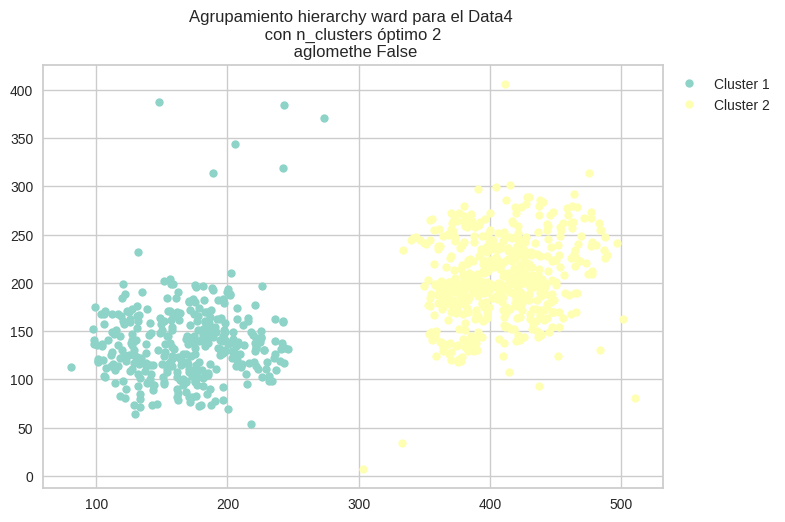

single 25


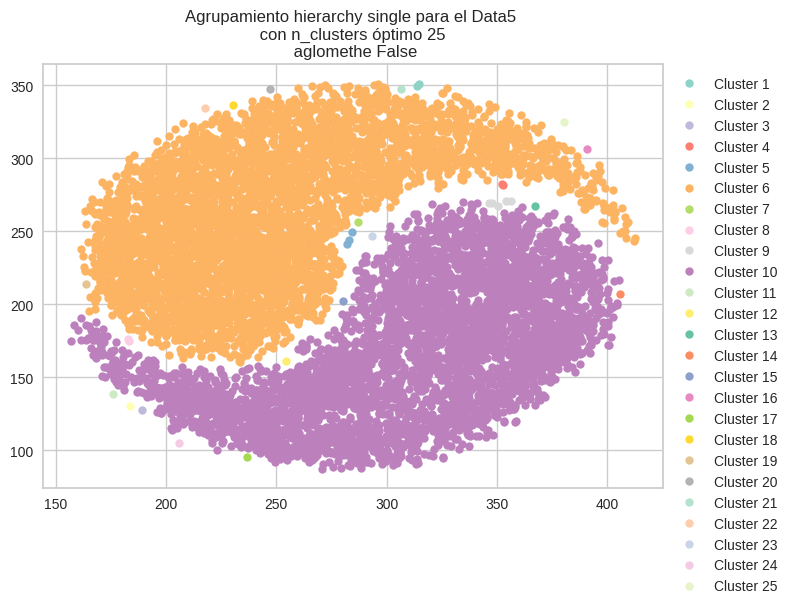

complete 8


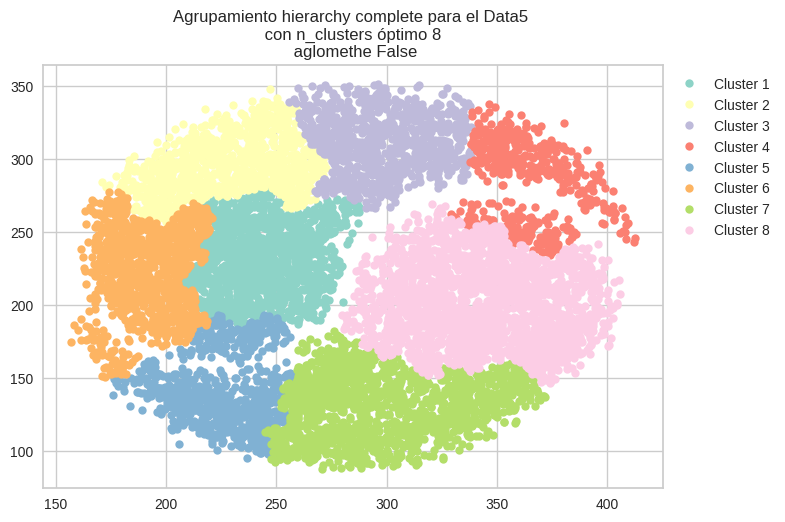

average 8


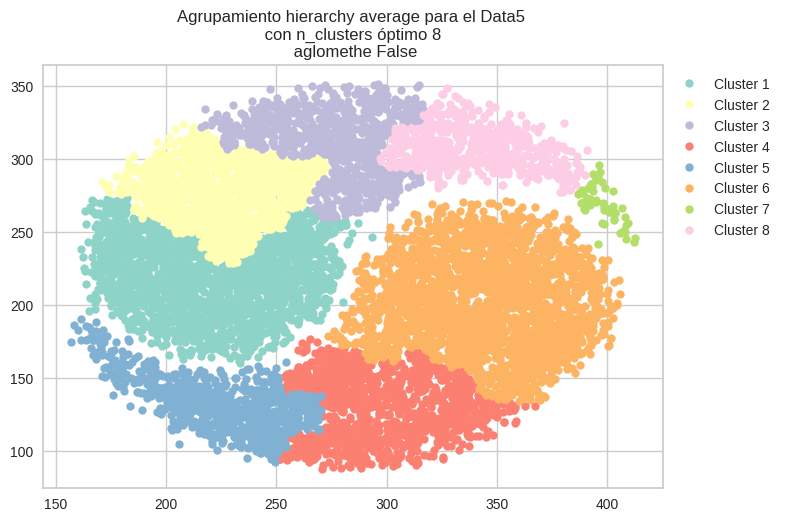

weighted 15


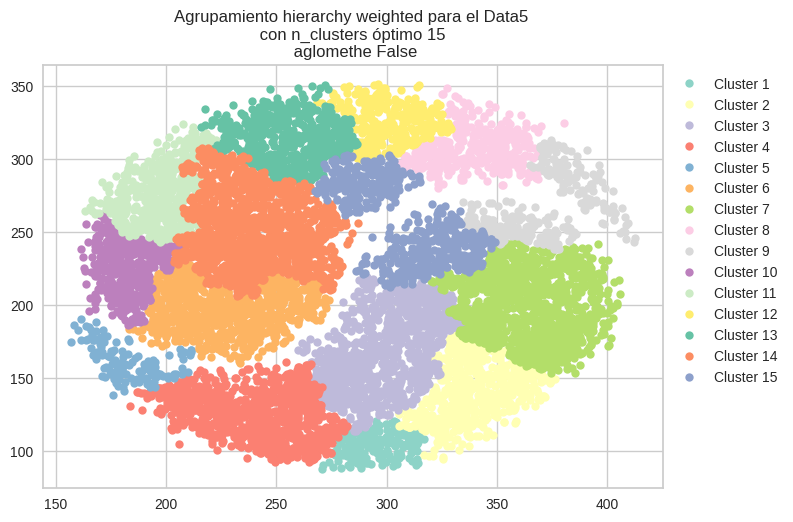

centroid 16


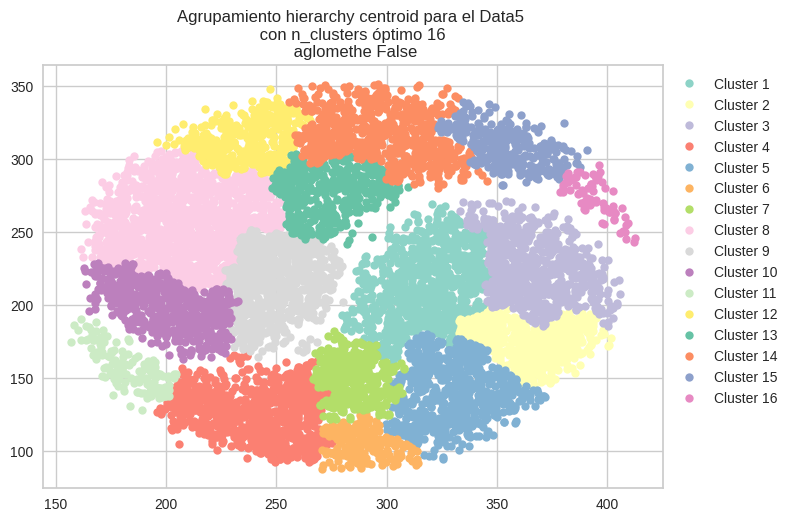

median 7


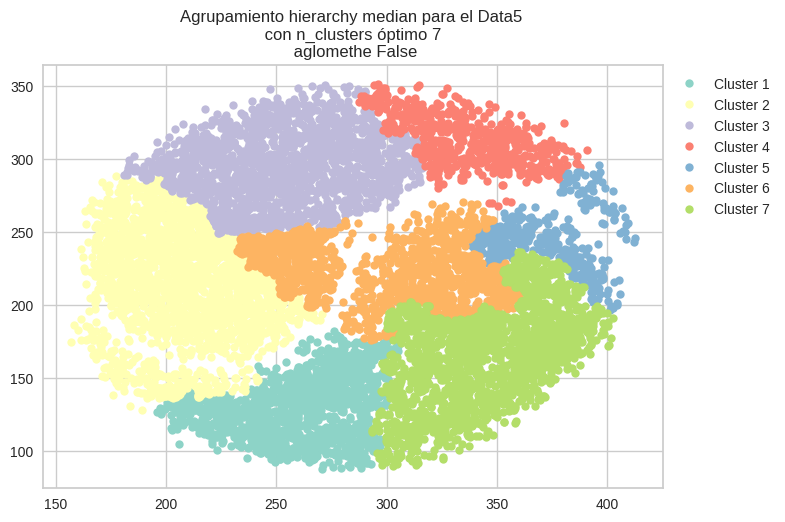

ward 8


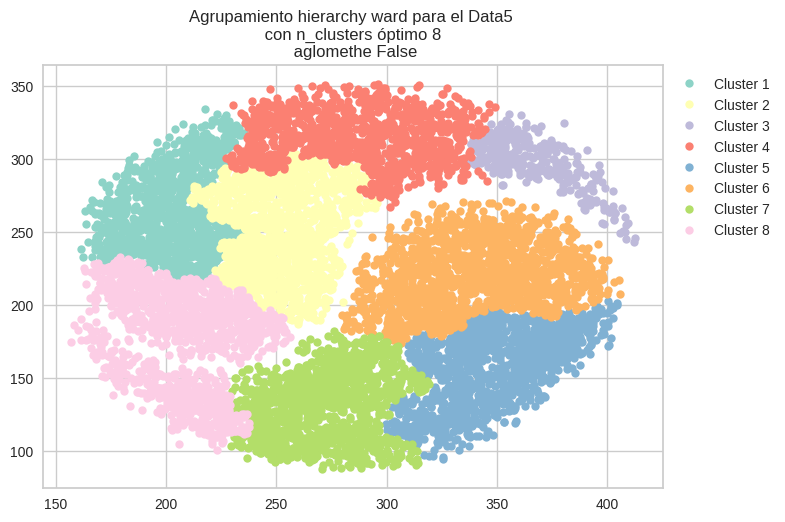

In [44]:
for i,data in datos.items():
    plot_all_strategy_hierarchy(data.copy(), i, method=data_with_n_clusters[i])

Ahora pasaremos a comentar para cada dataset los resultados:
- Opción 1: valor de n_clusters igual al valor real de clústeres.
- Opción 2: valor de n_clusters obtenido a través del dendograma.
- Opción 3: valor de n_clusters obtenido con el método de silhouette.

- Dataset 1:
    * Opción 1: si establecemos n_clusteres a 5, vemos que la forma de los grupos se diferencia completamente de la real dando a entender que el agrupamiento jerárquico no es adecuado para este dataset.
    * Opción 2: también se obtienen 5 grupos.
    * Opción 3: también se obtienen 5 grupos y 14. Para este último el funcionamiento es muy similar a KMeans.  

- Dataset 2:
    * Opción 1, 2 y 3: se ha seleccionado n_clusters = 4 en todos los casos. Los grupos resultantes son prácticamente idénticos a la realidad por lo que el método de agrupamiento jerárquico sí sería adecuado para datasets de este tipo.  

- Dataset 3:
    * Opción 1: con n_clusters = 12, exceptuando uno de los grupos, se obtienen grupos idénticos a la realidad. 
    * Opción 2: se obtiene también que  n_clusters = 12. 
    * Opción 3: se puede seleccionar el valor de n_clusters 4 y 12. Con 4 grupos se obtiene un agrupamiento bastante correcto ya que no se han mezclado en ningún momento los grupos reales en dos o más grupos que se han formado con n_clusters = 4. 

- Dataset 4:
    * Opción 1: con n_clusters = 2 la forma de los grupos discrepa totalmente con la realidad por lo que el método jerárquico no es adecuado para este tipo de datasets. 
    * Opción 2: con n_clusters = 3, tampoco varían mucho los resultados en comparación con el anterior. 
    * Opción 3: tampoco lo hacen para n_clusters = 10 y 18. 

- Dataset 5:
    * Opción 1: con n_clusters = 3 vemos como el agrupamiento jerárquico tampoco es el adecuado para este tipo de datasets ya que el tercer grupo se identifica dentro de uno de los grupos reales como consecuencia de la división jerárquica. 
    * Opción 2: con n_clusters = 2, los grupos son separables por lo que se podrían considerar grupos correctos pero no concuerda con la realidad que son 3 grupos. 
    * Opción 3: con silhpuette también se obtiene que n_clusters = 2.

- Dataset 6:
    * Opción 1: si establecemos n_clusters = 2, la forma de los clústeres difiere de la realidad 
    * Opción 2: se han seleccionado los valores 3 y 4 pero ninguno de ellos tiene en cuenta la forma real de los clústeres. 
    * Opción 3: se ha seleccionado el valor 3 al cual aplica la justificación anterior. 


# Conclusiones 

**KMeans**

- Fortalezas: KMeans es eficiente para datasets donde los clústeres son convexos y homogéneos en tamaño. Mostró buenos resultados en el Dataset 2, donde los grupos generados eran idénticos a los reales.
    
- Debilidades: Su rendimiento disminuye con clústeres de formas irregulares, tamaños y densidades variadas. Esto se observó en los Datasets 1, 3, 4, 5 y 6, donde no pudo replicar la estructura real de los grupos, especialmente cuando los clústeres reales eran no convexos o tenían tamaños muy dispares.

**KMedoids**

- Fortalezas: Similar a KMeans, pero con una ligera mejora en la robustez frente a outliers. Mostró resultados comparables a KMeans y fue capaz de generar agrupamientos correctos en el Dataset 2.
    
- Debilidades: Comparte limitaciones con KMeans en cuanto a la forma y tamaño de los clústeres. Además, es computacionalmente más costoso que KMeans, lo que lo hace menos preferible cuando ambos algoritmos ofrecen resultados similares.

**DBSCAN**

- Fortalezas: Excelente para detectar clústeres de formas arbitrarias y manejar outliers. DBSCAN mostró una notable capacidad para replicar la estructura de los clústeres reales en varios datasets, especialmente en aquellos donde los clústeres eran no convexos o tenían formas irregulares (ej., Datasets 1 y 3).

- Debilidades: La elección de los parámetros eps y min_samples puede ser desafiante y crítica para el rendimiento del algoritmo. No funcionó bien en el Dataset 2, donde no pudo identificar la cantidad correcta de clústeres.

**Agrupamiento Jerárquico**

- Fortalezas: Proporciona una representación visual intuitiva mediante dendrogramas, lo que facilita la elección del número de clústeres. Mostró buenos resultados en el Dataset 2, generando grupos prácticamente idénticos a los reales.

- Debilidades: Puede ser ineficaz para datasets grandes debido a su complejidad computacional. Además, al igual que KMeans y KMedoids, lucha con clústeres de formas complejas y tamaños muy variados, como se observó en los Datasets 4, 5 y 6.

Conclusión

La elección del método de clustering más adecuado depende en gran medida de la naturaleza de los datos. Mientras que KMeans y KMedoids pueden ser preferibles por su eficiencia en clústeres homogéneos y convexos, DBSCAN se destaca en la identificación de clústeres de formas irregulares y es robusto ante outliers. El agrupamiento jerárquico, aunque menos eficiente para grandes datasets, proporciona herramientas útiles para la interpretación visual del proceso de agrupamiento. En resumen, la complejidad de los datasets y la presencia de clústeres no convexos o de tamaños variados favorecen el uso de DBSCAN sobre los otros métodos.

## Notas profesor
Idea cargar datos hacer fitting y ver que os da y comparar con los resultar ver como se aproxima el clustering a los graficaos que muestra delante conjuntos de datos k melodies , y practicamente llegar a vuestras conclusiones.
